#Data preparation

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

import warnings
warnings.filterwarnings("ignore")
pd.set_option("display.max_columns",None)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Importing the 'curtailment_data_2020' dataset from an Excel file
# Using the 'Curtailments' sheet to load curtailment data
curtailment_data_2020 = pd.read_excel(r"/content/drive/Shareddrives/DATA606 capstone project/productionandcurtailmentsdata_2020.xlsx", sheet_name="Curtailments")
# Converting all column names to lowercase for consistency and easier referencing
curtailment_data_2020.columns = [feature.lower() for feature in curtailment_data_2020.columns]

# Importing the 'production_data_2020' dataset from the same Excel file
# Using the 'Production' sheet to load production data
production_data_2020 = pd.read_excel(r"/content/drive/Shareddrives/DATA606 capstone project/productionandcurtailmentsdata_2020.xlsx", sheet_name="Production")
# Converting all column names to lowercase for consistency and easier referencing
production_data_2020.columns = [feature.lower() for feature in production_data_2020.columns]


In [ ]:

curtailment_data_2020.head()

,date,hour,interval,wind curtailment,solar curtailment
0,2020-01-01,9,5,NaN,1.960000
1,2020-01-01,9,6,NaN,10.430918
2,2020-01-01,9,10,NaN,1.295686
3,2020-01-01,9,11,40.030000,153.010799
4,2020-01-01,9,12,26.946634,161.819285


In [ ]:
production_data_2020.head()

,date,hour,interval,load,solar,wind,net load,renewables,nuclear,large hydro,imports,generation,thermal,load less (generation+imports)
0,2020-01-01 00:00:00,1,1,22121.306042,0.0,290.128537,21831.177504,1684.108439,2272.914003,1454.382066,8523.626667,13598.950729,8187.546221,-1.271354
1,2020-01-01 00:05:00,1,2,22119.647656,0.0,285.203357,21834.444300,1658.931626,2273.301338,1357.157727,8385.320000,13726.372839,8436.982147,7.954818
2,2020-01-01 00:10:00,1,3,22056.574375,0.0,275.933807,21780.640568,1666.341899,2272.750655,1319.864573,8333.773333,13716.481484,8457.524358,6.319557
3,2020-01-01 00:15:00,1,4,21981.423021,0.0,275.207947,21706.215074,1664.394765,2273.263670,1331.500633,8333.493333,13638.609375,8369.450307,9.320312
4,2020-01-01 00:20:00,1,5,21901.401719,0.0,277.932034,21623.469684,1670.286625,2273.183646,1302.441129,8255.800000,13636.090573,8390.179172,9.511146


In [ ]:
production_data_2020.dtypes

,0
date,datetime64[ns]
hour,int64
interval,int64
load,float64
solar,float64
wind,float64
net load,float64
renewables,float64
nuclear,float64
large hydro,float64


In [ ]:
curtailment_data_2020.dtypes

,0
date,datetime64[ns]
hour,int64
interval,int64
wind curtailment,float64
solar curtailment,float64


In [ ]:

print("Shape of Curtailments Data",curtailment_data_2020.shape)

print("Shape of Production Data",production_data_2020.shape)

Shape of Curtailments Data (43903, 5)
Shape of Production Data (105408, 14)


In [ ]:
def merge_curtailment_production(curtailment, production):
    # Convert 'date' column to datetime and extract only the date part for both datasets
    curtailment["date"] = pd.to_datetime(curtailment["date"]).dt.date
    production["date"] = pd.to_datetime(production["date"]).dt.date

    # Convert 'hour' column to integer type to ensure consistency in data types before merging
    curtailment["hour"] = curtailment["hour"].astype(int)
    production["hour"] = production["hour"].astype(int)

    # Convert 'interval' column to integer type to ensure consistency in data types before merging
    curtailment["interval"] = curtailment["interval"].astype(int)
    production["interval"] = production["interval"].astype(int)

    # Merge the production and curtailment datasets on 'date', 'hour', and 'interval' with a left join
    final_data = production.merge(curtailment, on=["date", "hour", "interval"], how="left")

    # Print the shape of curtailment, production, and final merged datasets to verify merge
    print("Curtailment Data Shape : ", curtailment.shape)
    print("Production Data Shape : ", production.shape)
    print("Final Data Shape : ", final_data.shape, "\n")

    # Calculate and print the percentage of NaN values in the 'curtailment' dataset
    curtailment_nan_in_percentage = curtailment.isna().sum() / len(curtailment) * 100
    # Calculate and print the percentage of NaN values in the 'final_data' dataset
    final_nan_in_percentage = final_data.isna().sum() / len(final_data) * 100

    print("Curtailment NaN Percentage", curtailment_nan_in_percentage)
    print()
    print("Final NaN Percentage", final_nan_in_percentage)
    print("****" * 30)

    # Return the merged dataset
    return final_data


In [ ]:
final_data_2020 = merge_curtailment_production(curtailment_data_2020,production_data_2020)

Curtailment Data Shape :  (43903, 5)
Production Data Shape :  (105408, 14)
Final Data Shape :  (105408, 16) 

Curtailment NaN Percentage date                  0.000000
hour                  0.000000
interval              0.000000
wind curtailment     62.852197
solar curtailment     3.592010
dtype: float64

Final NaN Percentage date                               0.000000
hour                               0.000000
interval                           0.000000
load                               0.000000
solar                              0.000000
wind                               0.000000
net load                           0.000000
renewables                         0.000000
nuclear                            0.000000
large hydro                        0.000000
imports                            0.000949
generation                         0.000000
thermal                            0.000000
load less (generation+imports)     0.000949
wind curtailment                  84.519202
solar curta

In [ ]:
final_data_2020.head()

,date,hour,interval,load,solar,wind,net load,renewables,nuclear,large hydro,imports,generation,thermal,load less (generation+imports),wind curtailment,solar curtailment
0,2020-01-01,1,1,22121.306042,0.0,290.128537,21831.177504,1684.108439,2272.914003,1454.382066,8523.626667,13598.950729,8187.546221,-1.271354,NaN,NaN
1,2020-01-01,1,2,22119.647656,0.0,285.203357,21834.444300,1658.931626,2273.301338,1357.157727,8385.320000,13726.372839,8436.982147,7.954818,NaN,NaN
2,2020-01-01,1,3,22056.574375,0.0,275.933807,21780.640568,1666.341899,2272.750655,1319.864573,8333.773333,13716.481484,8457.524358,6.319557,NaN,NaN
3,2020-01-01,1,4,21981.423021,0.0,275.207947,21706.215074,1664.394765,2273.263670,1331.500633,8333.493333,13638.609375,8369.450307,9.320312,NaN,NaN
4,2020-01-01,1,5,21901.401719,0.0,277.932034,21623.469684,1670.286625,2273.183646,1302.441129,8255.800000,13636.090573,8390.179172,9.511146,NaN,NaN


In [ ]:

curtailment_data_2021 = pd.read_excel(r"/content/drive/Shareddrives/DATA606 capstone project/productionandcurtailmentsdata_2021.xlsx",sheet_name="Curtailments")
curtailment_data_2021.columns = [feature.lower() for feature in curtailment_data_2021.columns]


production_data_2021 = pd.read_excel(r"/content/drive/Shareddrives/DATA606 capstone project/productionandcurtailmentsdata_2021.xlsx",sheet_name="Production")
production_data_2021.columns = [feature.lower() for feature in production_data_2021.columns]


In [ ]:

curtailment_data_2022 = pd.read_excel(r"/content/drive/Shareddrives/DATA606 capstone project/productionandcurtailmentsdata_2022.xlsx",sheet_name="Curtailments")
curtailment_data_2022.columns = [feature.lower() for feature in curtailment_data_2022.columns]


production_data_2022 = pd.read_excel(r"/content/drive/Shareddrives/DATA606 capstone project/productionandcurtailmentsdata_2022.xlsx",sheet_name="Production")
production_data_2022.columns = [feature.lower() for feature in production_data_2022.columns]


In [ ]:

curtailment_data_2023 = pd.read_excel(r"/content/drive/Shareddrives/DATA606 capstone project/productionandcurtailmentsdata_2023.xlsx",sheet_name="Curtailments")
curtailment_data_2023.columns = [feature.lower() for feature in curtailment_data_2023.columns]


production_data_2023 = pd.read_excel(r"/content/drive/Shareddrives/DATA606 capstone project/productionandcurtailmentsdata_2023.xlsx",sheet_name="Production")
production_data_2023.columns = [feature.lower() for feature in production_data_2023.columns]

In [ ]:

curtailment_data_2024 = pd.read_excel(r"/content/drive/Shareddrives/DATA606 capstone project/production-and-curtailments-data-2024.xlsx",sheet_name="Curtailments")
curtailment_data_2024.columns = [feature.lower() for feature in curtailment_data_2024.columns]


production_data_2024 = pd.read_excel(r"/content/drive/Shareddrives/DATA606 capstone project/production-and-curtailments-data-2024.xlsx",sheet_name="Production")
production_data_2024.columns = [feature.lower() for feature in production_data_2024.columns]


In [ ]:
final_data_2021 = merge_curtailment_production(curtailment_data_2021,production_data_2021)
final_data_2022 = merge_curtailment_production(curtailment_data_2022,production_data_2022)
final_data_2023 = merge_curtailment_production(curtailment_data_2023,production_data_2023)
final_data_2024 = merge_curtailment_production(curtailment_data_2024,production_data_2024)

Curtailment Data Shape :  (43518, 5)
Production Data Shape :  (105120, 14)
Final Data Shape :  (105120, 16) 

Curtailment NaN Percentage date                  0.000000
hour                  0.000000
interval              0.000000
wind curtailment     66.685050
solar curtailment     5.278276
dtype: float64

Final NaN Percentage date                               0.000000
hour                               0.000000
interval                           0.000000
load                               0.000000
solar                              0.000000
wind                               0.000000
net load                           0.000000
renewables                         0.000000
nuclear                            0.000000
large hydro                        0.000000
imports                            0.000000
generation                         0.000000
thermal                            0.000000
load less (generation+imports)     0.000000
wind curtailment                  86.199581
solar curta

In [ ]:
final_data_2020.head()

,date,hour,interval,load,solar,wind,net load,renewables,nuclear,large hydro,imports,generation,thermal,load less (generation+imports),wind curtailment,solar curtailment
0,2020-01-01,1,1,22121.306042,0.0,290.128537,21831.177504,1684.108439,2272.914003,1454.382066,8523.626667,13598.950729,8187.546221,-1.271354,NaN,NaN
1,2020-01-01,1,2,22119.647656,0.0,285.203357,21834.444300,1658.931626,2273.301338,1357.157727,8385.320000,13726.372839,8436.982147,7.954818,NaN,NaN
2,2020-01-01,1,3,22056.574375,0.0,275.933807,21780.640568,1666.341899,2272.750655,1319.864573,8333.773333,13716.481484,8457.524358,6.319557,NaN,NaN
3,2020-01-01,1,4,21981.423021,0.0,275.207947,21706.215074,1664.394765,2273.263670,1331.500633,8333.493333,13638.609375,8369.450307,9.320312,NaN,NaN
4,2020-01-01,1,5,21901.401719,0.0,277.932034,21623.469684,1670.286625,2273.183646,1302.441129,8255.800000,13636.090573,8390.179172,9.511146,NaN,NaN


In [ ]:

for feature in final_data_2022.columns:
    if feature not in final_data_2021.columns:
        print(feature)

reason


##combining the all the 5 years of data into one

In [ ]:
# Concatenate data from multiple years (2020, 2021, 2022, 2023, 2024) into a single DataFrame called 'master_data'
# Concatenation is done along axis 0 (i.e., stacking rows)
master_data = pd.concat([final_data_2020, final_data_2021, final_data_2022, final_data_2023, final_data_2024], axis=0)

# Print the shape of the concatenated DataFrame to check the combined data size
master_data.shape


(525801, 17)

In [ ]:
master_data.columns

Index(['date', 'hour', 'interval', 'load', 'solar', 'wind', 'net load',
       'renewables', 'nuclear', 'large hydro', 'imports', 'generation',
       'thermal', 'load less (generation+imports)', 'wind curtailment',
       'solar curtailment', 'reason'],
      dtype='object')

In [ ]:
master_data.head()

,date,hour,interval,load,solar,wind,net load,renewables,nuclear,large hydro,imports,generation,thermal,load less (generation+imports),wind curtailment,solar curtailment,reason
0,2020-01-01,1,1,22121.306042,0.0,290.128537,21831.177504,1684.108439,2272.914003,1454.382066,8523.626667,13598.950729,8187.546221,-1.271354,NaN,NaN,NaN
1,2020-01-01,1,2,22119.647656,0.0,285.203357,21834.444300,1658.931626,2273.301338,1357.157727,8385.320000,13726.372839,8436.982147,7.954818,NaN,NaN,NaN
2,2020-01-01,1,3,22056.574375,0.0,275.933807,21780.640568,1666.341899,2272.750655,1319.864573,8333.773333,13716.481484,8457.524358,6.319557,NaN,NaN,NaN
3,2020-01-01,1,4,21981.423021,0.0,275.207947,21706.215074,1664.394765,2273.263670,1331.500633,8333.493333,13638.609375,8369.450307,9.320312,NaN,NaN,NaN
4,2020-01-01,1,5,21901.401719,0.0,277.932034,21623.469684,1670.286625,2273.183646,1302.441129,8255.800000,13636.090573,8390.179172,9.511146,NaN,NaN,NaN


In [ ]:
master_data.isna().sum()/len(master_data)*100

,0
date,0.000000
hour,0.000000
interval,0.000000
load,0.000000
solar,0.000000
wind,0.000000
net load,0.000000
renewables,0.000000
nuclear,0.000000
large hydro,0.000000


##Resampling the data

In [ ]:
# Convert the 'date' column to datetime format to standardize date data
master_data['date'] = pd.to_datetime(master_data['date'])

# Create a new 'datetime' column by combining 'date', 'hour', and 'interval' columns
# 'hour' is added in hours and 'interval' is added in minutes to create an accurate datetime value
master_data['datetime'] = master_data['date'] + pd.to_timedelta(master_data['hour'], unit='h') + pd.to_timedelta(master_data['interval'], unit='m')

# Set 'datetime' as the index of the DataFrame for easier time-based operations and analysis
master_data = master_data.set_index('datetime')


In [ ]:
master_data.columns

Index(['date', 'hour', 'interval', 'load', 'solar', 'wind', 'net load',
       'renewables', 'nuclear', 'large hydro', 'imports', 'generation',
       'thermal', 'load less (generation+imports)', 'wind curtailment',
       'solar curtailment', 'reason'],
      dtype='object')

In [ ]:
master_data.head()

,date,hour,interval,load,solar,wind,net load,renewables,nuclear,large hydro,imports,generation,thermal,load less (generation+imports),wind curtailment,solar curtailment,reason
datetime,,,,,,,,,,,,,,,,,
2020-01-01 01:01:00,2020-01-01,1,1,22121.306042,0.0,290.128537,21831.177504,1684.108439,2272.914003,1454.382066,8523.626667,13598.950729,8187.546221,-1.271354,NaN,NaN,NaN
2020-01-01 01:02:00,2020-01-01,1,2,22119.647656,0.0,285.203357,21834.444300,1658.931626,2273.301338,1357.157727,8385.320000,13726.372839,8436.982147,7.954818,NaN,NaN,NaN
2020-01-01 01:03:00,2020-01-01,1,3,22056.574375,0.0,275.933807,21780.640568,1666.341899,2272.750655,1319.864573,8333.773333,13716.481484,8457.524358,6.319557,NaN,NaN,NaN
2020-01-01 01:04:00,2020-01-01,1,4,21981.423021,0.0,275.207947,21706.215074,1664.394765,2273.263670,1331.500633,8333.493333,13638.609375,8369.450307,9.320312,NaN,NaN,NaN
2020-01-01 01:05:00,2020-01-01,1,5,21901.401719,0.0,277.932034,21623.469684,1670.286625,2273.183646,1302.441129,8255.800000,13636.090573,8390.179172,9.511146,NaN,NaN,NaN


In [ ]:
master_data_resampled = master_data.resample('H').agg({
    'load': 'sum',
    'solar': 'sum',
    'wind': 'sum',
    'net load': 'sum',
    'renewables': 'sum',
    'nuclear': 'sum',
    'large hydro': 'sum',
    'imports': 'sum',
    'generation': 'sum',
    'thermal': 'sum',
    'load less (generation+imports)': 'sum',
    'wind curtailment': 'sum',
    'solar curtailment': 'sum'
})


In [ ]:
master_data_resampled = master_data_resampled.reset_index()

In [ ]:
master_data_resampled.head()

,datetime,load,solar,wind,net load,renewables,nuclear,large hydro,imports,generation,thermal,load less (generation+imports),wind curtailment,solar curtailment
0,2020-01-01 01:00:00,261642.173073,0.0,3406.967436,258235.205637,20091.520292,27279.731877,15895.241613,99143.546667,162410.879518,99144.385736,87.746888,0.0,0.0
1,2020-01-01 02:00:00,252464.832604,0.0,5967.002946,246497.829658,22649.576156,27273.699994,14712.373468,91953.413333,160451.063841,95815.414224,60.355430,0.0,0.0
2,2020-01-01 03:00:00,245416.002344,0.0,6199.244249,239216.758095,22898.479955,27280.022811,14073.236606,93985.426667,151384.511224,87132.771853,46.064453,0.0,0.0
3,2020-01-01 04:00:00,241363.031667,0.0,5080.579630,236282.452037,21691.987069,27280.588677,14248.185413,94369.893333,146970.820052,83750.058893,22.318281,0.0,0.0
4,2020-01-01 05:00:00,239642.357318,0.0,9443.764928,230198.592389,26065.495828,27262.534627,15167.772388,93689.306667,145981.897747,77486.094904,-28.847096,0.0,0.0


In [ ]:
master_data_resampled.columns

Index(['datetime', 'load', 'solar', 'wind', 'net load', 'renewables',
       'nuclear', 'large hydro', 'imports', 'generation', 'thermal',
       'load less (generation+imports)', 'wind curtailment',
       'solar curtailment'],
      dtype='object')

##Weather data

In [ ]:
# Load the weather data from a CSV file into a DataFrame
# The file contains hourly data for California from 2020-01-01 to 2024-09-30
weather_data = pd.read_csv(r"/content/drive/Shareddrives/DATA606 capstone project/California_hourly _data 2020-01-01_to_2024-09-30.csv")

# Display the first few rows of the 'weather_data' DataFrame to get an overview of the data
weather_data.head()


,name,datetime,temp,feelslike,dew,humidity,precip,precipprob,preciptype,snow,snowdepth,windgust,windspeed,winddir,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,icon,stations
0,California,2020-01-01T00:00:00,7.8,7.1,5.7,86.33,0.0,0,NaN,0,0.0,10.4,5.6,9.0,1022.0,8.7,10.1,0.0,0.0,0,NaN,Clear,clear-night,"KSMF,72483023232,KSAC"
1,California,2020-01-01T01:00:00,6.3,6.3,5.1,92.32,0.0,0,NaN,0,0.0,10.4,0.5,8.0,1021.1,8.7,6.4,0.0,0.0,0,NaN,Clear,clear-night,"KSMF,72483023232,KSAC"
2,California,2020-01-01T02:00:00,6.2,6.2,5.1,92.32,0.0,0,NaN,0,0.0,10.1,0.5,12.0,1021.4,8.7,5.3,0.0,0.0,0,NaN,Clear,clear-night,"KSMF,72483023232,KSAC"
3,California,2020-01-01T03:00:00,5.8,4.7,5.1,95.57,0.0,0,NaN,0,0.0,11.5,5.8,119.0,1021.1,8.7,5.1,0.0,0.0,0,NaN,Clear,clear-night,"KSMF,72483023232,KSAC"
4,California,2020-01-01T04:00:00,6.1,5.5,5.0,92.25,0.0,0,NaN,0,0.0,11.9,4.9,126.0,1020.8,5.0,10.5,0.0,0.0,0,NaN,Clear,clear-night,"KSMF,72483023232,KSAC"


In [ ]:
print(weather_data.shape)

print(weather_data.info())

print(weather_data.isnull().sum())


(41639, 24)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41639 entries, 0 to 41638
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   name              41639 non-null  object 
 1   datetime          41639 non-null  object 
 2   temp              41639 non-null  float64
 3   feelslike         41639 non-null  float64
 4   dew               41639 non-null  float64
 5   humidity          41639 non-null  float64
 6   precip            41639 non-null  float64
 7   precipprob        41639 non-null  int64  
 8   preciptype        2884 non-null   object 
 9   snow              41639 non-null  int64  
 10  snowdepth         41639 non-null  float64
 11  windgust          41638 non-null  float64
 12  windspeed         41639 non-null  float64
 13  winddir           41639 non-null  float64
 14  sealevelpressure  41639 non-null  float64
 15  cloudcover        41639 non-null  float64
 16  visibility        41639 non-

In [ ]:
weather_data.columns = weather_data.columns.str.strip()

print(weather_data.columns.tolist())


['name', 'datetime', 'temp', 'feelslike', 'dew', 'humidity', 'precip', 'precipprob', 'preciptype', 'snow', 'snowdepth', 'windgust', 'windspeed', 'winddir', 'sealevelpressure', 'cloudcover', 'visibility', 'solarradiation', 'solarenergy', 'uvindex', 'severerisk', 'conditions', 'icon', 'stations']


In [ ]:
# Load the weather data from a CSV file into a DataFrame
# The file contains hourly data for California from 2020-01-01 to 2024-09-30
# Set 'low_memory=False' to avoid potential dtype warnings when loading large CSV files
weather_data = pd.read_csv(r"/content/drive/Shareddrives/DATA606 capstone project/California_hourly _data 2020-01-01_to_2024-09-30.csv",
                            low_memory=False)


In [ ]:
# Load a small sample of the weather data by reading only the first 10 rows
# This is useful for quickly inspecting the data structure without loading the entire dataset
small_sample = pd.read_csv(r"/content/drive/Shareddrives/DATA606 capstone project/California_hourly _data 2020-01-01_to_2024-09-30.csv",
                            nrows=10)

# Print the column names of the sample to understand the available fields in the dataset
print(small_sample.columns)


Index(['name', 'datetime', 'temp', 'feelslike', 'dew', 'humidity', 'precip',
       'precipprob', 'preciptype', 'snow', 'snowdepth', 'windgust',
       'windspeed', 'winddir', 'sealevelpressure', 'cloudcover', 'visibility',
       'solarradiation', 'solarenergy', 'uvindex', 'severerisk', 'conditions',
       'icon', 'stations'],
      dtype='object')


In [ ]:
# Fill missing values for known columns that do exist
weather_data['precip'].fillna(0, inplace=True)           # Fill with 0 for precipitation
weather_data['precipprob'].fillna(0, inplace=True)       # Fill with 0 for precipitation probability
weather_data['snow'].fillna(0, inplace=True)             # Fill with 0 for snow
weather_data['snowdepth'].fillna(0, inplace=True)        # Fill with 0 for snow depth
weather_data['windgust'].fillna(weather_data['windgust'].mean(), inplace=True)  # Fill with mean
weather_data['windspeed'].fillna(weather_data['windspeed'].mean(), inplace=True)  # Fill with mean
weather_data['solarradiation'].fillna(weather_data['solarradiation'].mean(), inplace=True)  # Fill with mean


In [ ]:
# Convert the 'datetime' column in the 'weather_data' DataFrame to datetime format
# This ensures that the 'datetime' column can be used for time-based operations and analysis
weather_data['datetime'] = pd.to_datetime(weather_data['datetime'])


In [ ]:
# Extract the hour from the 'datetime' column and create a new column 'hour'
weather_data['hour'] = weather_data['datetime'].dt.hour

# Extract the day from the 'datetime' column and create a new column 'day'
weather_data['day'] = weather_data['datetime'].dt.day

# Extract the month from the 'datetime' column and create a new column 'month'
weather_data['month'] = weather_data['datetime'].dt.month

# Extract the year from the 'datetime' column and create a new column 'year'
weather_data['year'] = weather_data['datetime'].dt.year


In [ ]:
weather_data.drop_duplicates(inplace=True)


In [ ]:
print(weather_data.head())
print(weather_data.info())
print(weather_data.isnull().sum())  # Check for any remaining missing values


         name            datetime  temp  feelslike  dew  humidity  precip  \
0  California 2020-01-01 00:00:00   7.8        7.1  5.7     86.33     0.0   
1  California 2020-01-01 01:00:00   6.3        6.3  5.1     92.32     0.0   
2  California 2020-01-01 02:00:00   6.2        6.2  5.1     92.32     0.0   
3  California 2020-01-01 03:00:00   5.8        4.7  5.1     95.57     0.0   
4  California 2020-01-01 04:00:00   6.1        5.5  5.0     92.25     0.0   

   precipprob preciptype  snow  snowdepth  windgust  windspeed  winddir  \
0           0        NaN     0        0.0      10.4        5.6      9.0   
1           0        NaN     0        0.0      10.4        0.5      8.0   
2           0        NaN     0        0.0      10.1        0.5     12.0   
3           0        NaN     0        0.0      11.5        5.8    119.0   
4           0        NaN     0        0.0      11.9        4.9    126.0   

   sealevelpressure  cloudcover  visibility  solarradiation  solarenergy  \
0         

In [ ]:
weather_data['severerisk'].fillna(0, inplace=True)  # or use the mean if it makes more sense
print(weather_data.isnull().sum())  # Check for any remaining missing values


name                    0
datetime                0
temp                    0
feelslike               0
dew                     0
humidity                0
precip                  0
precipprob              0
preciptype          38755
snow                    0
snowdepth               0
windgust                1
windspeed               0
winddir                 0
sealevelpressure        0
cloudcover              0
visibility              0
solarradiation          0
solarenergy             0
uvindex                 0
severerisk              0
conditions              0
icon                    0
stations                0
hour                    0
day                     0
month                   0
year                    0
dtype: int64


##Merging of curtailment and production data with the weather data

In [ ]:
import pandas as pd

# Check the columns of both DataFrames
print("Weather Data Columns:", weather_data.columns)
print("Master Data Resampled Columns:", master_data_resampled.columns)  # Check the correct DataFrame

# Trim whitespace from column names if needed
weather_data.columns = weather_data.columns.str.strip()
master_data_resampled.columns = master_data_resampled.columns.str.strip()  # Ensure the correct DataFrame

# Display the first few rows to confirm datetime column exists
print("Weather Data Head:\n", weather_data.head())
print("Master Data Resampled Head:\n", master_data_resampled.head())

# Convert datetime columns to a uniform format
weather_data['datetime'] = pd.to_datetime(weather_data['datetime'])
master_data_resampled['datetime'] = pd.to_datetime(master_data_resampled['datetime'])  # Ensure the correct DataFrame

# Check for NaT values
print("Weather Data NaT Count:", weather_data['datetime'].isna().sum())
print("Master Data Resampled NaT Count:", master_data_resampled['datetime'].isna().sum())

# Perform the merge
merged_data = pd.merge(master_data_resampled, weather_data, on='datetime', how='inner')

# If the result is empty, check for mismatches
if merged_data.empty:
    merged_data = pd.merge(master_data_resampled, weather_data, on='datetime', how='outer', indicator=True)
    print("Mismatched Rows:")
    print(merged_data[merged_data['_merge'] != 'both'])

# Display the merged DataFrame
print(merged_data.head())


Weather Data Columns: Index(['name', 'datetime', 'temp', 'feelslike', 'dew', 'humidity', 'precip',
       'precipprob', 'preciptype', 'snow', 'snowdepth', 'windgust',
       'windspeed', 'winddir', 'sealevelpressure', 'cloudcover', 'visibility',
       'solarradiation', 'solarenergy', 'uvindex', 'severerisk', 'conditions',
       'icon', 'stations', 'hour', 'day', 'month', 'year'],
      dtype='object')
Master Data Resampled Columns: Index(['datetime', 'load', 'solar', 'wind', 'net load', 'renewables',
       'nuclear', 'large hydro', 'imports', 'generation', 'thermal',
       'load less (generation+imports)', 'wind curtailment',
       'solar curtailment'],
      dtype='object')
Weather Data Head:
          name            datetime  temp  feelslike  dew  humidity  precip  \
0  California 2020-01-01 00:00:00   7.8        7.1  5.7     86.33     0.0   
1  California 2020-01-01 01:00:00   6.3        6.3  5.1     92.32     0.0   
2  California 2020-01-01 02:00:00   6.2        6.2  5.1     

### Merged DataFrame Features

The merged DataFrame contains the following features:

1. **datetime**:
   - The combined datetime index for hourly load and weather data, representing the date and time for each observation.

2. **load**:
   - The total electrical load measured in the system, indicating the demand for electricity during the specified time period.

3. **solar**:
   - The amount of solar energy generated, measured in megawatts (MW) or a similar unit, reflecting the contribution of solar power to the overall energy mix.

4. **wind**:
   - The amount of wind energy generated, indicating how much energy was produced from wind sources, also measured in MW or a similar unit.

5. **net load**:
   - The load remaining after accounting for renewable energy generation, calculated as `load - (solar + wind)`. This figure shows the actual demand that must be met by other generation sources.

6. **renewables**:
   - The total contribution from renewable energy sources, which includes energy from solar, wind, and potentially other renewable sources like geothermal and biomass.

7. **nuclear**:
   - The contribution from nuclear power generation, measured in MW, indicating the amount of electricity supplied by nuclear plants during the observed period.

8. **large hydro**:
   - The amount of electricity generated from large hydroelectric sources, reflecting the contribution of large-scale hydropower plants to the energy supply.

9. **imports**:
   - The amount of electricity imported from neighboring regions or countries, providing insight into how much power is being brought in to meet demand.

10. **generation**:
    - The total electricity generation from all sources, including fossil fuels, renewables, and nuclear, indicating the overall production capacity during the observed time.

11. **thermal**:
    - The electricity generation from thermal sources (e.g., coal, gas), showing the contribution from traditional fossil fuel plants to the overall energy generation.

12. **load less (generation + imports)**:
    - The difference between total load and the sum of generation and imports, calculated as `load - (generation + imports)`. This value can indicate whether there is a deficit or surplus of electricity.

13. **wind curtailment**:
    - The amount of wind energy that was curtailed, measured in MW or as a total quantity, indicating instances when wind generation was limited due to grid constraints or low demand.

14. **solar curtailment**:
    - The amount of solar energy that was curtailed, providing insight into how much potential solar generation was not utilized.

15. **temp**:
    - The temperature recorded in the weather data, measured in degrees Celsius or Fahrenheit, affecting both energy demand and generation.

16. **dew**:
    - The dew point temperature recorded, indicating the temperature at which air becomes saturated with moisture. This can influence humidity levels and energy consumption patterns.

17. **humidity**:
    - The humidity level recorded, typically expressed as a percentage, which can affect energy demand, especially for heating and cooling.
    
18. **windspeed**:
    - The wind speed recorded, typically measured in meters per second (m/s) or miles per hour (mph), which can influence both renewable energy generation and energy demand.

19. **visibility**:
    - The visibility level recorded, which can impact various operational aspects of energy generation and distribution, particularly in adverse weather conditions.


In [ ]:
merged_data.describe()

,datetime,load,solar,wind,net load,renewables,nuclear,large hydro,imports,generation,thermal,load less (generation+imports),wind curtailment,solar curtailment,temp,feelslike,dew,humidity,precip,precipprob,snow,snowdepth,windgust,windspeed,winddir,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,hour,day,month,year
count,41638,4.163800e+04,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,4.163800e+04,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.0,41638.000000,41637.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000,41638.000000
mean,2022-05-17 12:10:00.201738752,3.196346e+05,59973.559893,28226.701763,231432.337257,108099.411779,24878.388683,23091.371123,55239.770930,2.643942e+05,108325.043905,0.390474,189.788751,3067.669719,16.720318,16.335360,7.745550,61.459162,0.040928,3.926702,0.0,0.000024,19.751058,9.826702,191.133657,1015.288482,18.975467,14.872355,196.488112,0.706833,1.935107,5.645156,11.500408,15.729502,6.284548,2021.893943
min,2020-01-01 01:00:00,0.000000e+00,0.000000,0.000000,-32239.709359,0.000000,0.000000,0.000000,-161279.280000,0.000000e+00,-4437.517886,-408.276354,0.000000,0.000000,-2.600000,-4.800000,-15.300000,6.380000,0.000000,0.000000,0.0,0.000000,0.700000,0.000000,0.000000,992.800000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,2020.000000
25%,2021-03-09 18:15:00,2.654057e+05,0.000000,12748.604192,184626.548449,46352.180251,24217.076229,11616.490810,30478.193333,1.994150e+05,66641.300572,-51.213555,0.000000,0.000000,10.700000,10.700000,4.500000,43.170000,0.000000,0.000000,0.0,0.000000,11.500000,5.400000,142.000000,1011.200000,0.000000,16.000000,0.000000,0.000000,0.000000,0.000000,6.000000,8.000000,3.000000,2021.000000
50%,2022-05-17 12:30:00,2.971549e+05,4555.768973,25507.016697,235720.567934,71140.785488,27123.249767,19829.018857,60108.173334,2.384509e+05,100601.859324,0.073734,0.000000,0.000000,15.700000,15.700000,8.300000,64.480000,0.000000,0.000000,0.0,0.000000,18.000000,9.400000,196.000000,1014.500000,2.500000,16.000000,10.500000,0.000000,0.000000,10.000000,12.000000,16.000000,6.000000,2022.000000
75%,2023-07-25 05:45:00,3.404359e+05,114275.882383,41015.577320,277476.013902,155859.533241,27234.631227,32445.158991,86746.310000,2.959991e+05,138461.885464,53.018730,15.084459,1330.306359,21.900000,21.900000,11.600000,80.770000,0.000000,0.000000,0.0,0.000000,25.900000,13.700000,270.000000,1019.200000,8.700000,16.000000,333.000000,1.200000,3.000000,10.000000,17.750000,23.000000,9.000000,2023.000000
max,2024-09-30 23:00:00,1.105189e+06,450802.762712,135963.978840,917436.253725,586590.583360,54863.981497,102266.298091,170510.760000,1.033409e+06,582902.669478,1182.480443,21885.986119,103619.639661,45.700000,45.700000,21.500000,100.000000,13.450000,100.000000,0.0,0.200000,107.300000,66.600000,360.000000,1035.100000,100.000000,16.000000,1199.000000,4.300000,10.000000,30.000000,23.000000,31.000000,12.000000,2024.000000
std,NaN,8.467194e+04,80235.313606,18712.124975,80366.240876,86441.040578,8061.756047,14769.802567,40942.194941,1.010502e+05,57160.288388,82.730989,777.258400,8956.914552,8.276591,8.284126,4.749868,22.933162,0.345911,19.423188,0.0,0.001834,10.515983,7.378027,105.696129,5.556331,34.693471,3.230416,302.531351,1.089702,2.988368,4.922236,6.922189,8.800149,3.372392,1.372935


In [ ]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41638 entries, 0 to 41637
Data columns (total 41 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   datetime                        41638 non-null  datetime64[ns]
 1   load                            41638 non-null  float64       
 2   solar                           41638 non-null  float64       
 3   wind                            41638 non-null  float64       
 4   net load                        41638 non-null  float64       
 5   renewables                      41638 non-null  float64       
 6   nuclear                         41638 non-null  float64       
 7   large hydro                     41638 non-null  float64       
 8   imports                         41638 non-null  float64       
 9   generation                      41638 non-null  float64       
 10  thermal                         41638 non-null  float64       
 11  lo

In [ ]:
merged_data.to_csv('/content/merged_data.csv')

#Final data and Basic EDA

In [ ]:
merged_data=pd.read_csv(r"/content/drive/Shareddrives/DATA606 capstone project/merged_data.csv").drop(columns=["Unnamed: 0"])

In [ ]:
import pandas as pd

merged_data.head()

,datetime,load,solar,wind,net load,renewables,nuclear,large hydro,imports,generation,thermal,load less (generation+imports),wind curtailment,solar curtailment,name,temp,feelslike,dew,humidity,precip,precipprob,preciptype,snow,snowdepth,windgust,windspeed,winddir,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,icon,stations,hour,day,month,year
0,2020-01-01 01:00:00,261642.173073,0.0,3406.967436,258235.205637,20091.520292,27279.731877,15895.241613,99143.546667,162410.879518,99144.385736,87.746888,0.0,0.0,California,6.3,6.3,5.1,92.32,0.0,0,NaN,0,0.0,10.4,0.5,8.0,1021.1,8.7,6.4,0.0,0.0,0,0.0,Clear,clear-night,"KSMF,72483023232,KSAC",1,1,1,2020
1,2020-01-01 02:00:00,252464.832604,0.0,5967.002946,246497.829658,22649.576156,27273.699994,14712.373468,91953.413333,160451.063841,95815.414224,60.355430,0.0,0.0,California,6.2,6.2,5.1,92.32,0.0,0,NaN,0,0.0,10.1,0.5,12.0,1021.4,8.7,5.3,0.0,0.0,0,0.0,Clear,clear-night,"KSMF,72483023232,KSAC",2,1,1,2020
2,2020-01-01 03:00:00,245416.002344,0.0,6199.244249,239216.758095,22898.479955,27280.022811,14073.236606,93985.426667,151384.511224,87132.771853,46.064453,0.0,0.0,California,5.8,4.7,5.1,95.57,0.0,0,NaN,0,0.0,11.5,5.8,119.0,1021.1,8.7,5.1,0.0,0.0,0,0.0,Clear,clear-night,"KSMF,72483023232,KSAC",3,1,1,2020
3,2020-01-01 04:00:00,241363.031667,0.0,5080.579630,236282.452037,21691.987069,27280.588677,14248.185413,94369.893333,146970.820052,83750.058893,22.318281,0.0,0.0,California,6.1,5.5,5.0,92.25,0.0,0,NaN,0,0.0,11.9,4.9,126.0,1020.8,5.0,10.5,0.0,0.0,0,0.0,Clear,clear-night,"KSMF,72483023232,KSAC",4,1,1,2020
4,2020-01-01 05:00:00,239642.357318,0.0,9443.764928,230198.592389,26065.495828,27262.534627,15167.772388,93689.306667,145981.897747,77486.094904,-28.847096,0.0,0.0,California,5.2,5.2,4.0,92.37,0.0,0,NaN,0,0.0,11.9,0.5,341.0,1020.1,5.0,10.5,0.0,0.0,0,0.0,Clear,clear-night,"KSMF,72483023232,KSAC",5,1,1,2020


In [ ]:
# Step 1: Remove unnecessary columns
data_cleaned = merged_data.drop(columns=['stations', 'snow'])

# Step 2: Handle missing values
# Checking for missing values
missing_values = data_cleaned.isnull().sum()

# Display columns with missing values
missing_values[missing_values > 0]


,0
preciptype,38754


In [ ]:
# Drop the 'preciptype' column due to extensive missing values
data_cleaned = data_cleaned.drop(columns=['preciptype','year','name','snowdepth','winddir','feelslike','icon'])

# Step 3: Convert 'datetime' column to datetime type
data_cleaned['datetime'] = pd.to_datetime(data_cleaned['datetime'])

# Step 5: Check for duplicates and remove them
data_cleaned = data_cleaned.drop_duplicates()

# Step 6: Summary after cleaning
data_cleaned.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41638 entries, 0 to 41637
Data columns (total 32 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   datetime                        41638 non-null  datetime64[ns]
 1   load                            41638 non-null  float64       
 2   solar                           41638 non-null  float64       
 3   wind                            41638 non-null  float64       
 4   net load                        41638 non-null  float64       
 5   renewables                      41638 non-null  float64       
 6   nuclear                         41638 non-null  float64       
 7   large hydro                     41638 non-null  float64       
 8   imports                         41638 non-null  float64       
 9   generation                      41638 non-null  float64       
 10  thermal                         41638 non-null  float64       
 11  lo

In [ ]:
# Step 1: Drop unnecessary columns from the dataset
columns_to_drop = ['net load', 'load less (generation+imports)', 'precip', 'precipprob', 'windgust',
                   'sealevelpressure', 'conditions', 'uvindex', 'severerisk', 'visibility', 'solarradiation']
data_final = data_cleaned.drop(columns=columns_to_drop)

# Step 2: Feature Engineering - Create new features
# Combine 'solar curtailment' and 'wind curtailment' to create 'total_curtailment'
data_final['total_curtailment'] = data_final['solar curtailment'] + data_final['wind curtailment']

# Create 'combined_renewables' by summing 'solar', 'renewables', and 'wind' features
data_final['combined_renewables'] = data_final['solar'] + data_final['renewables'] + data_final['wind']

# Drop individual curtailment columns as they are now represented by 'total_curtailment'
data_final = data_final.drop(columns=['solar curtailment', 'wind curtailment'])

# Step 3: Drop the 'dew' feature
data_final = data_final.drop(columns=['dew'])

# Summary of the modified dataset
print(data_final.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41638 entries, 0 to 41637
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   datetime             41638 non-null  datetime64[ns]
 1   load                 41638 non-null  float64       
 2   solar                41638 non-null  float64       
 3   wind                 41638 non-null  float64       
 4   renewables           41638 non-null  float64       
 5   nuclear              41638 non-null  float64       
 6   large hydro          41638 non-null  float64       
 7   imports              41638 non-null  float64       
 8   generation           41638 non-null  float64       
 9   thermal              41638 non-null  float64       
 10  temp                 41638 non-null  float64       
 11  humidity             41638 non-null  float64       
 12  windspeed            41638 non-null  float64       
 13  cloudcover           41638 non-

####Correlation analysis

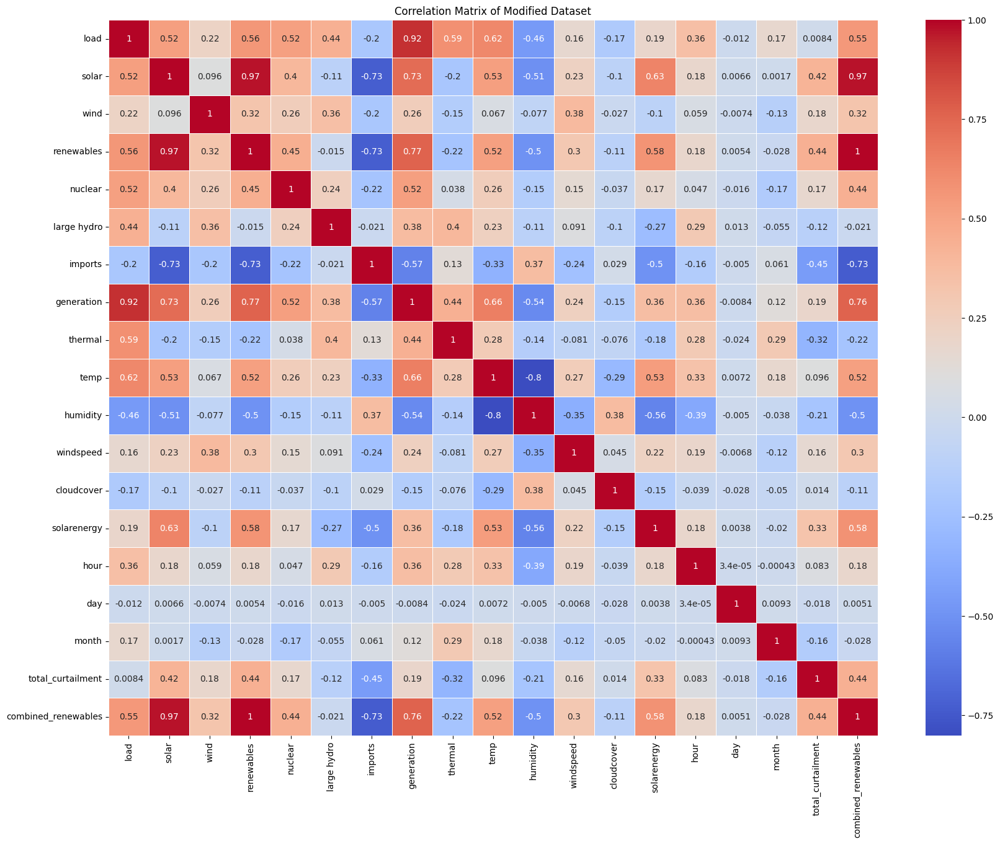

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Remove non-numeric columns before calculating the correlation matrix
numeric_data_final = data_final.select_dtypes(include=['float64', 'int64'])

# Step 5: Correlation Analysis on the modified dataset
# Calculate the new correlation matrix for 'data_final'
new_correlation_matrix = numeric_data_final.corr()

# Plotting the correlation heatmap
plt.figure(figsize=(20, 15))
sns.heatmap(new_correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix of Modified Dataset')
plt.show()


In [ ]:
numeric_data_final.head()

,load,solar,wind,renewables,nuclear,large hydro,imports,generation,thermal,temp,humidity,windspeed,cloudcover,solarenergy,hour,day,month,total_curtailment,combined_renewables
0,261642.173073,0.0,3406.967436,20091.520292,27279.731877,15895.241613,99143.546667,162410.879518,99144.385736,6.3,92.32,0.5,8.7,0.0,1,1,1,0.0,23498.487728
1,252464.832604,0.0,5967.002946,22649.576156,27273.699994,14712.373468,91953.413333,160451.063841,95815.414224,6.2,92.32,0.5,8.7,0.0,2,1,1,0.0,28616.579101
2,245416.002344,0.0,6199.244249,22898.479955,27280.022811,14073.236606,93985.426667,151384.511224,87132.771853,5.8,95.57,5.8,8.7,0.0,3,1,1,0.0,29097.724204
3,241363.031667,0.0,5080.579630,21691.987069,27280.588677,14248.185413,94369.893333,146970.820052,83750.058893,6.1,92.25,4.9,5.0,0.0,4,1,1,0.0,26772.566699
4,239642.357318,0.0,9443.764928,26065.495828,27262.534627,15167.772388,93689.306667,145981.897747,77486.094904,5.2,92.37,0.5,5.0,0.0,5,1,1,0.0,35509.260757


####Descriptive statistics

In [ ]:
# Step 1: Descriptive Statistics
descriptive_stats = new_correlation_matrix.describe()

# Display the summary statistics
descriptive_stats


,load,solar,wind,renewables,nuclear,large hydro,imports,generation,thermal,temp,humidity,windspeed,cloudcover,solarenergy,hour,day,month,total_curtailment,combined_renewables
count,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000
mean,0.315316,0.264979,0.148534,0.289180,0.214646,0.137887,-0.184015,0.338813,0.095750,0.245912,-0.189642,0.154425,0.001768,0.156939,0.165322,0.048353,0.054716,0.118513,0.287536
std,0.379141,0.490542,0.277752,0.490121,0.297891,0.297766,0.422616,0.439490,0.343237,0.410234,0.422564,0.281988,0.275008,0.406773,0.276298,0.230737,0.258291,0.328672,0.490818
min,-0.461161,-0.725238,-0.198496,-0.727614,-0.220501,-0.268207,-0.731781,-0.570025,-0.321952,-0.801091,-0.801091,-0.354109,-0.288128,-0.562700,-0.391020,-0.027936,-0.165392,-0.452667,-0.731781
25%,0.086488,-0.050941,-0.051981,-0.021556,0.011042,-0.079658,-0.478797,0.155281,-0.169040,0.081931,-0.503145,0.019270,-0.106400,-0.125227,0.023369,-0.010439,-0.052458,-0.071382,-0.024349
50%,0.357484,0.226570,0.096388,0.321781,0.170848,0.012579,-0.198496,0.362931,-0.024058,0.267526,-0.214035,0.164548,-0.049569,0.178327,0.178327,-0.004952,-0.020272,0.096409,0.318167
75%,0.557483,0.581233,0.289527,0.568419,0.419564,0.322563,0.011801,0.694237,0.288599,0.522903,-0.057379,0.251996,-0.006348,0.445905,0.286972,0.006020,0.090315,0.260996,0.566685
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


####Distribution analysis

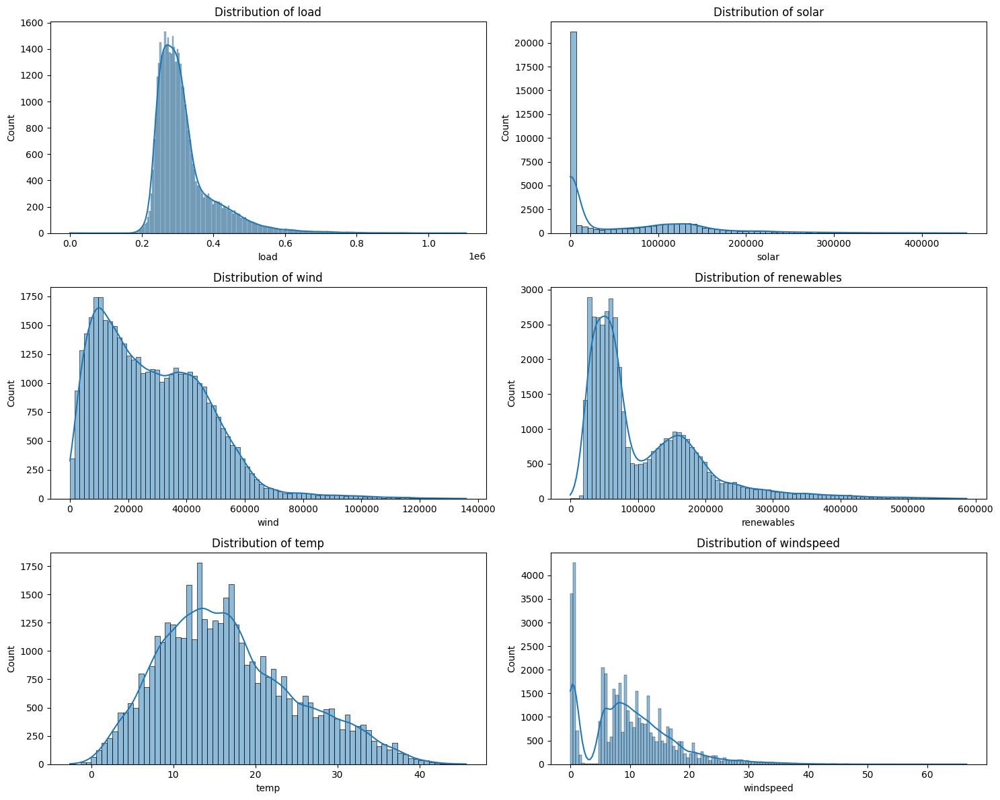

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define key features to visualize distributions
key_features = ['load', 'solar','wind','renewables', 'temp', 'windspeed']

# Set up the figure for subplots
plt.figure(figsize=(15, 12))

# Plot histograms for each of the key features
for i, feature in enumerate(key_features, 1):
    plt.subplot(3, 2, i)
    sns.histplot(data_final[feature], kde=True)
    plt.title(f'Distribution of {feature}')

plt.tight_layout()
plt.show()


**Interpretation of Distribution Analysis**

1. **Skewness in Energy Features:** The distributions of the majority of energy-related features, such as load, solar, wind, and renewables, are skewed to the right. This suggests that while high values are uncommon, low levels of energy production or consumption are far more prevalent. It draws attention to how intermittent and variable renewable energy production is, with periods of extremely low production occurring frequently.

2. **Intermittent Renewable Generation:** The intermittent nature of renewable energy sources is reflected in the large concentration of low values in the features pertaining to renewable energy generation (solar, wind, and mixed renewables). These regular low production levels could be caused by a variety of factors, including the seasons, weather, and time of day.

3. The sole feature that exhibits a normal-like distribution, which denotes seasonal stability and predicted volatility, is temperature. Because it has fewer extreme changes than energy generation, it may be a dependable input feature for modeling purposes.

4. The excessive skewness of some attributes may necessitate the use of data transformations (such as log or square root) in order to make them more appropriate for specific statistical studies or machine learning models that rely on normalcy.


5. Understanding Renewable Variability: The uneven distributions of renewable energy sources show how difficult it is to generate power from them consistently. It emphasizes how crucial it is to have reliable backup plans or storage options in order to maintain dependability when renewable energy production is low.


Overall, there is a skewed distribution of demand (load) and considerable unpredictability and intermittency in the data, especially in the production of renewable energy. This implies that addressing intermittency problems and investigating strategies to stabilize patterns of energy generation and consumption should be a primary focus of any modeling or analysis.






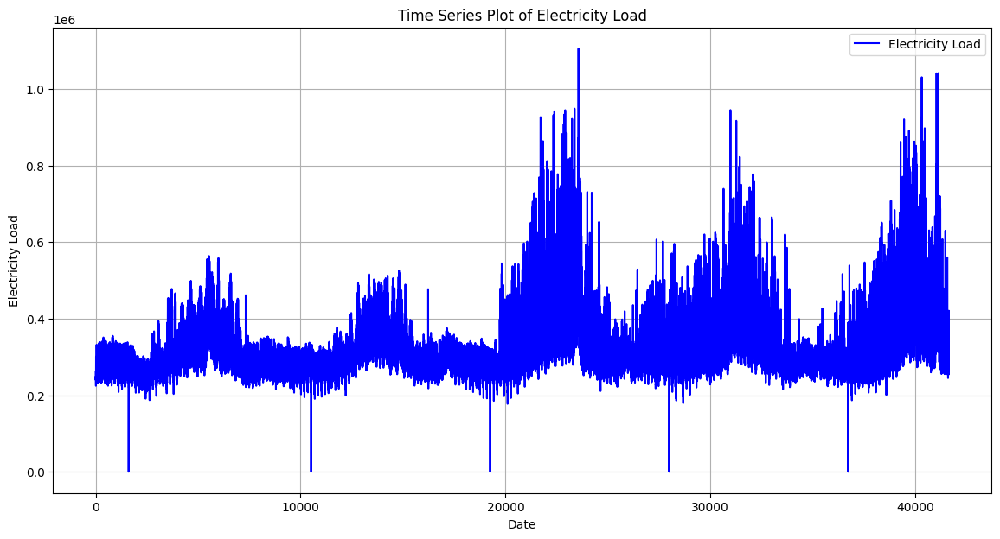

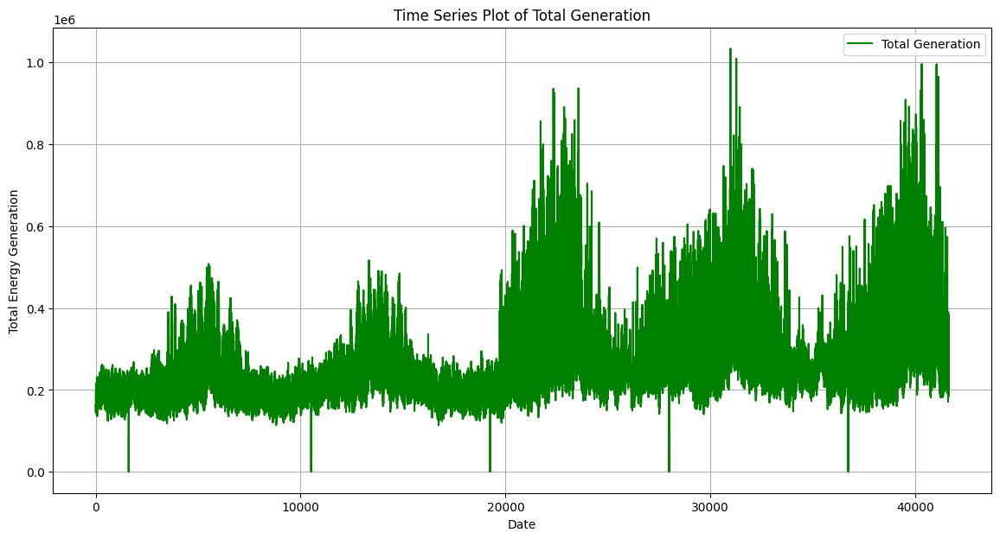

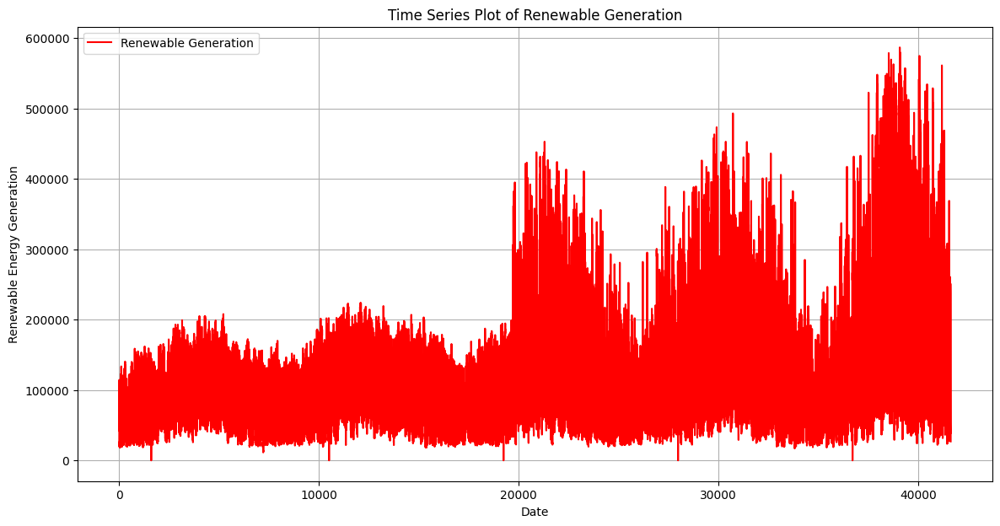

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Set the 'datetime' column as the index for easier plotting
data_final.set_index('datetime', inplace=True)

# Plotting the load over time
plt.figure(figsize=(14, 7))
plt.plot(numeric_data_final.index, numeric_data_final['load'], color='b', label='Electricity Load')
plt.xlabel('Date')
plt.ylabel('Electricity Load')
plt.title('Time Series Plot of Electricity Load')
plt.legend()
plt.grid(True)
plt.show()

# Plotting the total generation over time
plt.figure(figsize=(14, 7))
plt.plot(numeric_data_final.index, numeric_data_final['generation'], color='g', label='Total Generation')
plt.xlabel('Date')
plt.ylabel('Total Energy Generation')
plt.title('Time Series Plot of Total Generation')
plt.legend()
plt.grid(True)
plt.show()

# Plotting the renewable generation (solar, wind, renewables) over time
plt.figure(figsize=(14, 7))
plt.plot(numeric_data_final.index, numeric_data_final['renewables'], color='r', label='Renewable Generation')
plt.xlabel('Date')
plt.ylabel('Renewable Energy Generation')
plt.title('Time Series Plot of Renewable Generation')
plt.legend()
plt.grid(True)
plt.show()


**Interpretation of Timeseries plot**

**1. For Electricity Load**
  - **Seasonal Peaks:** There are distinct seasonal peaks in the plot, with the electricity load increasing noticeably throughout particular seasons. Extreme weather circumstances, such as the need for heating in the winter or cooling in the summer, may be the cause of these peaks.
  - **General Trends:** The power load exhibits cyclic behavior over the entire period, as evidenced by an apparent fluctuating pattern. This can imply that some seasons or months continuously need higher electricity usage.
  - **Periods of Low Demand:** There are also noticeable decreases in the load at particular times, which may be related to public holidays or periods when business and industrial activity is slower.

**2. For Total Energy Generation**
  - **Correlation with Load:** The overall energy generation pattern seems to closely resemble the electricity load pattern, with generation peaks generally occurring in tandem with demand peaks. This suggests that energy production is expanding to efficiently satisfy demand.
  - **High Peaks:** High generation peaks, like the power load, are probably caused by higher output to keep up with seasonal demand peaks.
  - **Fluctuations:** In order to preserve stability, the system must quickly adapt to variations in demand, as shown by the generation fluctuations. This is typical of electrical grids.

**3. For Renewable Generation**
  - **Correlation with Load:** The overall energy generation pattern seems to closely resemble the electricity load pattern, with generation peaks generally occurring in tandem with demand peaks. This suggests that energy production is expanding to efficiently satisfy demand.
  - **High Peaks:** High generation peaks, like the power load, are probably caused by higher output to keep up with seasonal demand peaks.
  - **Fluctuations:** In order to preserve stability, the system must quickly adapt to variations in demand, as shown by the generation fluctuations. This is typical of electrical grids.




####Seasonal decomposition

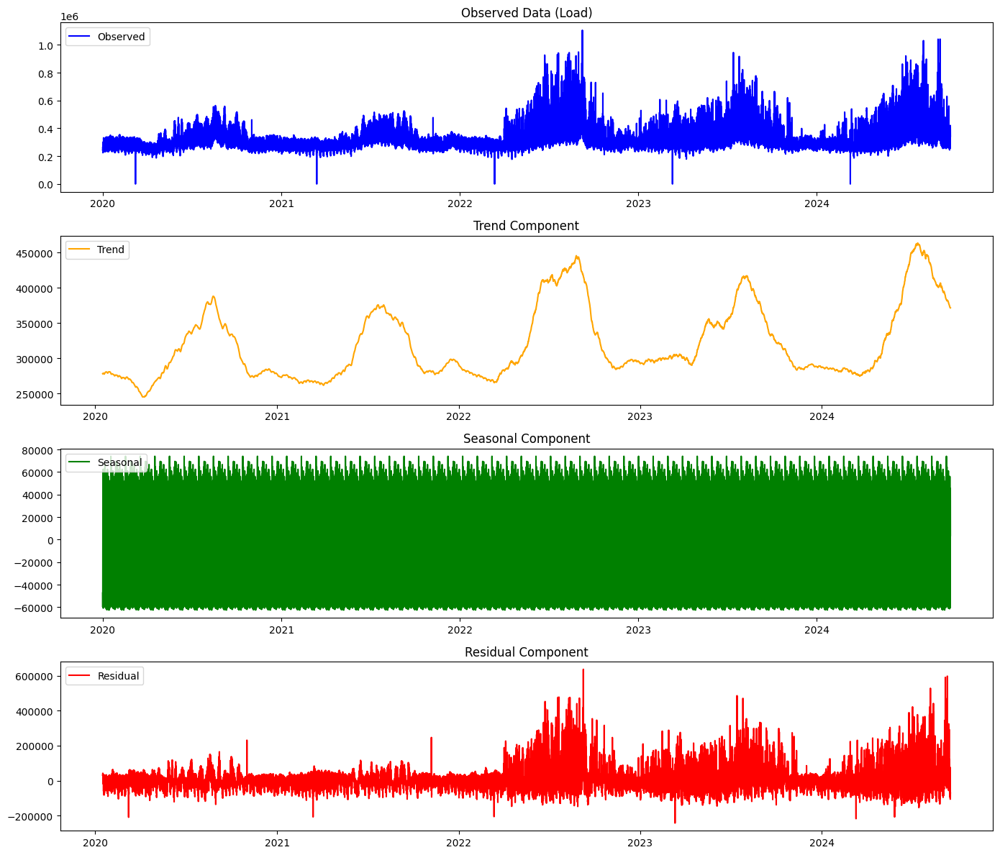

In [ ]:
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

# Perform seasonal decomposition for the 'load' variable using an additive model
# Decompose the data into observed, trend, seasonal, and residual components
# Assuming daily periodicity over a month (24 hours * 30 days)
result = seasonal_decompose(data_final['load'], model='additive', period=24 * 30)

# Set the figure size for plotting the decomposition results
plt.figure(figsize=(14, 12))

# Plot the observed load data
plt.subplot(411)
plt.plot(result.observed, label='Observed', color='blue')
plt.legend(loc='upper left')
plt.title('Observed Data (Load)')

# Plot the trend component of the load data
plt.subplot(412)
plt.plot(result.trend, label='Trend', color='orange')
plt.legend(loc='upper left')
plt.title('Trend Component')

# Plot the seasonal component of the load data
plt.subplot(413)
plt.plot(result.seasonal, label='Seasonal', color='green')
plt.legend(loc='upper left')
plt.title('Seasonal Component')

# Plot the residual component (noise) of the load data
plt.subplot(414)
plt.plot(result.resid, label='Residual', color='red')
plt.legend(loc='upper left')
plt.title('Residual Component')

# Adjust layout to prevent overlap and display the plot
plt.tight_layout()
plt.show()


**Interpretation of Seasonal Decomposition Plot**
- The observed load shows clear evidence of seasonal variations and long-term cyclic trends. There are recurring peaks and troughs, reflecting the impact of seasonal demand on electricity load.
- The trend component helps identify periods of increasing or decreasing demand over the years, likely affected by broader socio-economic factors.
- The seasonal component highlights regular fluctuations over time, which are expected and likely tied to daily, weekly, or monthly electricity usage patterns.
- The residual component indicates unexplained or irregular behavior in the load, suggesting that certain events (e.g., unexpected weather changes, holidays, or equipment failures) may have led to deviations from the expected patterns.

####Time series plots

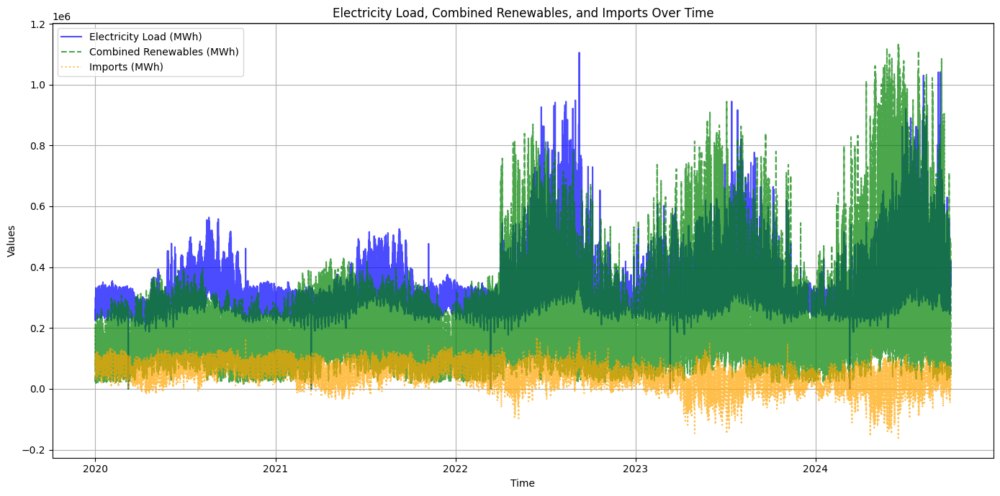

In [ ]:
# Plot Load, Combined Renewables, and Imports Over Time
plt.figure(figsize=(14, 7))

plt.plot(data_final.index, data_final['load'], label='Electricity Load (MWh)', color='blue', alpha=0.7)
plt.plot(data_final.index, data_final['combined_renewables'], label='Combined Renewables (MWh)', color='green', linestyle='--', alpha=0.7)
plt.plot(data_final.index, data_final['imports'], label='Imports (MWh)', color='orange', linestyle=':', alpha=0.7)

plt.xlabel('Time')
plt.ylabel('Values')
plt.title('Electricity Load, Combined Renewables, and Imports Over Time')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


**Interpreation of Electricity Load, Combined Renewables, Imports over Time:**

- Demand vs. Supply: The electricity load (blue) consistently exceeds the generation from renewables (green), indicating that there is a gap between renewable generation and demand.
During peak periods, the gap widens, showing that renewable energy alone is insufficient to meet high demand. Therefore, additional energy sources (such as imports or other non-renewable generation) are necessary.
Role of Imports:

- Imports (orange) help balance the shortfall in supply, especially during demand peaks. This shows that imports are crucial in maintaining grid stability and meeting electricity demand during periods when local or renewable generation alone is not enough.
Imports seem to follow the trends in load, albeit with a smaller magnitude, suggesting a supplemental role during both regular and peak demand.
Increased Renewable Contribution:

- There is a noticeable increase in the generation from renewables from late 2022 onwards, suggesting a positive trend towards more reliance on renewables, which aligns with efforts to decarbonize energy generation.
However, the variability and limitations of renewables, especially in meeting peak load, highlight the need for energy storage solutions or backup generation to handle periods when renewable output is insufficient.
Seasonal and Cyclic Trends:

- The plot clearly shows seasonal trends in the load, where demand increases significantly during certain times of the year. The renewable generation, while increasing, cannot meet these peaks alone.
This observation indicates the importance of energy planning that considers seasonal variability and includes strategies for energy imports, storage, or demand response to manage peak load periods effectively.

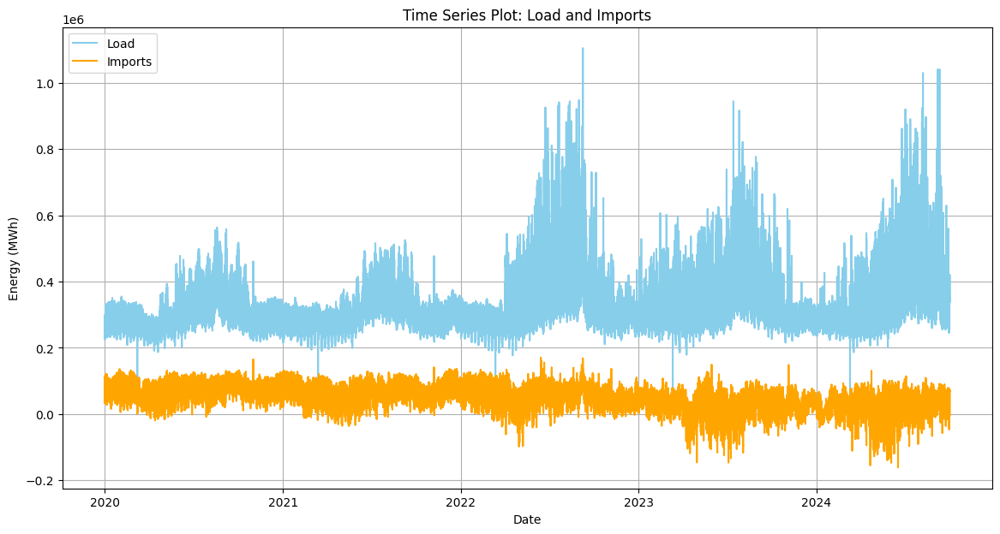

In [ ]:
import matplotlib.pyplot as plt

# Plotting time series line chart for 'load' and 'imports'
plt.figure(figsize=(14, 7))
plt.plot(data_final.index, data_final['load'], label='Load', color='skyblue')
plt.plot(data_final.index, data_final['imports'], label='Imports', color='orange')
plt.xlabel('Date')
plt.ylabel('Energy (MWh)')
plt.title('Time Series Plot: Load and Imports')
plt.legend()
plt.grid(True)
plt.show()


**Interpretation of Load and Imports**

- The electricity load exhibits strong seasonal variability, with recurring high peaks and low valleys over each year, reflecting typical seasonal energy consumption patterns.
- Imports appear to play a steady supplementary role, providing a consistent level of energy but not adjusting significantly to the peaks in demand. This indicates that local generation, including both renewable and non-renewable sources, is relied upon heavily to handle high consumption periods.
- The consistency in imports suggests that, while they are an important source of energy stability, the main challenge is to manage and balance the load using local and renewable energy sources effectively, especially during high demand periods.

####Stacked Area Chart for Contribution:



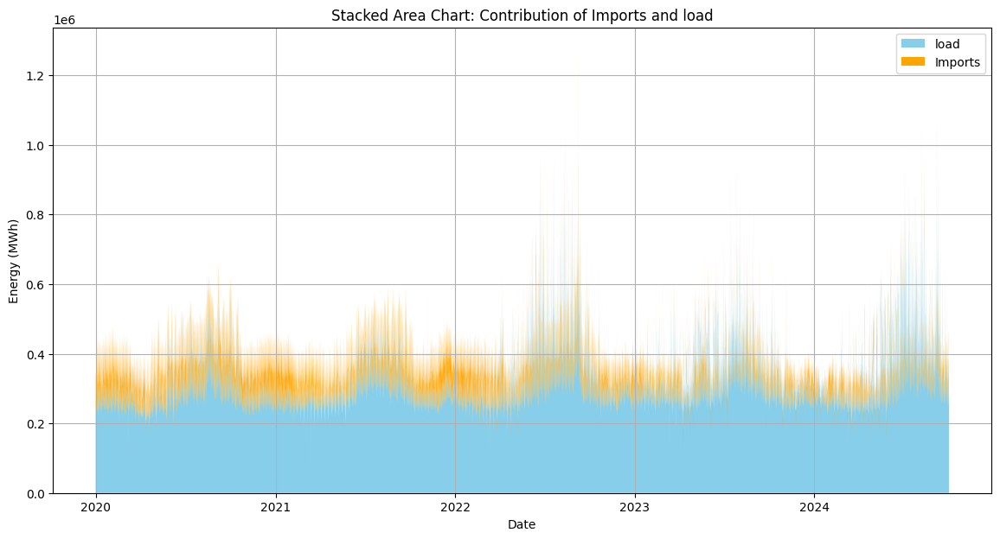

In [ ]:
plt.figure(figsize=(14, 7))
plt.stackplot(data_final.index, data_final['load'], data_final['imports'],
              labels=['load', 'Imports'], colors=['skyblue', 'orange'])
plt.xlabel('Date')
plt.ylabel('Energy (MWh)')
plt.title('Stacked Area Chart: Contribution of Imports and load')
plt.legend()
plt.grid(True)
plt.show()


**Interpretation of Contirbution of Imports and Load**

1. **Dependence on Local Generation:**

  The light blue area, which represents load, is substantially larger than the imports contribution, indicating that the electricity system is highly dependent on local generation to meet energy needs.
  Imports provide only a small share of the total energy mix, which means that local renewable and non-renewable sources play a primary role in energy supply.

2. **Steady Imports Contribution:**
  Imports maintain a consistent level of support throughout the observed period. Their relatively steady contribution suggests that imports are used to meet baseline energy requirements and ensure reliability.
  Even during times of increased load, the imports do not increase proportionally, which could indicate that import contracts or capacity limitations do not allow for a significant ramp-up in imports during peak periods.

3. **Seasonal Variability:**

  The total load (light blue area) shows significant seasonal variability, with regular peaks and troughs each year. This highlights the importance of flexible local generation capacity to handle changing demand patterns.
  The peaks in load suggest that energy planners need to focus on strategies to either meet peak demands more efficiently or manage demand through mechanisms like demand response or energy storage.

####Scatter plot

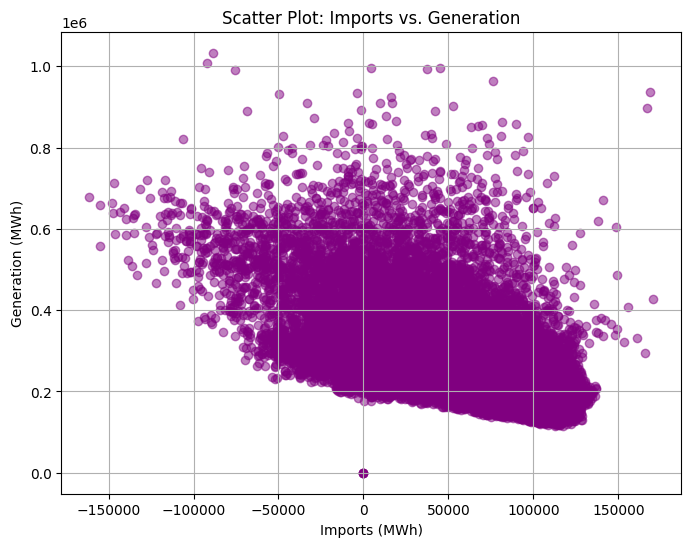

In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(data_final['imports'], data_final['generation'], color='purple', alpha=0.5)
plt.xlabel('Imports (MWh)')
plt.ylabel('Generation (MWh)')
plt.title('Scatter Plot: Imports vs. Generation')
plt.grid(True)
plt.show()


**Interpretation of Scatter plots**

- The scatter plot suggests a complex relationship between imports and generation, with no clear one-to-one correlation between the two.

- Negative import values (indicating exports) occur when generation is sufficiently high, implying that the system can produce excess energy beyond local requirements, possibly due to favorable conditions for renewable energy generation.

- The triangular distribution implies that when generation levels are low, imports play a more critical role in meeting demand, whereas when generation is high, the reliance on imports is reduced, and excess energy can even be exported.

- High variability in import values for similar generation levels indicates that imports are likely driven by other factors, such as demand peaks, market conditions, or specific energy policies, rather than directly tracking with local generation.

In [ ]:
data_final.to_csv('final_data.csv')

#Modeling

##Research Question 1

**How do weather conditions and energy generation factors influence electricity demand during peak load seasons, and what key drivers significantly impact these fluctuations?**

- old question:
how can we model the combined effect of renewable and traditional power sources to ensure grid stability?



In [ ]:
features = ['solar', 'renewables', 'imports', 'temp', 'hour', 'month', 'humidity', 'wind']
target = 'load'

X = data_final[features]
y = data_final[target]

###Linear Regression

### Linear Regression Model Performance ###

Training Performance:
R²: 0.7009330012612438
Mean Absolute Error (MAE): 34771.49219424299
Mean Squared Error (MSE): 2142155831.07879

Test Performance:
R²: 0.7129336596855201
Mean Absolute Error (MAE): 34358.71071032277
Mean Squared Error (MSE): 2062269638.9082224


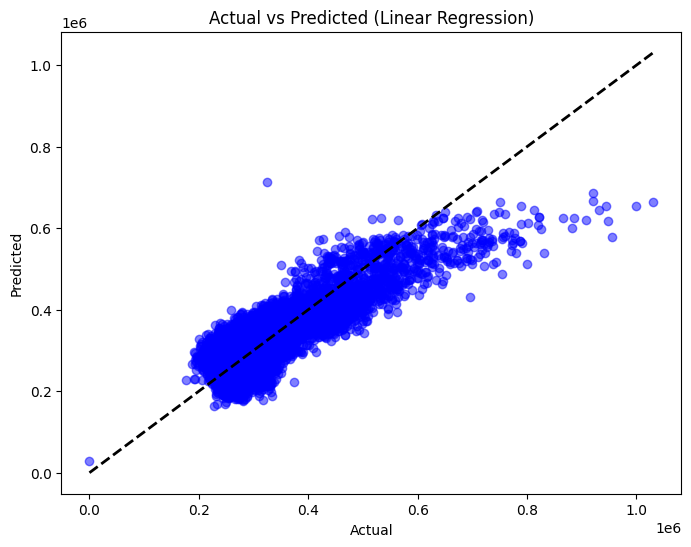

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Assuming X and y are your features and target
# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the Linear Regression model
linear_reg = LinearRegression()

# Fit the model on training data
linear_reg.fit(X_train, y_train)

# Make predictions on training and test data
y_train_pred = linear_reg.predict(X_train)
y_test_pred = linear_reg.predict(X_test)

# Print heading and evaluate the model on training data
print("### Linear Regression Model Performance ###\n")
print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred))

# Print heading and evaluate the model on test data
print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred))

# Optional: Plotting actual vs predicted values for test data
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Linear Regression)')
plt.show()

**Interpretation:**
The Linear Regression model captures a moderate amount of variance but lacks the ability to accurately predict the target values, especially at higher levels. The model's consistent performance across training and test sets indicates no severe overfitting, but the low R² score and high error metrics suggest that linear regression may be insufficient for accurately modeling this problem.

###Ridge and Lasso Regression

### Ridge Regression Model Performance ###

Training Performance:
R²: 0.7009330012610056
Mean Absolute Error (MAE): 34771.48981050533
Mean Squared Error (MSE): 2142155831.080497

Test Performance:
R²: 0.7129336644820243
Mean Absolute Error (MAE): 34358.708568389455
Mean Squared Error (MSE): 2062269604.4503868


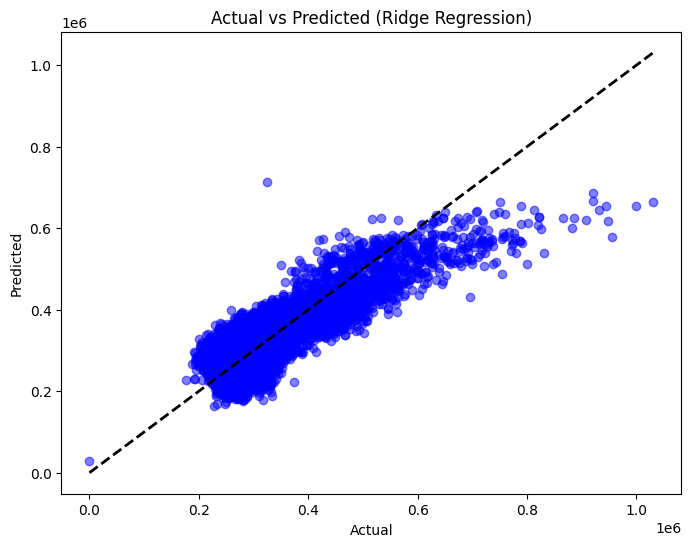


### Lasso Regression Model Performance ###

Training Performance:
R²: 0.6852854195093252
Mean Absolute Error (MAE): 35626.89676236565
Mean Squared Error (MSE): 2254236263.3348236

Test Performance:
R²: 0.6936736922548523
Mean Absolute Error (MAE): 35306.83235553888
Mean Squared Error (MSE): 2200632241.904851


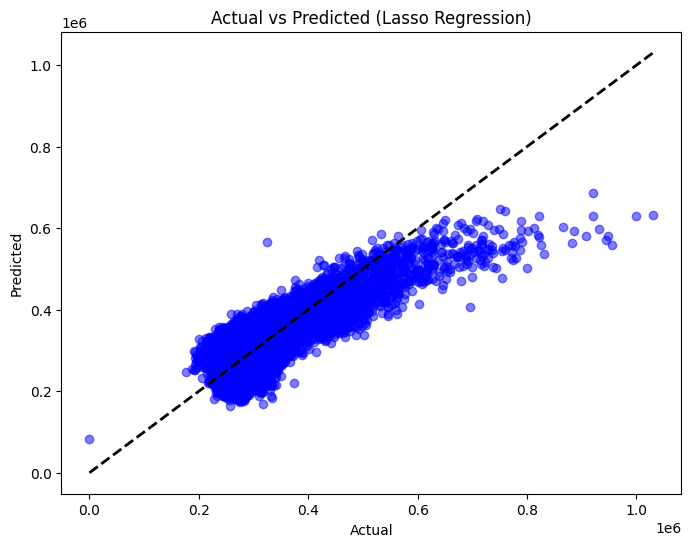

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Ridge, Lasso
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Assuming X and y are your features and target
# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Ridge Regression
ridge_reg = Ridge(alpha=1.0)  # Adjust alpha for regularization strength
ridge_reg.fit(X_train, y_train)
y_train_pred_ridge = ridge_reg.predict(X_train)
y_test_pred_ridge = ridge_reg.predict(X_test)

print("### Ridge Regression Model Performance ###\n")
print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred_ridge))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_ridge))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_ridge))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred_ridge))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_ridge))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_ridge))

# Optional: Plot actual vs predicted values for Ridge
import matplotlib.pyplot as plt
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_ridge, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Ridge Regression)')
plt.show()

# Lasso Regression
lasso_reg = Lasso(alpha=0.1)  # Adjust alpha for regularization strength
lasso_reg.fit(X_train, y_train)
y_train_pred_lasso = lasso_reg.predict(X_train)
y_test_pred_lasso = lasso_reg.predict(X_test)

print("\n### Lasso Regression Model Performance ###\n")
print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred_lasso))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_lasso))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_lasso))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred_lasso))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_lasso))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_lasso))

# Optional: Plot actual vs predicted values for Lasso
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_lasso, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Lasso Regression)')
plt.show()

**Interpretation:**
1. **Ridge Regression** performed almost identically to Linear Regression, with minimal differences in metrics such as R², MAE, and MSE for both training and test sets. This indicates that adding Ridge regularization (L2 penalty) had little effect on model performance, likely because the original Linear Regression model did not suffer from overfitting to the extent where regularization would help significantly.

2. **Lasso Regression** has not provided a significant improvement compared to Linear or Ridge Regression models. The R² score, MAE, and MSE values are nearly identical, indicating that Lasso regularization did not have a notable effect on the model's performance.
  - Lasso did not effectively reduce coefficients to zero, which suggests that all features might still be contributing similarly to the prediction, or that the dataset might not have strong irrelevant features for Lasso to remove.

###Polynomial Regression

### Polynomial Regression (Degree = 2) ###

Training Performance:
R²: 0.8478917854951553
Mean Absolute Error (MAE): 24517.907270831445
Mean Squared Error (MSE): 1089520074.1997173

Test Performance:
R²: 0.8514396431252488
Mean Absolute Error (MAE): 24565.89875398964
Mean Squared Error (MSE): 1067249867.0256546


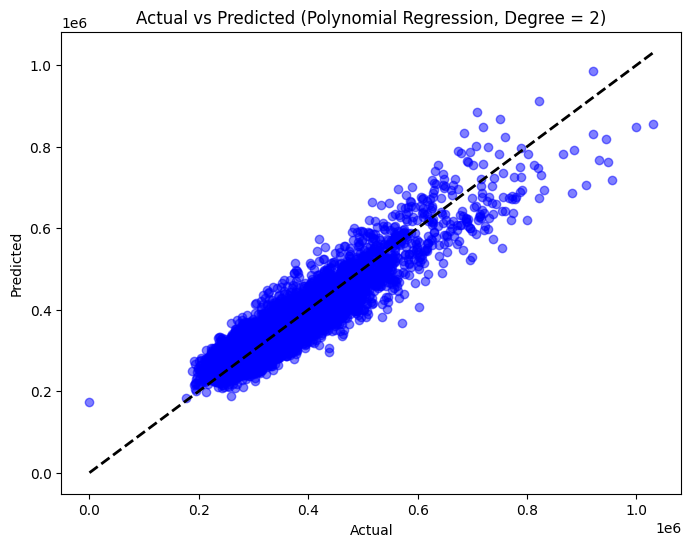

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Assuming X and y are your features and target
# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define the degree of the polynomial
degree = 2  # You can adjust this to increase model complexity

# Create polynomial features
poly_features = PolynomialFeatures(degree=degree)
X_train_poly = poly_features.fit_transform(X_train)
X_test_poly = poly_features.transform(X_test)

# Initialize and train the linear regression model on polynomial features
poly_reg_model = LinearRegression()
poly_reg_model.fit(X_train_poly, y_train)

# Make predictions on the training and test sets
y_train_pred_poly = poly_reg_model.predict(X_train_poly)
y_test_pred_poly = poly_reg_model.predict(X_test_poly)

# Print model performance
print(f"### Polynomial Regression (Degree = {degree}) ###\n")

print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred_poly))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_poly))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_poly))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred_poly))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_poly))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_poly))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_poly, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title(f'Actual vs Predicted (Polynomial Regression, Degree = {degree})')
plt.show()

          Feature   Coefficient  Abs_Coefficient
4            temp -22939.754831     22939.754831
6           month  -8606.423337      8606.423337
5            hour  -1382.266024      1382.266024
7        humidity    579.479728       579.479728
32     temp month    525.414308       525.414308
30         temp^2    378.794390       378.794390
39        month^2    268.285135       268.285135
35         hour^2    151.407908       151.407908
33  temp humidity     51.037619        51.037619
36     hour month    -41.512576        41.512576


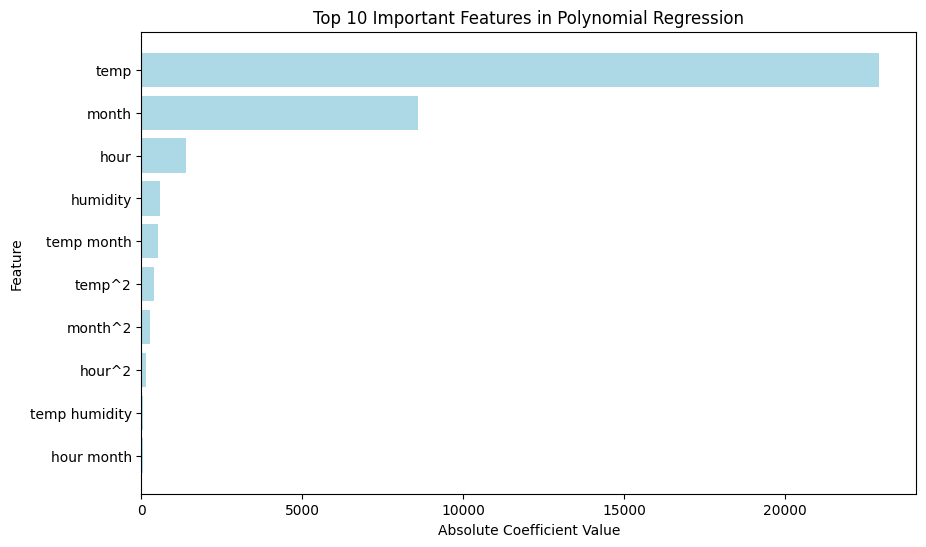

In [ ]:
import numpy as np
import pandas as pd

# Get the model coefficients
coefficients = poly_reg_model.coef_

# Get feature names from the PolynomialFeatures object
feature_names = poly_features.get_feature_names_out(input_features=X.columns)

# Create a DataFrame for easier visualization
coeff_df = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})

# Sort coefficients by their absolute value (importance)
coeff_df['Abs_Coefficient'] = coeff_df['Coefficient'].abs()
coeff_df = coeff_df.sort_values(by='Abs_Coefficient', ascending=False)

# Display the top 10 most important features
print(coeff_df.head(10))

# Optional: Visualize the coefficients
plt.figure(figsize=(10, 6))
plt.barh(coeff_df['Feature'][:10], coeff_df['Abs_Coefficient'][:10], color='lightblue')
plt.xlabel('Absolute Coefficient Value')
plt.ylabel('Feature')
plt.title('Top 10 Important Features in Polynomial Regression')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.show()


###Decision Tree Regression

### Decision Tree Regression Model Performance ###

Training Performance:
R²: 0.7609018554792562
Mean Absolute Error (MAE): 28224.05065522143
Mean Squared Error (MSE): 1712611176.2422829

Test Performance:
R²: 0.7529594189840022
Mean Absolute Error (MAE): 28640.048290111892
Mean Squared Error (MSE): 1774726668.5791986


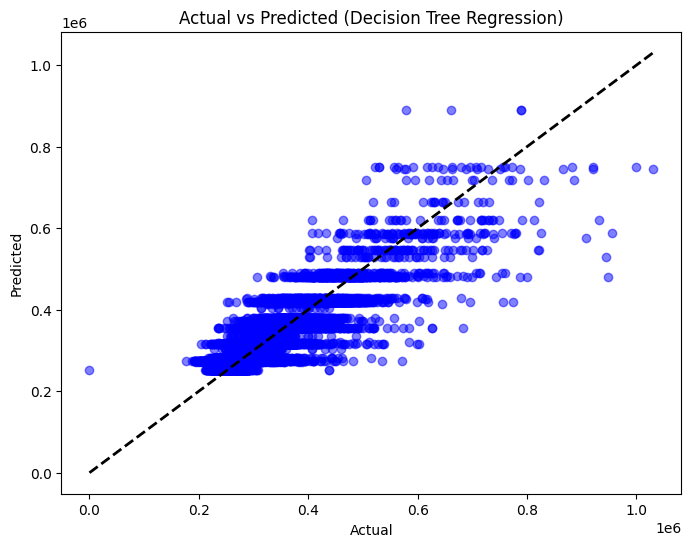

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Assuming X and y are your features and target
# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the Decision Tree Regressor
tree_reg = DecisionTreeRegressor(random_state=42, max_depth=5)  # Adjust max_depth to control complexity

# Fit the model on training data
tree_reg.fit(X_train, y_train)

# Make predictions on training and test sets
y_train_pred_dec = tree_reg.predict(X_train)
y_test_pred_dec = tree_reg.predict(X_test)

# Print model performance
print("### Decision Tree Regression Model Performance ###\n")

print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred_dec))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_dec))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_dec))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred_dec))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_dec))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_dec))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_dec, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Decision Tree Regression)')
plt.show()# Import necessary libraries


**Tuning Of Decision Tree**

Fitting 5 folds for each of 180 candidates, totalling 900 fits
Best Parameters: {'max_depth': 10, 'max_features': None, 'min_samples_leaf': 4, 'min_samples_split': 10}

### Decision Tree Regression Model Performance (Training Set) ###

R²: 0.8906422452389529
Mean Absolute Error (MAE): 19391.615601879035
Mean Squared Error (MSE): 783307262.3291872

### Decision Tree Regression Model Performance (Test Set) ###

R²: 0.8288348904207057
Mean Absolute Error (MAE): 22363.12924870575
Mean Squared Error (MSE): 1229641233.239258


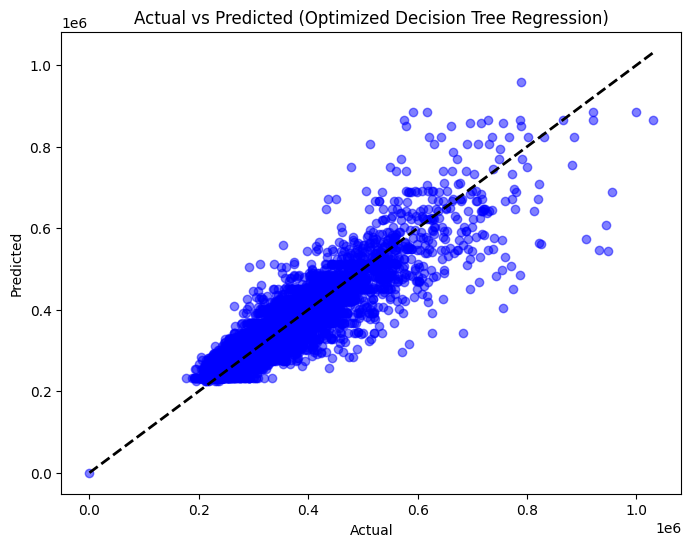

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define the parameter grid
param_grid = {
    'max_depth': [3, 5, 7, 10, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt', 'log2', None]
}

# Initialize the Decision Tree Regressor
tree_reg = DecisionTreeRegressor(random_state=42)

# Set up the GridSearchCV
grid_search = GridSearchCV(estimator=tree_reg, param_grid=param_grid,
                           scoring='neg_mean_squared_error', cv=5, n_jobs=-1, verbose=2)

# Fit GridSearchCV
grid_search.fit(X_train, y_train)

# Print the best parameters
print("Best Parameters:", grid_search.best_params_)

# Use the best estimator for predictions
best_tree_reg = grid_search.best_estimator_

# Make predictions on the training and test sets
y_train_pred_dectune = best_tree_reg.predict(X_train)
y_test_pred_dectune = best_tree_reg.predict(X_test)

# Print model performance for training set
print("\n### Decision Tree Regression Model Performance (Training Set) ###\n")
print("R²:", r2_score(y_train, y_train_pred_dectune))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_dectune))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_dectune))

# Print model performance for test set
print("\n### Decision Tree Regression Model Performance (Test Set) ###\n")
print("R²:", r2_score(y_test, y_test_pred_dectune))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_dectune))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_dectune))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_dectune, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Optimized Decision Tree Regression)')
plt.show()


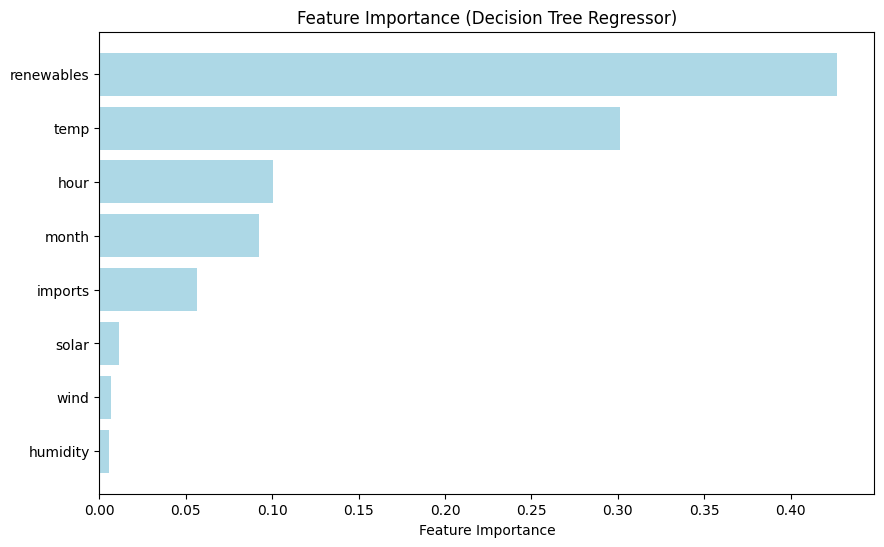

In [ ]:
import numpy as np

# Get feature importances from the best estimator
importances = best_tree_reg.feature_importances_

# Sort the feature importances in descending order
indices = np.argsort(importances)[::-1]

# Get the feature names
feature_names = X.columns

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.barh(range(len(importances)), importances[indices], align='center', color='lightblue')
plt.yticks(range(len(importances)), [feature_names[i] for i in indices])
plt.xlabel('Feature Importance')
plt.title('Feature Importance (Decision Tree Regressor)')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.show()


###Bagging Regressor

### Bagging Regressor Model Performance ###

Training Performance:
R²: 0.9839700386404954
Mean Absolute Error (MAE): 6799.8417909455775
Mean Squared Error (MSE): 114819339.28867355

Test Performance:
R²: 0.8913200577600806
Mean Absolute Error (MAE): 17937.078362627664
Mean Squared Error (MSE): 780751045.1909988


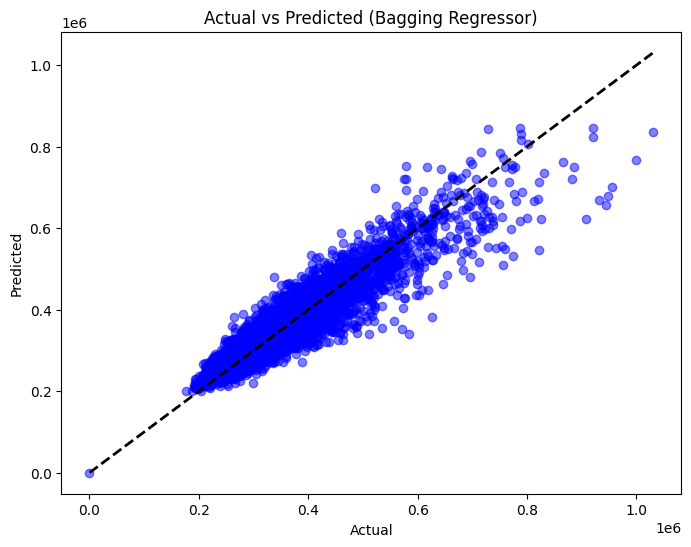

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import BaggingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the base model (Decision Tree) and Bagging Regressor
base_model = DecisionTreeRegressor(random_state=42)
bagging_reg = BaggingRegressor(estimator=base_model, n_estimators=50, random_state=42)

# Fit the Bagging Regressor on training data
bagging_reg.fit(X_train, y_train)

# Make predictions on training and test sets
y_train_pred_bagg = bagging_reg.predict(X_train)
y_test_pred_bagg = bagging_reg.predict(X_test)

# Print model performance
print("### Bagging Regressor Model Performance ###\n")

print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred_bagg))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_bagg))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_bagg))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred_bagg))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_bagg))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_bagg))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_bagg, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Bagging Regressor)')
plt.show()

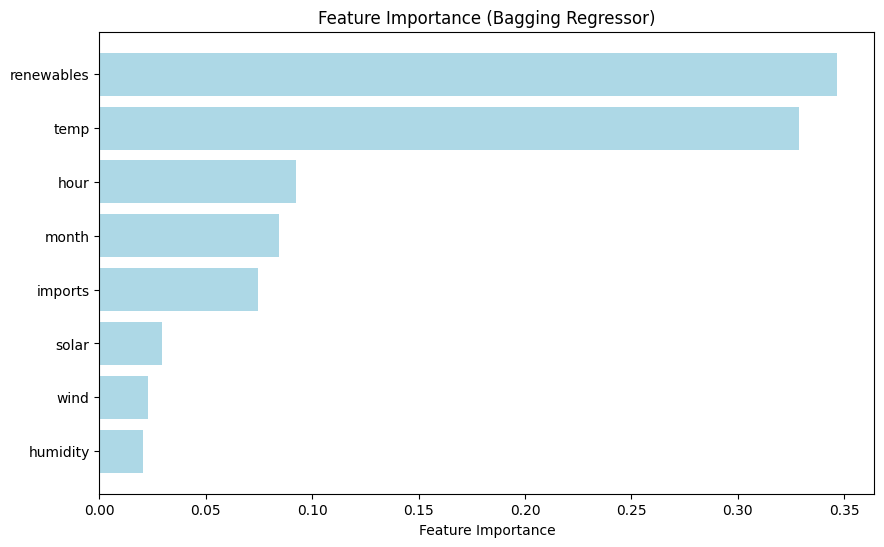

In [ ]:
import numpy as np

# Calculate average feature importances from all decision trees in the ensemble
feature_importances = np.mean([tree.feature_importances_ for tree in bagging_reg.estimators_], axis=0)

# Sort the feature importances in descending order
indices = np.argsort(feature_importances)[::-1]

# Get the feature names
feature_names = X.columns

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.barh(range(len(feature_importances)), feature_importances[indices], align='center', color='lightblue')
plt.yticks(range(len(feature_importances)), [feature_names[i] for i in indices])
plt.xlabel('Feature Importance')
plt.title('Feature Importance (Bagging Regressor)')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.show()


###Random Forest REgressor

In [ ]:
features = ['solar', 'renewables', 'imports', 'temp', 'hour', 'month', 'humidity', 'wind']
target = 'load'

X = data_final[features]
y = data_final[target]

### Random Forest Regressor Model Performance ###

Training Performance:
R²: 0.984545024914178
Mean Absolute Error (MAE): 6737.806254220782
Mean Squared Error (MSE): 110700830.04441068

Test Performance:
R²: 0.8935384401274649
Mean Absolute Error (MAE): 17798.4588885469
Mean Squared Error (MSE): 764814301.7931691


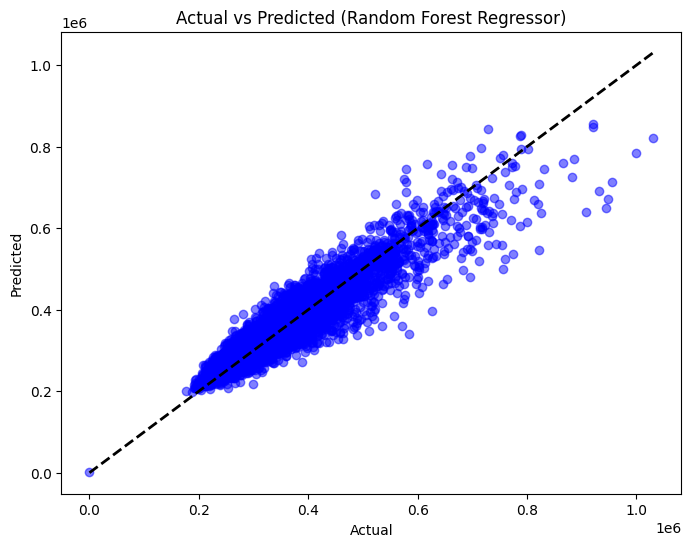

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the Random Forest Regressor
rf_reg = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the model on training data
rf_reg.fit(X_train, y_train)

# Make predictions on training and test sets
y_train_pred_random = rf_reg.predict(X_train)
y_test_pred_random = rf_reg.predict(X_test)

# Print model performance
print("### Random Forest Regressor Model Performance ###\n")

print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred_random))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_random))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_random))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred_random))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_random))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_random))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_random, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Random Forest Regressor)')
plt.show()

Fitting 3 folds for each of 32 candidates, totalling 96 fits
Best Parameters: {'max_depth': 20, 'max_features': 'log2', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
Best Score (negative MSE): -840762345.9517851

### Random Forest Regressor Model Performance (Training Set) ###

R²: 0.9650545411564683
Mean Absolute Error (MAE): 10306.58806617264
Mean Squared Error (MSE): 250307184.50077632

### Random Forest Regressor Model Performance (Test Set) ###

R²: 0.8924302105419042
Mean Absolute Error (MAE): 17878.64384867463
Mean Squared Error (MSE): 772775765.4211855


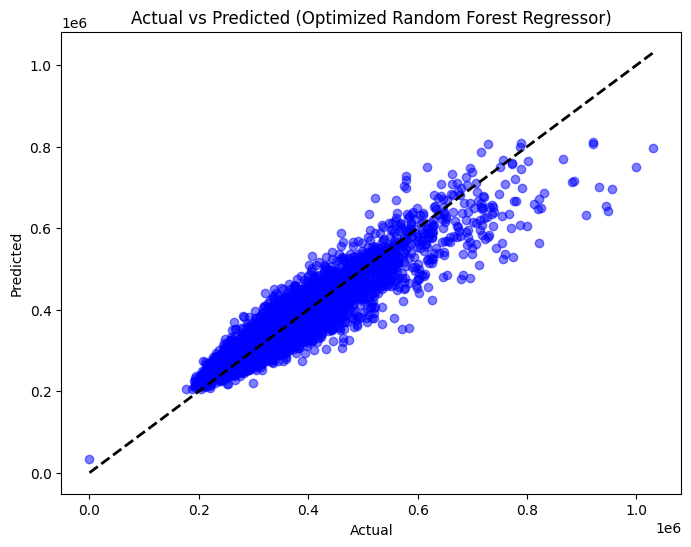

In [ ]:
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Define a reduced parameter grid to speed up GridSearchCV
param_grid = {
    'n_estimators': [50, 100],                # Fewer values for faster training
    'max_depth': [10, 20],                    # Reduced number of options
    'min_samples_split': [5, 10],             # Reduced options for splitting nodes
    'min_samples_leaf': [2, 4],               # Reduced options for leaf nodes
    'max_features': ['sqrt', 'log2']          # Avoid 'auto' as it can be computationally expensive
}

# Initialize the RandomForestRegressor
rf_reg = RandomForestRegressor(random_state=42)

# Set up the GridSearchCV with cross-validation
grid_search = GridSearchCV(estimator=rf_reg, param_grid=param_grid,
                           scoring='neg_mean_squared_error', cv=3, n_jobs=-1, verbose=1)

# Fit GridSearchCV to the training data (Reduced parameter grid and cv)
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print("Best Parameters:", grid_search.best_params_)
print("Best Score (negative MSE):", grid_search.best_score_)

# Use the best estimator for predictions
best_rf_reg = grid_search.best_estimator_

# Make predictions on the training and test sets
y_train_pred_rantune = best_rf_reg.predict(X_train)
y_test_pred_rantune = best_rf_reg.predict(X_test)

# Print model performance for the training set
print("\n### Random Forest Regressor Model Performance (Training Set) ###\n")
print("R²:", r2_score(y_train, y_train_pred_rantune))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred_rantune))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred_rantune))

# Print model performance for the test set
print("\n### Random Forest Regressor Model Performance (Test Set) ###\n")
print("R²:", r2_score(y_test, y_test_pred_rantune))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred_rantune))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred_rantune))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred_rantune, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Optimized Random Forest Regressor)')
plt.show()


In [ ]:
pip install lime


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=bddc3291c6a6c6f394dba4f168a4b7bbafed81414bd2131e946d1280b2572729
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
# Print features used in training and features currently in X
print("Features used in training:", best_rf_reg.feature_names_in_)
print("Current features in X:", X.columns)


Features used in training: ['solar' 'renewables' 'imports' 'temp' 'hour' 'month' 'humidity' 'wind']
Current features in X: Index(['solar', 'renewables', 'imports', 'temp', 'hour', 'month', 'humidity',
       'wind'],
      dtype='object')


In [ ]:
# Assuming the missing column is 'some_feature'
if 'some_feature' not in X.columns:
    X['some_feature'] = 0  # Fill with default or appropriate value (e.g., mean, median, etc.)


In [ ]:
import lime
import lime.lime_tabular
import numpy as np

# Ensure X has all 10 features required by the model
# Initialize the LIME explainer
explainer_rf_tuned = lime.lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train),
    feature_names=X.columns,
    mode='regression'
)

# Select an instance to explain
instance_index_rf_tuned = 8  # Adjust index as needed
instance_to_explain_rf_tuned = X_test.iloc[instance_index_rf_tuned].values.reshape(1, -1)

# Explain the prediction
exp_rf_tuned = explainer_rf_tuned.explain_instance(
    data_row=X_test.iloc[instance_index_rf_tuned],
    predict_fn=best_rf_reg.predict
)

# Display the explanation
exp_rf_tuned.show_in_notebook(show_table=True)


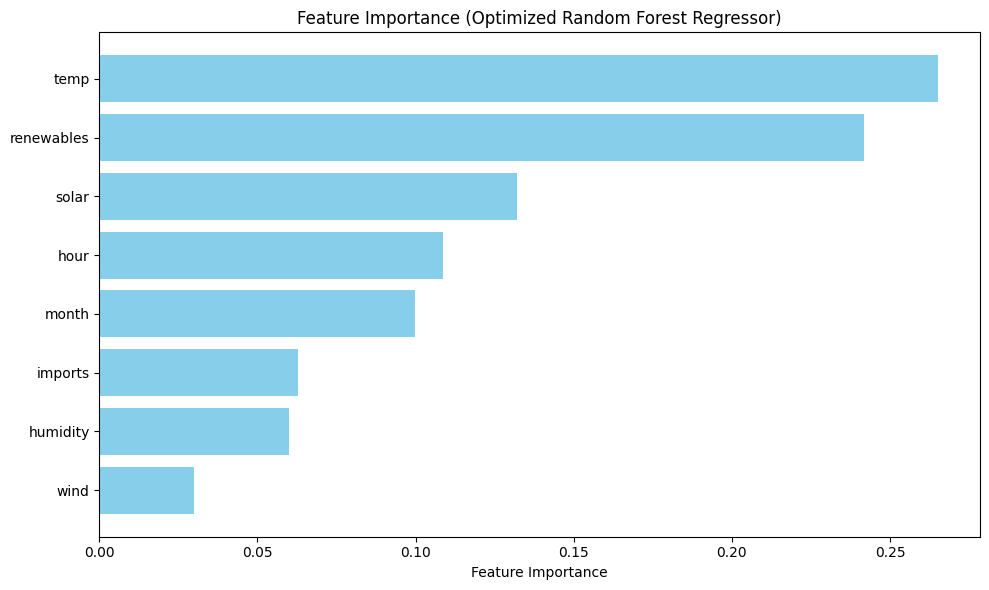

In [ ]:
# Attempting to plot the feature importances for the Random Forest model again

# Import necessary libraries
import matplotlib.pyplot as plt
import numpy as np

# Extract feature importances from the optimized Random Forest model
importances_rf = best_rf_reg.feature_importances_

# Sort the feature importances in descending order
indices = np.argsort(importances_rf)[::-1]

# Get the feature names
feature_names = X.columns

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.barh(range(len(importances_rf)), importances_rf[indices], align='center', color='skyblue')
plt.yticks(range(len(importances_rf)), [feature_names[i] for i in indices])
plt.xlabel('Feature Importance')
plt.title('Feature Importance (Optimized Random Forest Regressor)')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.tight_layout()
plt.show()


###GRadient Boosting Regressor

### Gradient Boosting Regressor Model Performance ###

Training Performance:
R²: 0.8747030594537799
Mean Absolute Error (MAE): 20913.494417321082
Mean Squared Error (MSE): 897476394.7187568

Test Performance:
R²: 0.8652919095211323
Mean Absolute Error (MAE): 21337.10487704483
Mean Squared Error (MSE): 967735906.6393402


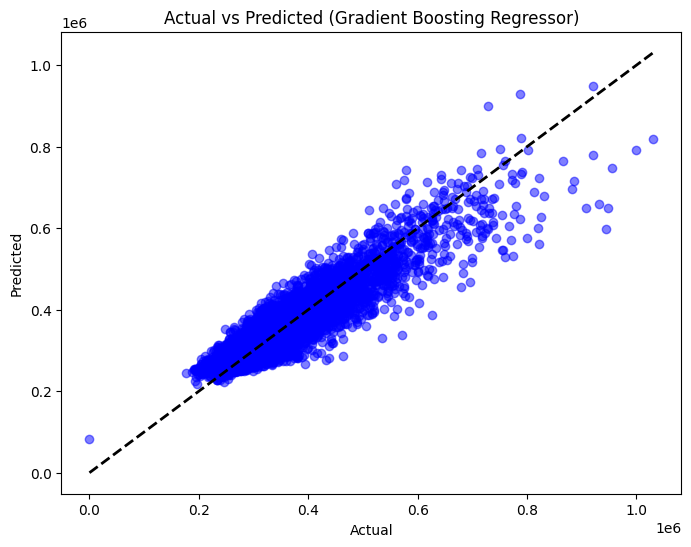

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the Gradient Boosting Regressor
gbr = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)

# Fit the model on training data
gbr.fit(X_train, y_train)

# Make predictions on training and test sets
y_train_pred = gbr.predict(X_train)
y_test_pred = gbr.predict(X_test)

# Print model performance
print("### Gradient Boosting Regressor Model Performance ###\n")

print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Gradient Boosting Regressor)')
plt.show()

**Tuning for gradient boosting regressor**

Fitting 3 folds for each of 32 candidates, totalling 96 fits
Best Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
Best Score (negative MSE): -827774101.5418963

### Gradient Boosting Regressor Model Performance (Training Set) ###

R²: 0.9114902354422445
Mean Absolute Error (MAE): 17775.392018013023
Mean Squared Error (MSE): 633977366.4577065

### Gradient Boosting Regressor Model Performance (Test Set) ###

R²: 0.890795575508563
Mean Absolute Error (MAE): 19040.41813820803
Mean Squared Error (MSE): 784518898.3717862


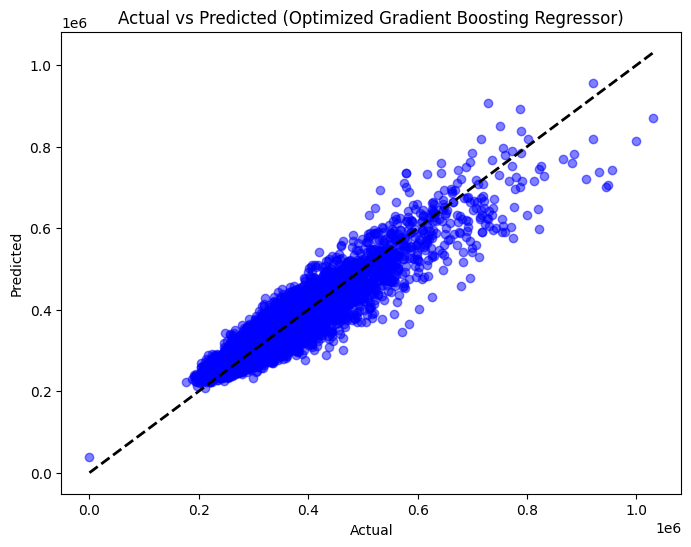

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Define a reduced parameter grid to speed up GridSearchCV
param_grid = {
    'n_estimators': [50, 100],              # Reduced number of estimators to 2 values
    'learning_rate': [0.05, 0.1],           # Focus on fewer learning rates
    'max_depth': [3, 5],                    # Reduced max depth to 2 values
    'min_samples_split': [5, 10],           # Reduced options for min_samples_split
    'min_samples_leaf': [2, 4]              # Reduced options for min_samples_leaf
}

# Initialize the GradientBoostingRegressor
gbr = GradientBoostingRegressor(random_state=42)

# Set up GridSearchCV with reduced cross-validation folds and fewer parameters
grid_search = GridSearchCV(estimator=gbr, param_grid=param_grid,
                           scoring='neg_mean_squared_error', cv=3, n_jobs=-1, verbose=1)

# Fit GridSearchCV to the training data (with reduced parameter grid and cv)
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print("Best Parameters:", grid_search.best_params_)
print("Best Score (negative MSE):", grid_search.best_score_)

# Use the best estimator for predictions
best_gbr = grid_search.best_estimator_

# Make predictions on the training and test sets
y_train_pred = best_gbr.predict(X_train)
y_test_pred = best_gbr.predict(X_test)

# Print model performance for the training set
print("\n### Gradient Boosting Regressor Model Performance (Training Set) ###\n")
print("R²:", r2_score(y_train, y_train_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred))

# Print model performance for the test set
print("\n### Gradient Boosting Regressor Model Performance (Test Set) ###\n")
print("R²:", r2_score(y_test, y_test_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Optimized Gradient Boosting Regressor)')
plt.show()


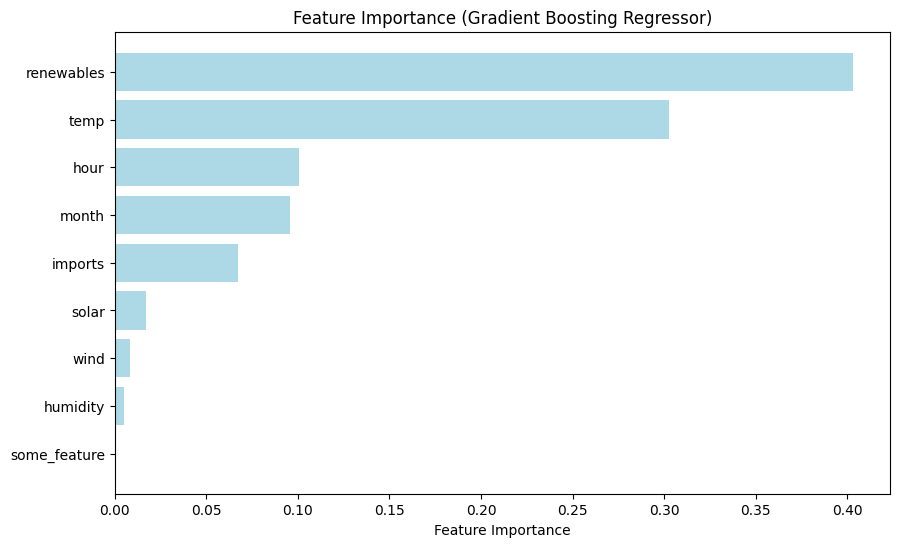

In [ ]:
# Get feature importances from the Gradient Boosting Regressor
importances = best_gbr.feature_importances_

# Sort the feature importances in descending order
indices = np.argsort(importances)[::-1]

# Get the feature names
feature_names = X.columns

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.barh(range(len(importances)), importances[indices], align='center', color='lightblue')
plt.yticks(range(len(importances)), [feature_names[i] for i in indices])
plt.xlabel('Feature Importance')
plt.title('Feature Importance (Gradient Boosting Regressor)')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.show()


###XGBoost

In [ ]:
!pip install xgboost

### XGBoost Regressor Model Performance ###

Training Performance:
R²: 0.8741393411440065
Mean Absolute Error (MAE): 20838.286623093452
Mean Squared Error (MSE): 901514193.8388854

Test Performance:
R²: 0.8678056153755033
Mean Absolute Error (MAE): 21138.218249307447
Mean Squared Error (MSE): 949677574.6909271


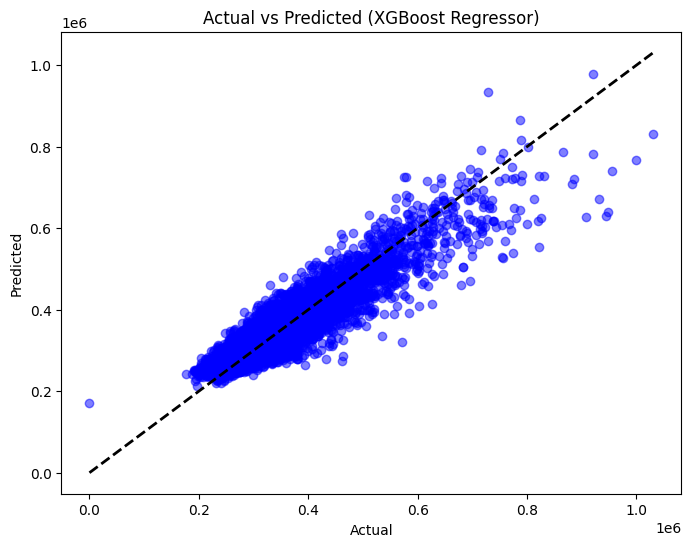

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Initialize the XGBoost Regressor
xgb_reg = XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)

# Fit the model on training data
xgb_reg.fit(X_train, y_train)

# Make predictions on training and test sets
y_train_pred = xgb_reg.predict(X_train)
y_test_pred = xgb_reg.predict(X_test)

# Print model performance
print("### XGBoost Regressor Model Performance ###\n")

print("Training Performance:")
print("R²:", r2_score(y_train, y_train_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred))

print("\nTest Performance:")
print("R²:", r2_score(y_test, y_test_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (XGBoost Regressor)')
plt.show()

Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best Parameters: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200, 'subsample': 0.8}
Best Score (negative MSE): -730604552.9727973

### XGBoost Regressor Model Performance (Training Set) ###

R²: 0.9572701249167876
Mean Absolute Error (MAE): 12993.484956154103
Mean Squared Error (MSE): 306065368.1509321

### XGBoost Regressor Model Performance (Test Set) ###

R²: 0.9065026092111128
Mean Absolute Error (MAE): 17557.836671342888
Mean Squared Error (MSE): 671680386.2474066


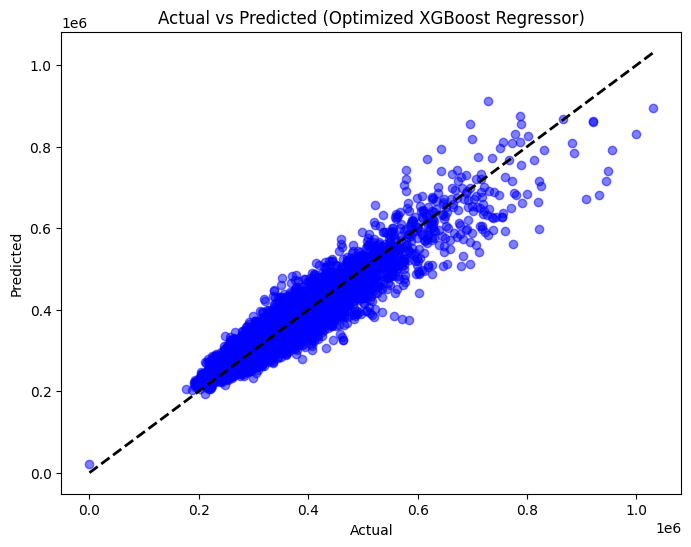

In [ ]:
from sklearn.model_selection import GridSearchCV
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Define the parameter grid for GridSearchCV
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0]
}

# Initialize the XGBoost Regressor
xgb_reg = XGBRegressor(random_state=42)

# Set up GridSearchCV
grid_search = GridSearchCV(estimator=xgb_reg, param_grid=param_grid,
                           scoring='neg_mean_squared_error', cv=5, n_jobs=-1, verbose=2)

# Fit GridSearchCV to the training data
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print("Best Parameters:", grid_search.best_params_)
print("Best Score (negative MSE):", grid_search.best_score_)

# Use the best estimator for predictions
best_xgb_reg = grid_search.best_estimator_

# Make predictions on the training and test sets
y_train_pred = best_xgb_reg.predict(X_train)
y_test_pred = best_xgb_reg.predict(X_test)

# Print model performance for the training set
print("\n### XGBoost Regressor Model Performance (Training Set) ###\n")
print("R²:", r2_score(y_train, y_train_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train, y_train_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_train, y_train_pred))

# Print model performance for the test set
print("\n### XGBoost Regressor Model Performance (Test Set) ###\n")
print("R²:", r2_score(y_test, y_test_pred))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_test_pred))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_test_pred))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_test_pred, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Optimized XGBoost Regressor)')
plt.show()


In [ ]:
import lime
import lime.lime_tabular
import numpy as np

# Initialize the LIME explainer for the optimized XGBoost Regressor
explainer_xgb_tuned = lime.lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train),
    feature_names=X.columns,  # Ensure this matches the original feature names used for training
    mode='regression'
)

# Choose a random instance from the test set to explain (modify index as needed)
instance_index_xgb_tuned = 5
instance_to_explain_xgb_tuned = X_test.iloc[instance_index_xgb_tuned].values.reshape(1, -1)

# Explain the prediction for the selected instance using LIME for the optimized XGBoost model
exp_xgb_tuned = explainer_xgb_tuned.explain_instance(
    data_row=X_test.iloc[instance_index_xgb_tuned],
    predict_fn=best_xgb_reg.predict  # Using the optimized XGBoost model
)

# Display the explanation in notebook or console
exp_xgb_tuned.show_in_notebook(show_table=True)


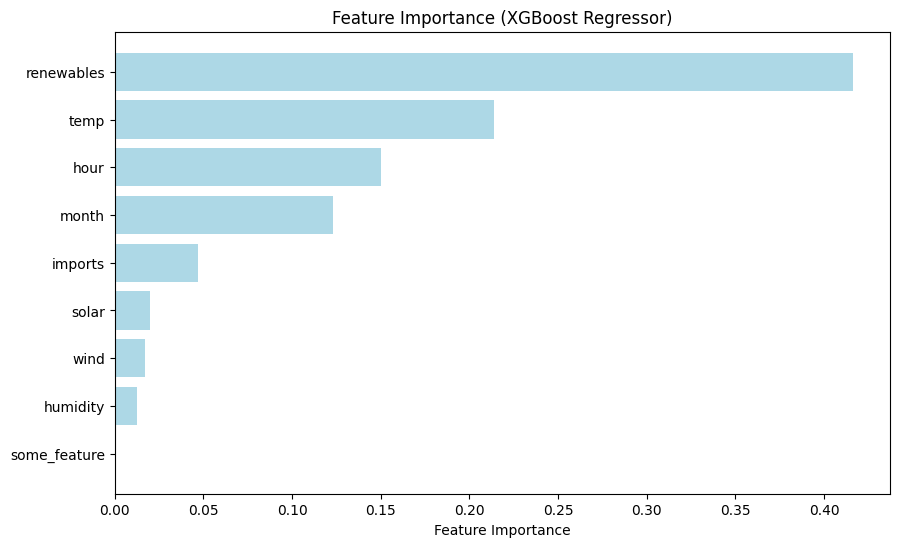

In [ ]:
# Get feature importances from the XGBoost Regressor
importances = best_xgb_reg.feature_importances_

# Sort the feature importances in descending order
indices = np.argsort(importances)[::-1]

# Get the feature names
feature_names = X.columns

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.barh(range(len(importances)), importances[indices], align='center', color='lightblue')
plt.yticks(range(len(importances)), [feature_names[i] for i in indices])
plt.xlabel('Feature Importance')
plt.title('Feature Importance (XGBoost Regressor)')
plt.gca().invert_yaxis()  # Invert y-axis for better readability
plt.show()


###Extratrees and AdaBoost Regressor


Extra Trees Regressor - Training Data: Mean Squared Error: 0.0000, R² Score: 1.0000
Extra Trees Regressor - Test Data: Mean Squared Error: 675560388.9322, R² Score: 0.9040

AdaBoost Regressor - Training Data: Mean Squared Error: 3214575950.3965, R² Score: 0.5536
AdaBoost Regressor - Test Data: Mean Squared Error: 3233958559.3477, R² Score: 0.5406


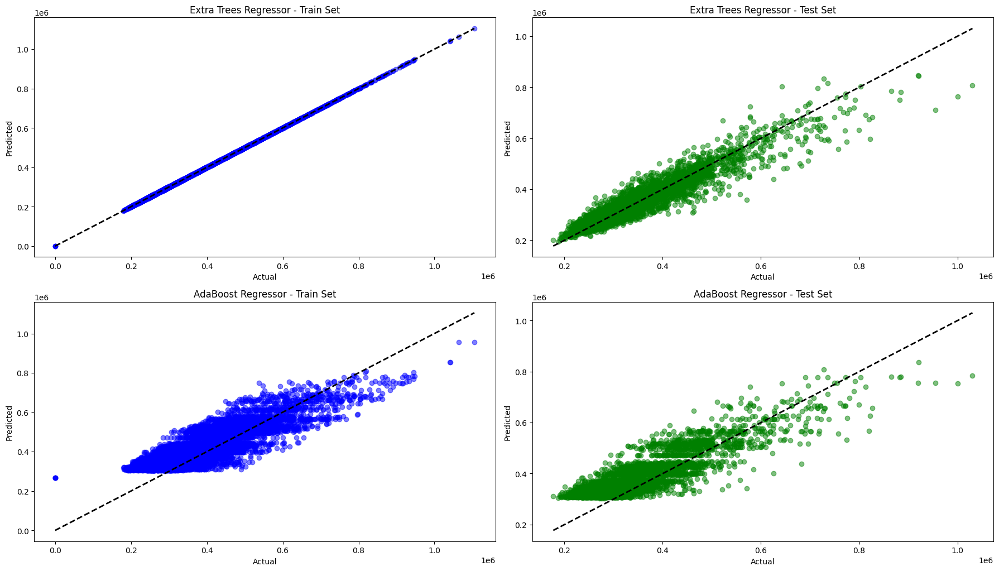

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor, AdaBoostRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Step 2: Data Preparation - Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define a function to evaluate and display metrics
def evaluate_model(model, X, y):
    y_pred = model.predict(X)
    mse = mean_squared_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    return mse, r2, y_pred

# Step 3: Initialize ensemble models (without hyperparameter tuning)
ensemble_models = {
    'Extra Trees Regressor': ExtraTreesRegressor(random_state=42),
    'AdaBoost Regressor': AdaBoostRegressor(random_state=42)
}

# Step 4: Train, evaluate, and plot results for each model
plt.figure(figsize=(18, 15))

for i, (model_name, model) in enumerate(ensemble_models.items(), 1):
    # Train model
    model.fit(X_train, y_train)

    # Evaluate on training data
    train_mse, train_r2, y_train_pred = evaluate_model(model, X_train, y_train)

    # Evaluate on testing data
    test_mse, test_r2, y_test_pred = evaluate_model(model, X_test, y_test)

    # Print model performance metrics
    print(f"\n{model_name} - Training Data: Mean Squared Error: {train_mse:.4f}, R² Score: {train_r2:.4f}")
    print(f"{model_name} - Test Data: Mean Squared Error: {test_mse:.4f}, R² Score: {test_r2:.4f}")

    # Plot actual vs predicted values for train and test sets
    plt.subplot(3, 2, 2*i - 1)
    plt.scatter(y_train, y_train_pred, color='blue', alpha=0.5)
    plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title(f'{model_name} - Train Set')

    plt.subplot(3, 2, 2*i)
    plt.scatter(y_test, y_test_pred, color='green', alpha=0.5)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title(f'{model_name} - Test Set')

plt.tight_layout()
plt.show()


**Tuning extratree regressor and AdaBoost Regressor**

Tuning Extra Trees Regressor...
Fitting 3 folds for each of 5 candidates, totalling 15 fits

Extra Trees Regressor - Best Parameters: {'n_estimators': 100, 'min_samples_split': 5, 'max_depth': None}
Extra Trees Regressor - Training Data: Mean Squared Error: 56390998.4344, R² Score: 0.9922
Extra Trees Regressor - Test Data: Mean Squared Error: 672425467.8736, R² Score: 0.9045
Tuning AdaBoost Regressor...
Fitting 3 folds for each of 5 candidates, totalling 15 fits

AdaBoost Regressor - Best Parameters: {'n_estimators': 100, 'loss': 'linear', 'learning_rate': 0.1}
AdaBoost Regressor - Training Data: Mean Squared Error: 2026159881.5312, R² Score: 0.7186
AdaBoost Regressor - Test Data: Mean Squared Error: 2022228768.4061, R² Score: 0.7127


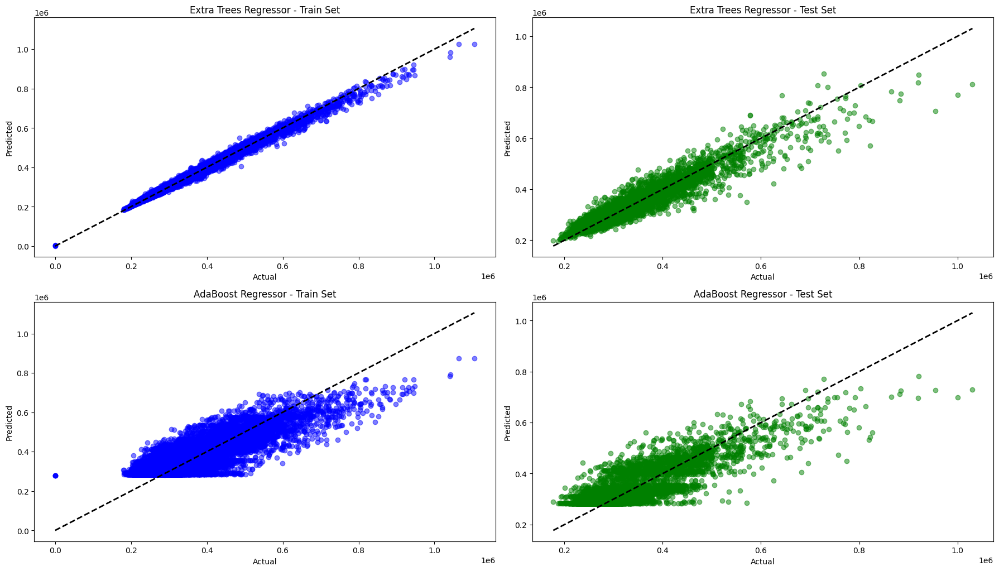

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor, AdaBoostRegressor
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Step 2: Data Preparation - Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define a function to evaluate and display metrics
def evaluate_model(model, X, y):
    y_pred = model.predict(X)
    mse = mean_squared_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    return mse, r2, y_pred

# Hyperparameter grids for tuning each model (reduced for quicker execution)
param_grids = {
    'Extra Trees Regressor': {
        'n_estimators': [50, 100],
        'max_depth': [10, None],
        'min_samples_split': [2, 5]
    },
    'AdaBoost Regressor': {
        'n_estimators': [50, 100],
        'learning_rate': [0.01, 0.1],
        'loss': ['linear', 'square']
    }
}

# Step 3: Initialize models for tuning and plotting
tuned_models = {}
plt.figure(figsize=(18, 15))

for i, (model_name, model) in enumerate([
    ('Extra Trees Regressor', ExtraTreesRegressor(random_state=42)),
    ('AdaBoost Regressor', AdaBoostRegressor(random_state=42))
]):
    print(f"Tuning {model_name}...")

    # Randomized search with cross-validation (reduced n_iter for faster execution)
    randomized_search = RandomizedSearchCV(
        estimator=model,
        param_distributions=param_grids[model_name],
        n_iter=5,  # Reduced number of random combinations
        cv=3,  # 3-fold cross-validation
        verbose=1,
        random_state=42,
        n_jobs=-1  # Use all available cores
    )

    # Fit the randomized search
    randomized_search.fit(X_train, y_train)

    # Get the best model after tuning
    best_model = randomized_search.best_estimator_
    tuned_models[model_name] = best_model

    # Step 4: Evaluate the best model on both training and test sets
    train_mse, train_r2, y_train_pred = evaluate_model(best_model, X_train, y_train)
    test_mse, test_r2, y_test_pred = evaluate_model(best_model, X_test, y_test)

    # Print model performance metrics
    print(f"\n{model_name} - Best Parameters: {randomized_search.best_params_}")
    print(f"{model_name} - Training Data: Mean Squared Error: {train_mse:.4f}, R² Score: {train_r2:.4f}")
    print(f"{model_name} - Test Data: Mean Squared Error: {test_mse:.4f}, R² Score: {test_r2:.4f}")

    # Plot actual vs predicted values for train and test sets
    plt.subplot(3, 2, 2*i + 1)
    plt.scatter(y_train, y_train_pred, color='blue', alpha=0.5)
    plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title(f'{model_name} - Train Set')

    plt.subplot(3, 2, 2*i + 2)
    plt.scatter(y_test, y_test_pred, color='green', alpha=0.5)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.title(f'{model_name} - Test Set')

plt.tight_layout()
plt.show()


### final conclusion

**1. Random Forest model:**
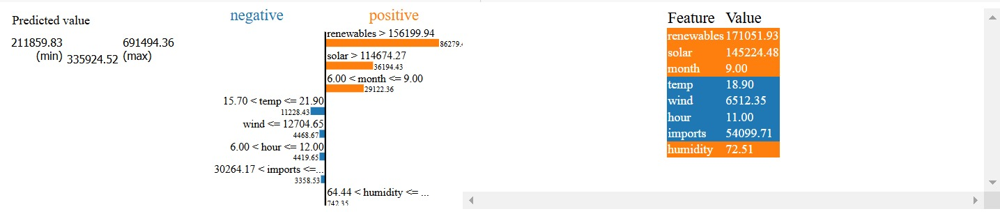

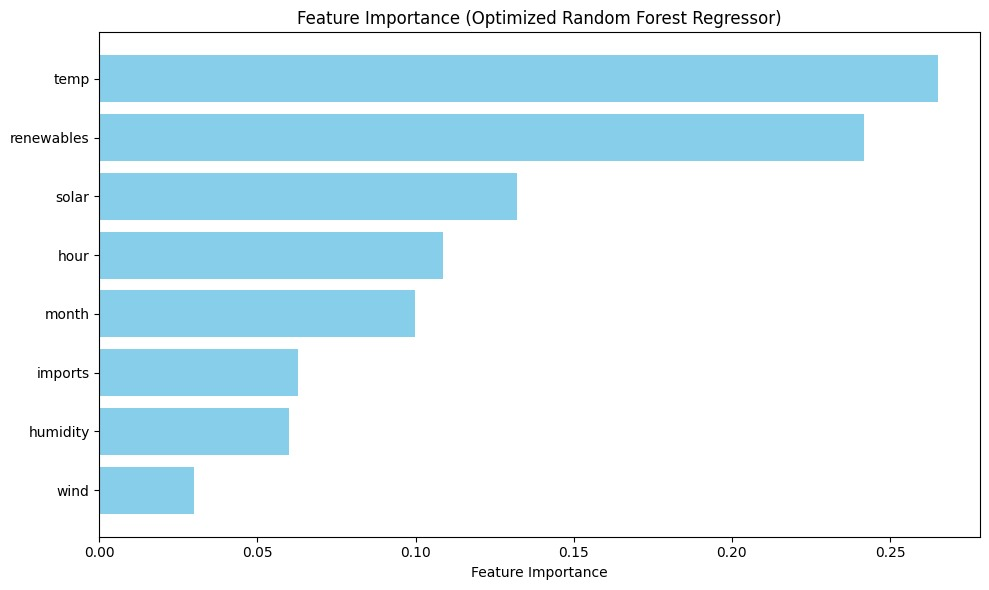

**2. Xboost model:**
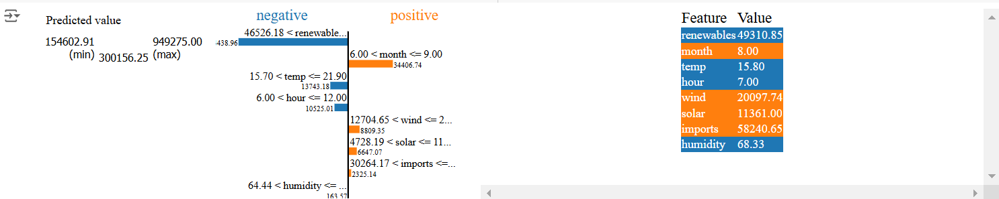




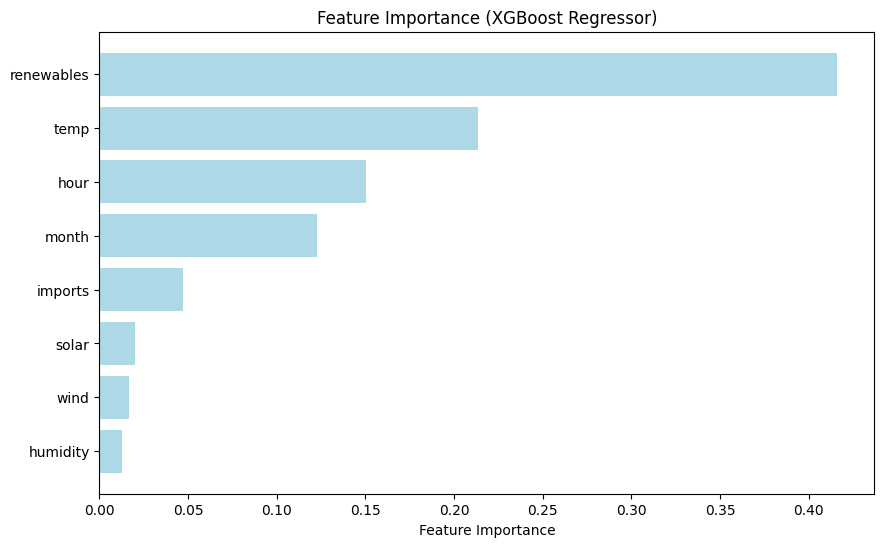




#### Feature Importance Analysis
1. *Temperature*:
   - For the Random Forest model, *temperature* is the most influential feature affecting electricity demand. During peak load seasons, temperature significantly impacts the demand as people rely heavily on heating or cooling systems. High or low temperatures directly lead to increased usage of air conditioners or heating, which in turn drives up electricity demand.

2. *Renewables*:
   - In both Random Forest and XGBoost models, *renewable energy* generation plays a crucial role. The availability of renewable sources like solar and wind impacts how much of the demand is met through these sources. During times when renewables are high, dependence on other energy sources may reduce, thereby affecting the load profile and electricity demand dynamics.

3. *Solar Energy*:
   - *Solar energy* also ranks highly in terms of feature importance, particularly in the Random Forest model. During peak load seasons, solar generation contributes significantly to meeting electricity demand during daylight hours, helping mitigate peak loads. However, the variability in solar energy, due to weather conditions, means that electricity demand patterns can shift when solar availability changes.

4. *Hour and Month*:
   - The *time of day (hour)* and *month* are also critical drivers. The Random Forest model shows that certain hours of the day (likely mornings and evenings) have higher electricity demand, driven by typical consumer behaviors such as cooking, lighting, and heating or cooling usage. Similarly, peak load conditions vary by *month*, indicating seasonal impacts—typically, summer or winter months have higher demand compared to spring or fall.

5. *Humidity and Wind*:
   - *Humidity* and *wind* have relatively lower feature importance in both models, but they still play roles. High humidity may increase cooling demand, whereas wind energy can contribute to meeting demand, thus reducing the need for non-renewable sources during windy periods.

### LIME Analysis for Random Forest and XGBoost Models
The LIME explanations help us understand the contribution of features for individual predictions:
- For a specific instance of the Random Forest model, *renewables* and *solar energy* positively influenced the prediction of higher electricity demand, indicating that on that particular day, higher renewable availability was associated with higher predicted demand.
- *Temperature* was also a significant factor in the instance analyzed, suggesting that on days when temperatures are between certain ranges (e.g., 15.7°C to 21.9°C), electricity demand is significantly affected.
- In the XGBoost model, *renewables, **month, and **hour* were found to have a major impact on the predicted demand. For example, during months like *August* (summer) and specific times of the day, demand peaks due to increased usage of cooling appliances.

### Summary
- *Key Drivers: The key drivers that significantly impact electricity demand during peak load seasons are **temperature, **renewables, **solar energy, **time of day (hour), and **month*.
- *Weather Conditions Influence: **Temperature* and *humidity* affect the demand by influencing heating and cooling requirements, while *wind* and *solar energy* influence the available energy supply, especially during peak load conditions.
- *Energy Generation Factors: **Renewables* and *imports* are crucial in determining how much of the demand is met through sustainable sources versus non-renewable imports.

Together, these factors explain how both weather conditions and energy generation characteristics affect electricity demand during peak load seasons, providing insight into which variables are most influential in shaping demand profiles.

##Research Question 2

How can the risk of consecutive days with low renewable energy generation
be effectively predicted based on weather patterns, and what measures can be implemented to
maintain reliability during such events?


In [ ]:
data_final['combined_renewables'] = data_final['solar'] + data_final['renewables'] + data_final['wind']


In [ ]:
features_q2 = ['temp', 'humidity', 'windspeed', 'solarenergy', 'cloudcover', 'large hydro', 'imports','hour','month']
target_q2 = 'combined_renewables'  # Target variable for predicting renewable energy generation

X_q2 = data_final[features_q2]
y_q2 = data_final[target_q2]

###Linear Regression


### Linear Regression Model Performance for Question 2 ###
Training Data - Mean Squared Error (MSE): 10338052280.1086, R² Score: 0.6451
Test Data - Mean Squared Error (MSE): 10256835737.0424, R² Score: 0.6451


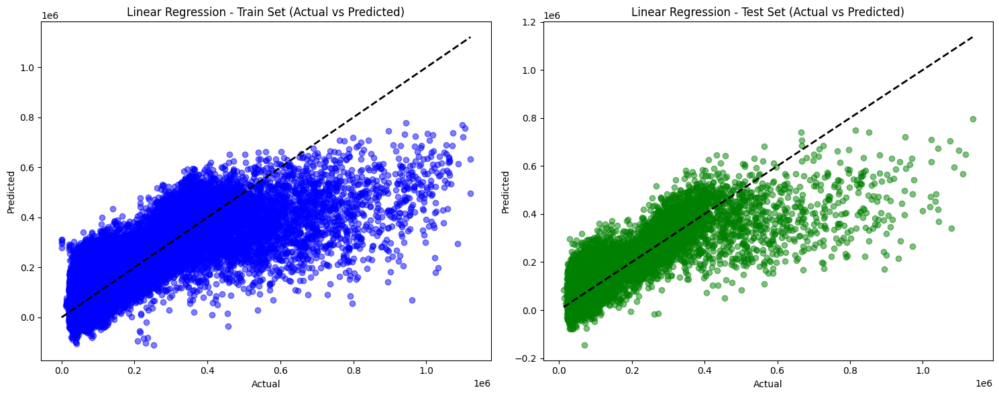

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

# Assuming X_q2 and y_q2 are defined earlier in your code

# Step 1: Train-test Split for Linear Regression
X_train_q2, X_test_q2, y_train_q2, y_test_q2 = train_test_split(X_q2, y_q2, test_size=0.2, random_state=42)

# Step 2: Model Training - Linear Regression
linear_model_q2 = LinearRegression()
linear_model_q2.fit(X_train_q2, y_train_q2)

# Step 3: Model Evaluation on Training Data
y_train_pred_q2 = linear_model_q2.predict(X_train_q2)
train_q2_mse = mean_squared_error(y_train_q2, y_train_pred_q2)
train_q2_r2 = r2_score(y_train_q2, y_train_pred_q2)

# Step 4: Model Evaluation on Test Data
y_test_pred_q2 = linear_model_q2.predict(X_test_q2)
test_q2_mse = mean_squared_error(y_test_q2, y_test_pred_q2)
test_q2_r2 = r2_score(y_test_q2, y_test_pred_q2)

# Display evaluation metrics for Linear Regression model (Train and Test)
print("\n### Linear Regression Model Performance for Question 2 ###")
print(f"Training Data - Mean Squared Error (MSE): {train_q2_mse:.4f}, R² Score: {train_q2_r2:.4f}")
print(f"Test Data - Mean Squared Error (MSE): {test_q2_mse:.4f}, R² Score: {test_q2_r2:.4f}")

# Step 5: Plotting Actual vs Predicted for Train and Test Sets
plt.figure(figsize=(15, 6))

# Plot for Training Data
plt.subplot(1, 2, 1)
plt.scatter(y_train_q2, y_train_pred_q2, color='blue', alpha=0.5)
plt.plot([y_train_q2.min(), y_train_q2.max()], [y_train_q2.min(), y_train_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Linear Regression - Train Set (Actual vs Predicted)')

# Plot for Test Data
plt.subplot(1, 2, 2)
plt.scatter(y_test_q2, y_test_pred_q2, color='green', alpha=0.5)
plt.plot([y_test_q2.min(), y_test_q2.max()], [y_test_q2.min(), y_test_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Linear Regression - Test Set (Actual vs Predicted)')

plt.tight_layout()
plt.show()


###Reidge and Lasso Regression

In [ ]:
from sklearn.linear_model import Ridge, Lasso

# Step 1: Train Ridge Regression Model
ridge_model_q2 = Ridge(alpha=1.0)
ridge_model_q2.fit(X_train_q2, y_train_q2)

# Step 2: Train Lasso Regression Model
lasso_model_q2 = Lasso(alpha=1.0)
lasso_model_q2.fit(X_train_q2, y_train_q2)

# Step 3: Evaluation - Ridge Regression
y_train_pred_ridge_q2 = ridge_model_q2.predict(X_train_q2)
y_test_pred_ridge_q2 = ridge_model_q2.predict(X_test_q2)
train_ridge_q2_mse = mean_squared_error(y_train_q2, y_train_pred_ridge_q2)
train_ridge_q2_r2 = r2_score(y_train_q2, y_train_pred_ridge_q2)
test_ridge_q2_mse = mean_squared_error(y_test_q2, y_test_pred_ridge_q2)
test_ridge_q2_r2 = r2_score(y_test_q2, y_test_pred_ridge_q2)

# Step 4: Evaluation - Lasso Regression
y_train_pred_lasso_q2 = lasso_model_q2.predict(X_train_q2)
y_test_pred_lasso_q2 = lasso_model_q2.predict(X_test_q2)
train_lasso_q2_mse = mean_squared_error(y_train_q2, y_train_pred_lasso_q2)
train_lasso_q2_r2 = r2_score(y_train_q2, y_train_pred_lasso_q2)
test_lasso_q2_mse = mean_squared_error(y_test_q2, y_test_pred_lasso_q2)
test_lasso_q2_r2 = r2_score(y_test_q2, y_test_pred_lasso_q2)




### Ridge Regression Model Performance for Question 2 ###
Training Data - Mean Squared Error (MSE): 10338052280.6298, R² Score: 0.6451
Test Data - Mean Squared Error (MSE): 10256837714.1335, R² Score: 0.6451

### Lasso Regression Model Performance for Question 2 ###
Training Data - Mean Squared Error (MSE): 10338052282.0745, R² Score: 0.6451
Test Data - Mean Squared Error (MSE): 10256839877.1850, R² Score: 0.6451


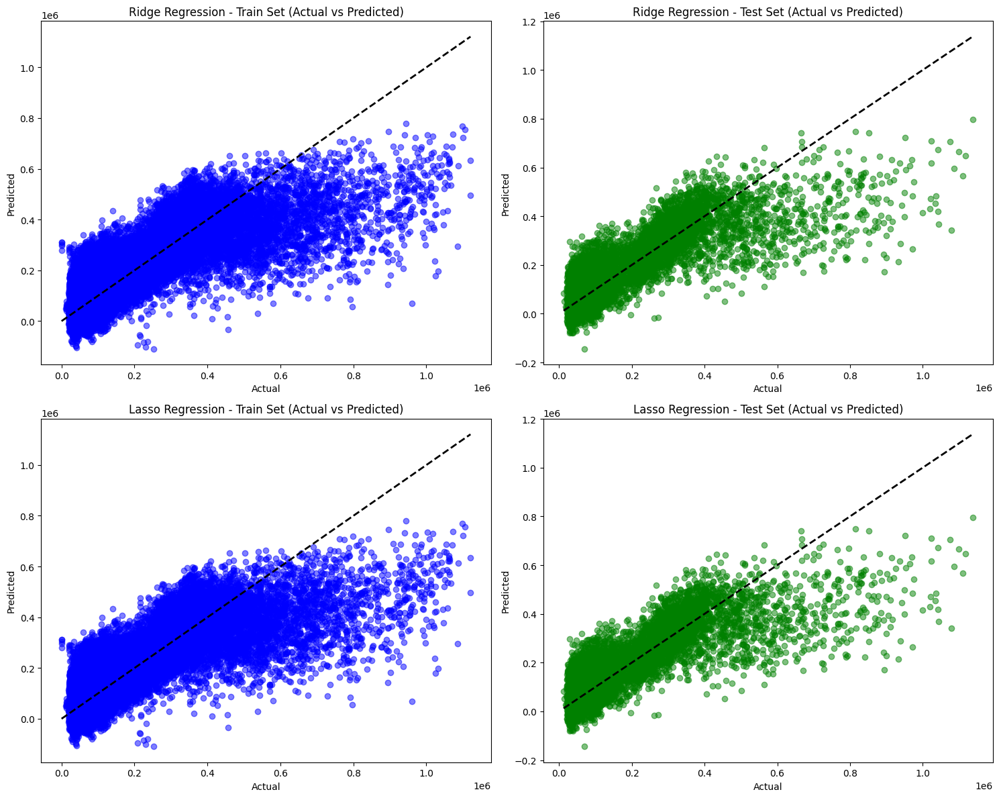

In [ ]:
import matplotlib.pyplot as plt

# Step 1: Display evaluation metrics for Ridge Regression model
print("\n### Ridge Regression Model Performance for Question 2 ###")
print(f"Training Data - Mean Squared Error (MSE): {train_ridge_q2_mse:.4f}, R² Score: {train_ridge_q2_r2:.4f}")
print(f"Test Data - Mean Squared Error (MSE): {test_ridge_q2_mse:.4f}, R² Score: {test_ridge_q2_r2:.4f}")

# Step 2: Display evaluation metrics for Lasso Regression model
print("\n### Lasso Regression Model Performance for Question 2 ###")
print(f"Training Data - Mean Squared Error (MSE): {train_lasso_q2_mse:.4f}, R² Score: {train_lasso_q2_r2:.4f}")
print(f"Test Data - Mean Squared Error (MSE): {test_lasso_q2_mse:.4f}, R² Score: {test_lasso_q2_r2:.4f}")

# Step 3: Plotting Actual vs Predicted for Ridge and Lasso Regression models
plt.figure(figsize=(15, 12))

# Ridge Regression - Training Data
plt.subplot(2, 2, 1)
plt.scatter(y_train_q2, y_train_pred_ridge_q2, color='blue', alpha=0.5)
plt.plot([y_train_q2.min(), y_train_q2.max()], [y_train_q2.min(), y_train_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Ridge Regression - Train Set (Actual vs Predicted)')

# Ridge Regression - Test Data
plt.subplot(2, 2, 2)
plt.scatter(y_test_q2, y_test_pred_ridge_q2, color='green', alpha=0.5)
plt.plot([y_test_q2.min(), y_test_q2.max()], [y_test_q2.min(), y_test_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Ridge Regression - Test Set (Actual vs Predicted)')

# Lasso Regression - Training Data
plt.subplot(2, 2, 3)
plt.scatter(y_train_q2, y_train_pred_lasso_q2, color='blue', alpha=0.5)
plt.plot([y_train_q2.min(), y_train_q2.max()], [y_train_q2.min(), y_train_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Lasso Regression - Train Set (Actual vs Predicted)')

# Lasso Regression - Test Data
plt.subplot(2, 2, 4)
plt.scatter(y_test_q2, y_test_pred_lasso_q2, color='green', alpha=0.5)
plt.plot([y_test_q2.min(), y_test_q2.max()], [y_test_q2.min(), y_test_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Lasso Regression - Test Set (Actual vs Predicted)')

plt.tight_layout()
plt.show()


###Random forest regressor

Random Forest Regressor - Train MSE: 460003459.37270766 Train R²: 0.9842084307982896
Random Forest Regressor - Test MSE: 3185256407.837561 Test R²: 0.8897815776967615


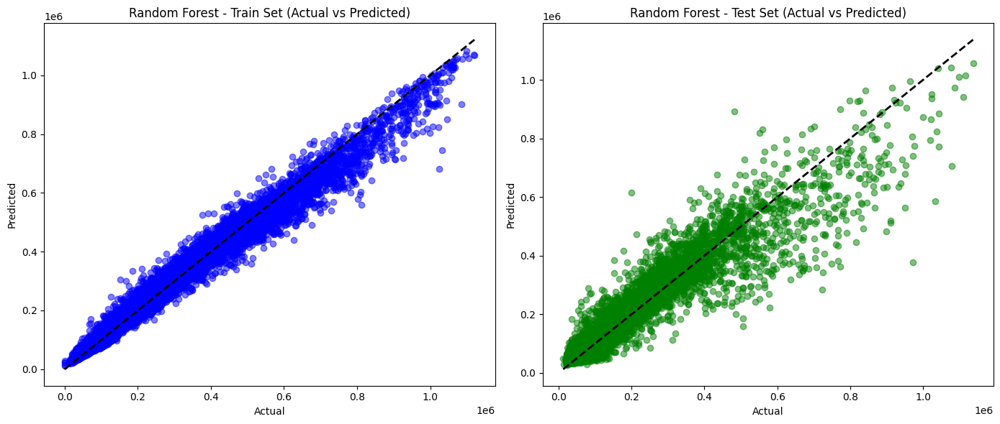

In [ ]:
import matplotlib.pyplot as plt

# Step 1: Model Training - Random Forest Regressor for Predicting Renewable Energy Generation
rf_regressor_q2 = RandomForestRegressor(n_estimators=100, random_state=42)
rf_regressor_q2.fit(X_train_q2, y_train_q2)

# Step 2: Model Evaluation on Training Data
y_train_pred_rf_q2 = rf_regressor_q2.predict(X_train_q2)
train_rf_q2_mse = mean_squared_error(y_train_q2, y_train_pred_rf_q2)
train_rf_q2_r2 = r2_score(y_train_q2, y_train_pred_rf_q2)
print("Random Forest Regressor - Train MSE:", train_rf_q2_mse, "Train R²:", train_rf_q2_r2)

# Step 3: Model Evaluation on Test Data
y_test_pred_rf_q2 = rf_regressor_q2.predict(X_test_q2)
test_rf_q2_mse = mean_squared_error(y_test_q2, y_test_pred_rf_q2)
test_rf_q2_r2 = r2_score(y_test_q2, y_test_pred_rf_q2)
print("Random Forest Regressor - Test MSE:", test_rf_q2_mse, "Test R²:", test_rf_q2_r2)

# Step 4: Plotting Actual vs Predicted for Training and Test Data
plt.figure(figsize=(14, 6))

# Training Set Plot
plt.subplot(1, 2, 1)
plt.scatter(y_train_q2, y_train_pred_rf_q2, color='blue', alpha=0.5)
plt.plot([y_train_q2.min(), y_train_q2.max()], [y_train_q2.min(), y_train_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Random Forest - Train Set (Actual vs Predicted)')

# Test Set Plot
plt.subplot(1, 2, 2)
plt.scatter(y_test_q2, y_test_pred_rf_q2, color='green', alpha=0.5)
plt.plot([y_test_q2.min(), y_test_q2.max()], [y_test_q2.min(), y_test_q2.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Random Forest - Test Set (Actual vs Predicted)')

plt.tight_layout()
plt.show()


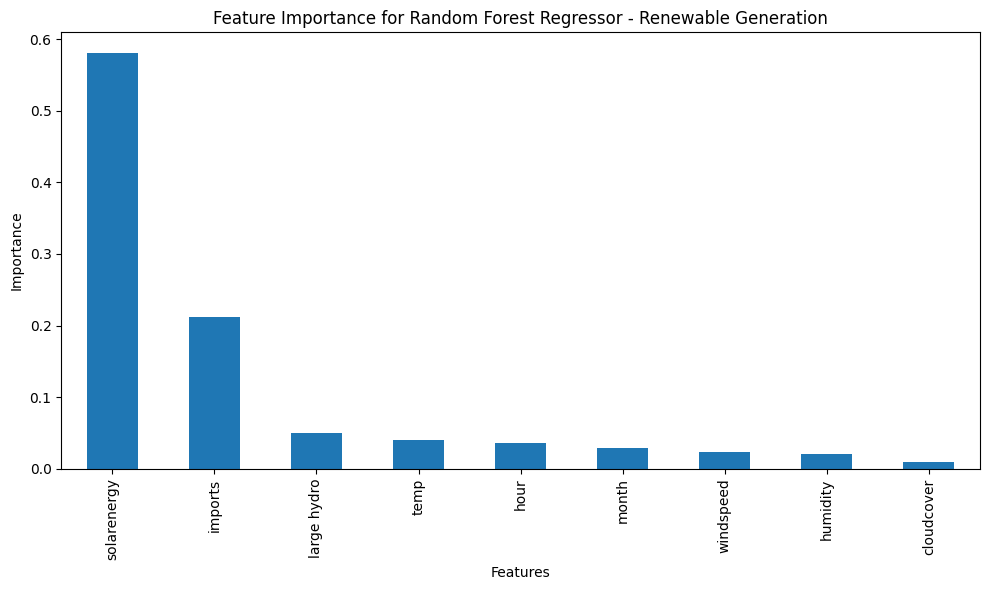

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Extract and plot feature importances
feature_importances_rf_q2 = pd.Series(rf_regressor_q2.feature_importances_, index=features_q2)
feature_importances_rf_q2.sort_values(ascending=False).plot(kind='bar', figsize=(10, 6))
plt.title('Feature Importance for Random Forest Regressor - Renewable Generation')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.tight_layout()
plt.show()


**Tuning random forest regressor**


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_squared_error, r2_score

# Step 1: Define a further reduced hyperparameter grid for Random Forest Regressor
param_dist_rf_reduced = {
    'n_estimators': [100, 150],                       # Reduced number of trees to minimize training time
    'max_depth': [5, 10],                             # Limited max depth options for faster training
    'min_samples_split': [5],                         # Reduced options for splitting to reduce variability
    'min_samples_leaf': [2],                          # Reduced number of leaf nodes
    'max_features': ['sqrt']                          # Limited options for max features
}

# Step 2: Set up RandomizedSearchCV with further reduced parameters
random_search_rf_reduced = RandomizedSearchCV(
    RandomForestRegressor(random_state=42),
    param_distributions=param_dist_rf_reduced,
    n_iter=5,                                         # Reduced number of iterations for quicker tuning
    cv=2,                                             # Reduced number of cross-validation folds
    scoring='r2',
    random_state=42,
    n_jobs=-1                                         # Use all available processors for parallelization
)

# Step 3: Fit the model using RandomizedSearchCV (Reduced Parameters)
random_search_rf_reduced.fit(X_train_q2, y_train_q2)

# Step 4: Get the best parameters and evaluate the best model
best_params_rf_reduced = random_search_rf_reduced.best_params_
best_rf_model_reduced = random_search_rf_reduced.best_estimator_

print("Best Parameters for Random Forest Regressor (Reduced Search):", best_params_rf_reduced)

# Step 5: Evaluate the best Random Forest model on training data
y_train_pred_best_rf_reduced = best_rf_model_reduced.predict(X_train_q2)
train_best_rf_reduced_mse = mean_squared_error(y_train_q2, y_train_pred_best_rf_reduced)
train_best_rf_reduced_r2 = r2_score(y_train_q2, y_train_pred_best_rf_reduced)

print("Best Random Forest Model - Train MSE:", train_best_rf_reduced_mse, "Train R²:", train_best_rf_reduced_r2)

# Step 6: Evaluate the best Random Forest model on test data
y_test_pred_best_rf_reduced = best_rf_model_reduced.predict(X_test_q2)
test_best_rf_reduced_mse = mean_squared_error(y_test_q2, y_test_pred_best_rf_reduced)
test_best_rf_reduced_r2 = r2_score(y_test_q2, y_test_pred_best_rf_reduced)

print("Best Random Forest Model - Test MSE:", test_best_rf_reduced_mse, "Test R²:", test_best_rf_reduced_r2)


Best Parameters for Random Forest Regressor (Reduced Search): {'n_estimators': 100, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'max_depth': 10}
Best Random Forest Model - Train MSE: 3260290060.5959954 Train R²: 0.8880767197278059
Best Random Forest Model - Test MSE: 4045553512.058421 Test R²: 0.8600129884849308


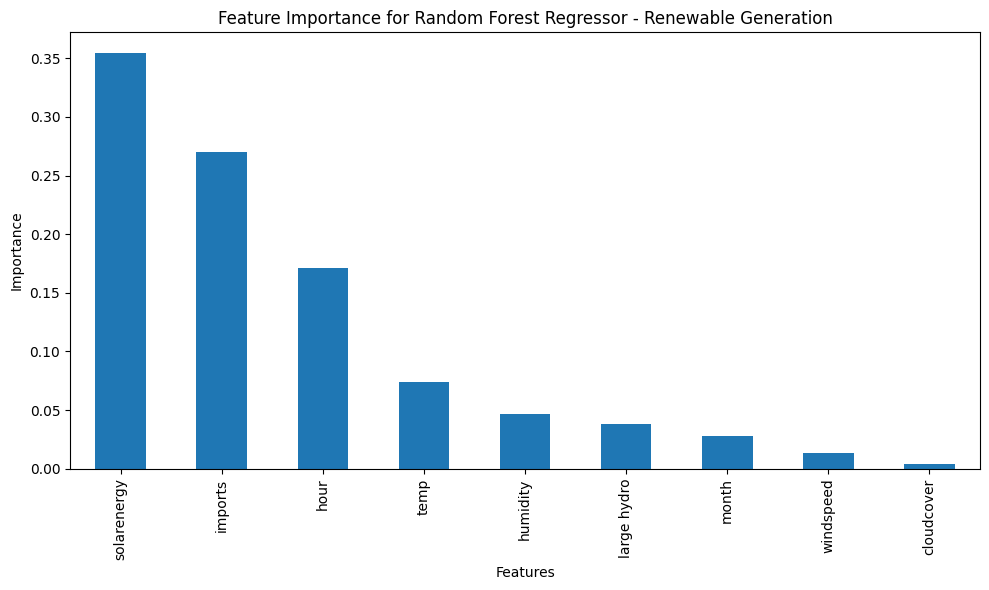

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Step 1: Extract Feature Importances from the Tuned Random Forest Model
feature_importances_rf_q2 = pd.Series(best_rf_model_reduced.feature_importances_, index=features_q2)

# Step 2: Plot Feature Importances
plt.figure(figsize=(10, 6))
feature_importances_rf_q2.sort_values(ascending=False).plot(kind='bar')
plt.title('Feature Importance for Random Forest Regressor - Renewable Generation')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.tight_layout()
plt.show()




In [ ]:
# LIME Explanation for Random Forest Regressor Model
explainer = lime.lime_tabular.LimeTabularExplainer(X_train_q2.values,
                                                   feature_names=X_train_q2.columns,
                                                   mode='regression')

# Explain a single prediction
i = 10  # Index of the sample to explain
explanation = explainer.explain_instance(X_test_q2.iloc[i].to_numpy(), best_rf_model_reduced.predict, num_features=10)
explanation.show_in_notebook()  # or explanation.as_pyplot_figure()

###Gradient boosting, XGboost, Extratrees, Adaboost, Bagging

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor, BaggingRegressor, ExtraTreesRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

# Step 2: Train-test Split for Ensemble Models
X_train_q2, X_test_q2, y_train_q2, y_test_q2 = train_test_split(X_q2, y_q2, test_size=0.2, random_state=42)

# Define a function to evaluate and display metrics
def evaluate_model(model, X_train, y_train, X_test, y_test):
    # Training predictions
    y_train_pred = model.predict(X_train)
    train_mse = mean_squared_error(y_train, y_train_pred)
    train_r2 = r2_score(y_train, y_train_pred)

    # Testing predictions
    y_test_pred = model.predict(X_test)
    test_mse = mean_squared_error(y_test, y_test_pred)
    test_r2 = r2_score(y_test, y_test_pred)

    return (train_mse, train_r2), (test_mse, test_r2)

# Step 3: Initialize ensemble models
ensemble_models_q2 = {
    'Gradient Boosting': GradientBoostingRegressor(random_state=42),
    'XGBoost': XGBRegressor(random_state=42),
    'Bagging Regressor': BaggingRegressor(random_state=42),
    'Extra Trees Regressor': ExtraTreesRegressor(random_state=42),
    'AdaBoost Regressor': AdaBoostRegressor(random_state=42)
}

# Step 4: Train and evaluate each ensemble model
for model_name, model in ensemble_models_q2.items():
    # Train the model
    model.fit(X_train_q2, y_train_q2)

    # Evaluate on training and test data
    (train_mse, train_r2), (test_mse, test_r2) = evaluate_model(model, X_train_q2, y_train_q2, X_test_q2, y_test_q2)

    # Display the evaluation results
    print(f"{model_name} - Training MSE: {train_mse:.4f}, R^2: {train_r2:.4f}")
    print(f"{model_name} - Testing MSE: {test_mse:.4f}, R^2: {test_r2:.4f}\n")

Gradient Boosting - Training MSE: 4509404239.0902, R^2: 0.8452
Gradient Boosting - Testing MSE: 4720400730.5635, R^2: 0.8367

XGBoost - Training MSE: 1681935338.7638, R^2: 0.9423
XGBoost - Testing MSE: 3212921495.7825, R^2: 0.8888

Bagging Regressor - Training MSE: 666015203.1636, R^2: 0.9771
Bagging Regressor - Testing MSE: 3525676007.6476, R^2: 0.8780

Extra Trees Regressor - Training MSE: 0.0000, R^2: 1.0000
Extra Trees Regressor - Testing MSE: 2847192129.1683, R^2: 0.9015

AdaBoost Regressor - Training MSE: 11380356493.5348, R^2: 0.6093
AdaBoost Regressor - Testing MSE: 11496977800.4558, R^2: 0.6022



Gradient Boosting - Training MSE: 4509404239.0902, R^2: 0.8452
Gradient Boosting - Testing MSE: 4720400730.5635, R^2: 0.8367



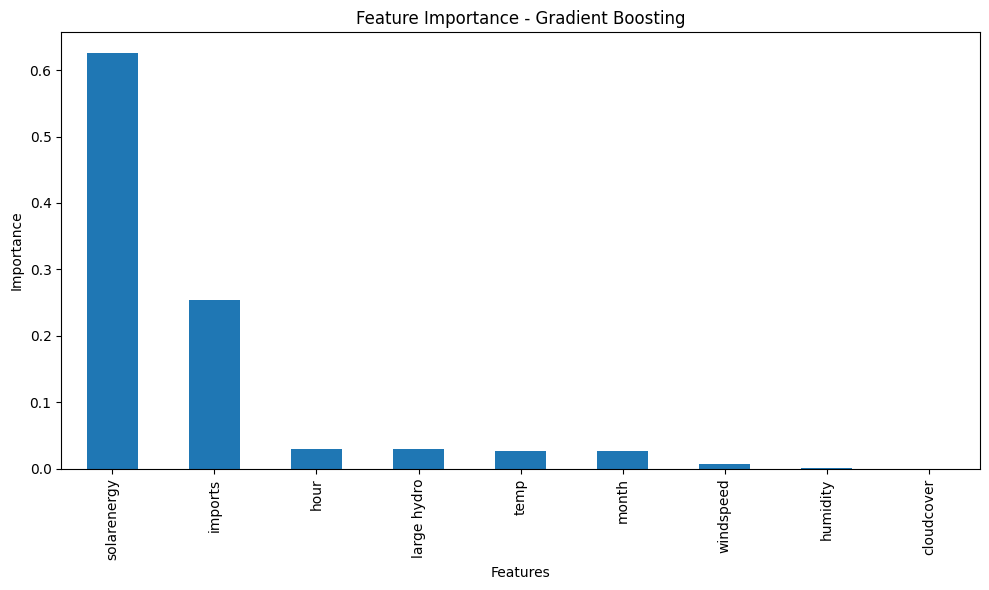

XGBoost - Training MSE: 1681935338.7638, R^2: 0.9423
XGBoost - Testing MSE: 3212921495.7825, R^2: 0.8888



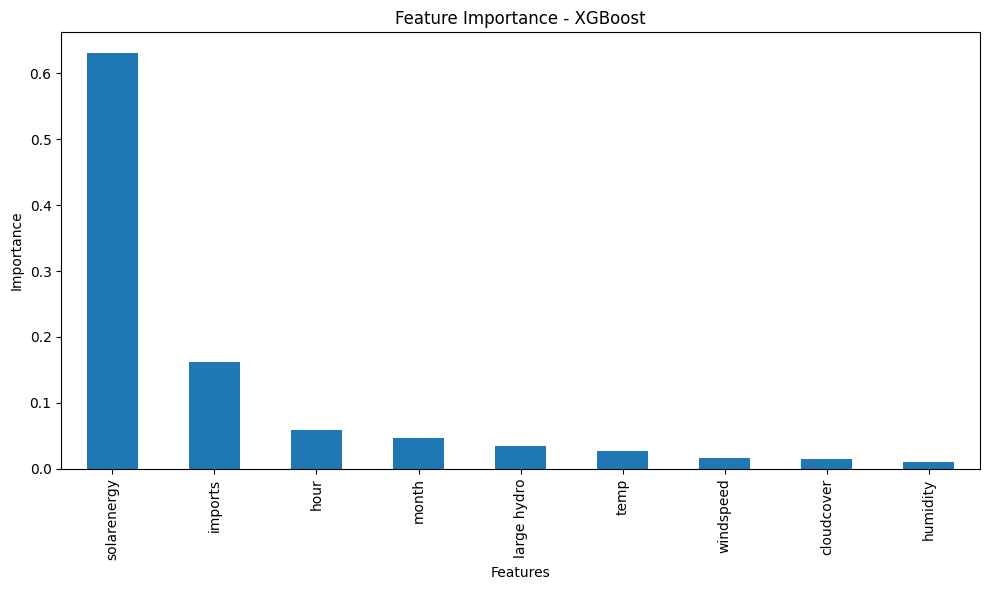

Bagging Regressor - Training MSE: 666015203.1636, R^2: 0.9771
Bagging Regressor - Testing MSE: 3525676007.6476, R^2: 0.8780



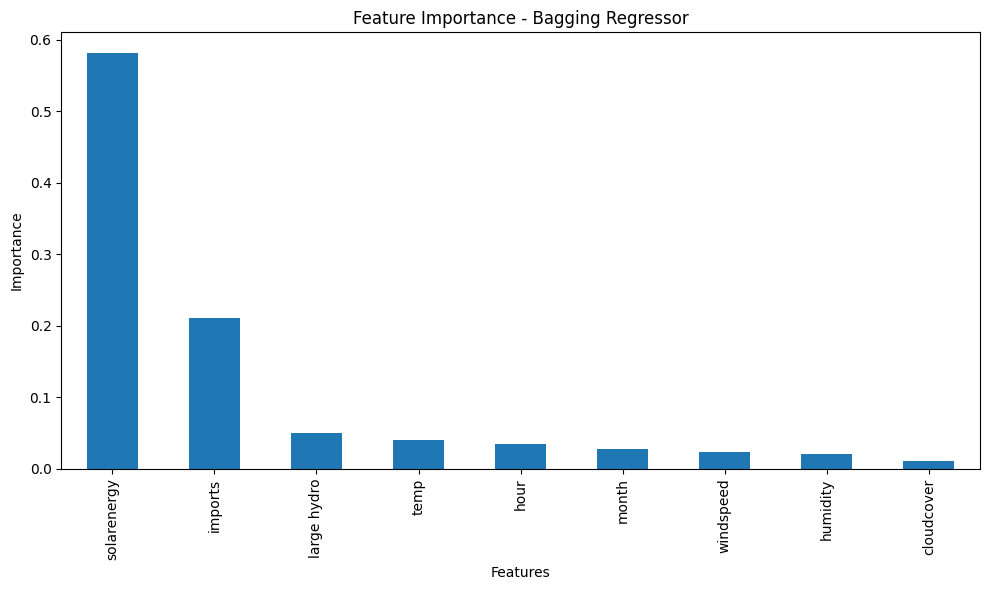

Extra Trees Regressor - Training MSE: 0.0000, R^2: 1.0000
Extra Trees Regressor - Testing MSE: 2847192129.1683, R^2: 0.9015



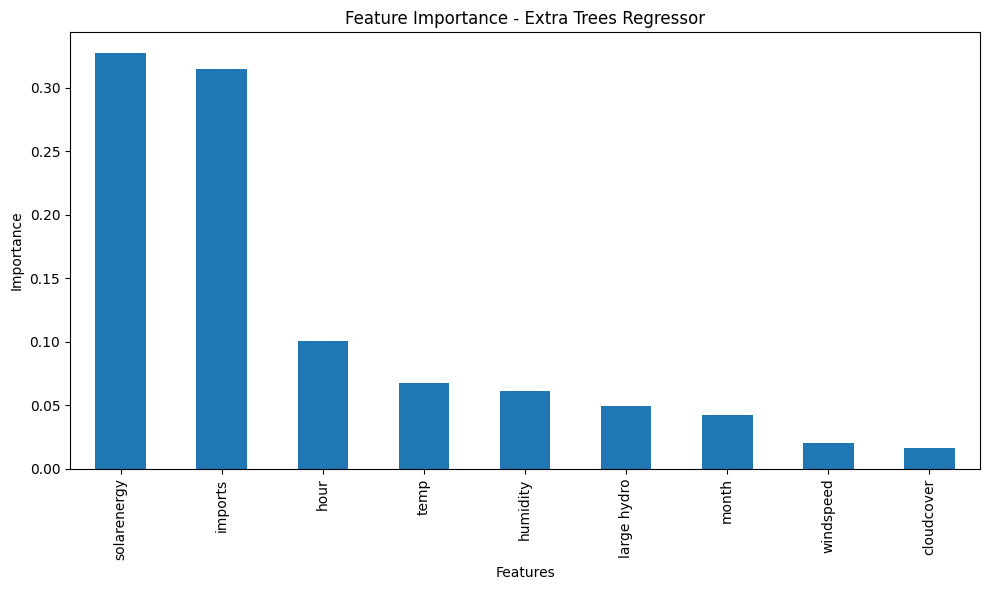

AdaBoost Regressor - Training MSE: 11380356493.5348, R^2: 0.6093
AdaBoost Regressor - Testing MSE: 11496977800.4558, R^2: 0.6022



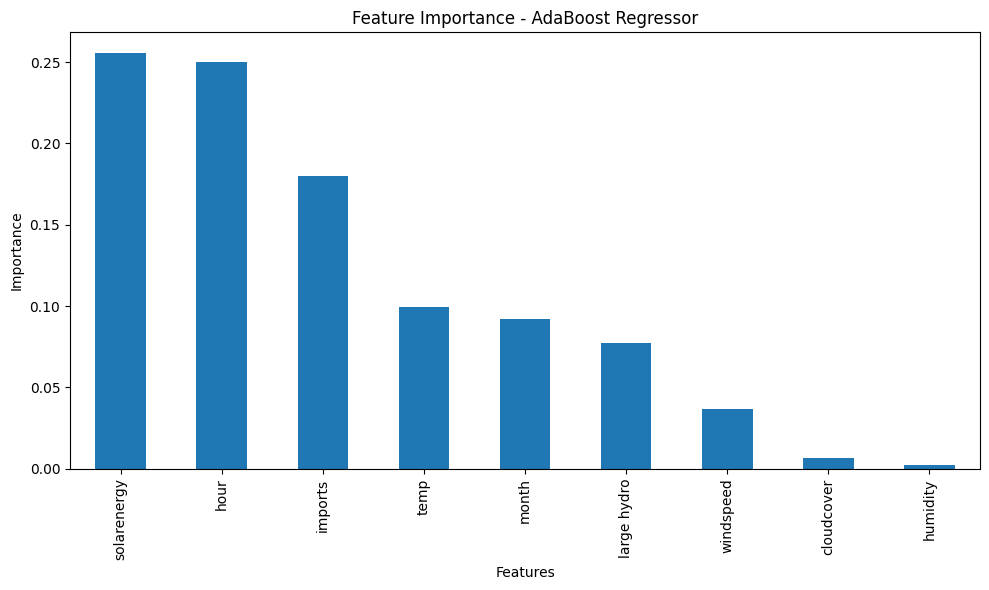

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Train and evaluate each ensemble model and calculate feature importance where applicable
for model_name, model in ensemble_models_q2.items():
    # Train the model
    model.fit(X_train_q2, y_train_q2)

    # Evaluate on training and test data
    (train_mse, train_r2), (test_mse, test_r2) = evaluate_model(model, X_train_q2, y_train_q2, X_test_q2, y_test_q2)

    # Display the evaluation results
    print(f"{model_name} - Training MSE: {train_mse:.4f}, R^2: {train_r2:.4f}")
    print(f"{model_name} - Testing MSE: {test_mse:.4f}, R^2: {test_r2:.4f}\n")

    # Feature importance extraction and plotting for models that support it
    if model_name in ['Gradient Boosting', 'XGBoost', 'Extra Trees Regressor', 'AdaBoost Regressor']:
        # Extract feature importances
        feature_importances = model.feature_importances_

        # Convert to Pandas Series for easy plotting (assuming X_train_q2 is a DataFrame)
        feature_importance_series = pd.Series(feature_importances, index=X_train_q2.columns)

        # Plot feature importances
        plt.figure(figsize=(10, 6))
        feature_importance_series.sort_values(ascending=False).plot(kind='bar')
        plt.title(f'Feature Importance - {model_name}')
        plt.xlabel('Features')
        plt.ylabel('Importance')
        plt.tight_layout()
        plt.show()

    elif model_name == 'Bagging Regressor':
        # Bagging Regressor: Access individual estimators and aggregate their feature importance
        if hasattr(model, 'estimators_'):
            # Collect feature importances from each individual estimator (if available)
            importances = []
            for estimator in model.estimators_:
                if hasattr(estimator, 'feature_importances_'):
                    importances.append(estimator.feature_importances_)

            if importances:
                # Compute the average feature importance across all estimators
                avg_importances = pd.Series(np.mean(importances, axis=0), index=X_train_q2.columns)

                # Plot the averaged feature importances
                plt.figure(figsize=(10, 6))
                avg_importances.sort_values(ascending=False).plot(kind='bar')
                plt.title(f'Feature Importance - {model_name}')
                plt.xlabel('Features')
                plt.ylabel('Importance')
                plt.tight_layout()
                plt.show()


####lime analysis before tuning

In [ ]:
import lime
import lime.lime_tabular
import numpy as np

# Define LIME Explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_q2.values,  # Training data values
    feature_names=X_train_q2.columns,  # Column names
    mode='regression',  # Because we are dealing with regression
    random_state=42
)

# Select an instance to explain (for example, the 10th sample from the test set)
i = 10
instance = X_test_q2.iloc[i].to_numpy()

# Apply LIME to each model and generate explanations
for model_name, model in ensemble_models_q2.items():
    if model_name in ['Gradient Boosting', 'XGBoost', 'Extra Trees Regressor', 'AdaBoost Regressor', 'Bagging Regressor']:
        # Make predictions using the specific model
        model_predict_function = model.predict

        # Generate LIME explanation for the selected instance
        explanation = explainer.explain_instance(instance, model_predict_function, num_features=10)

        # Display the explanation as a chart
        print(f"LIME Explanation for {model_name}:")
        explanation.show_in_notebook()  # or explanation.as_pyplot_figure()


LIME Explanation for Gradient Boosting:


LIME Explanation for XGBoost:


LIME Explanation for Bagging Regressor:


LIME Explanation for Extra Trees Regressor:


LIME Explanation for AdaBoost Regressor:


####tuning the models

Tuning Gradient Boosting...
Fitting 2 folds for each of 5 candidates, totalling 10 fits
Gradient Boosting - Best Parameters: {'n_estimators': 100, 'min_samples_split': 5, 'max_depth': 3, 'learning_rate': 0.1}
Gradient Boosting - Training MSE: 4509423745.2517, R²: 0.8452
Gradient Boosting - Testing MSE: 4720878000.0089, R²: 0.8366



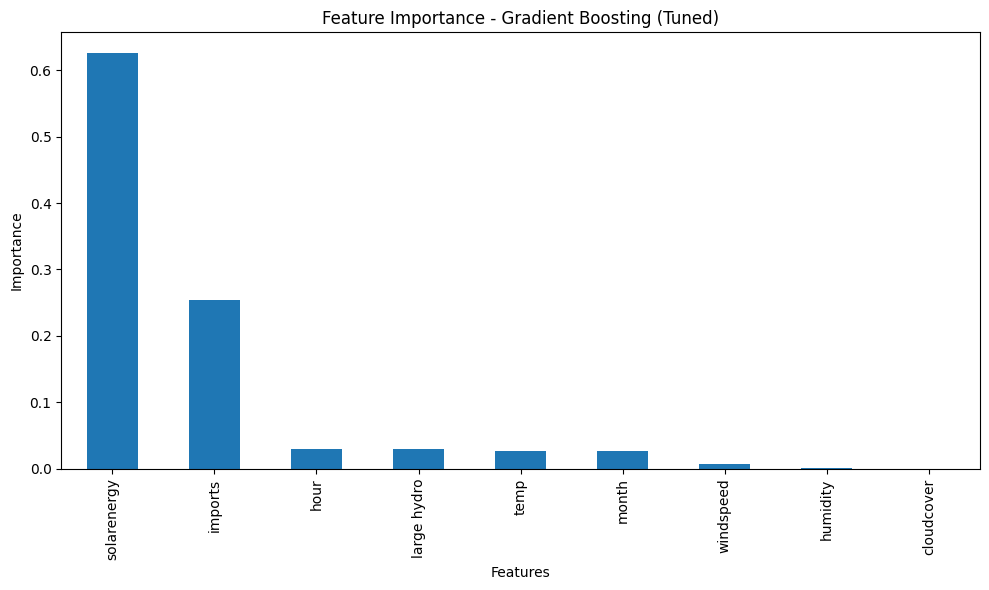

Tuning XGBoost...
Fitting 2 folds for each of 5 candidates, totalling 10 fits
XGBoost - Best Parameters: {'subsample': 0.7, 'n_estimators': 100, 'max_depth': 3, 'learning_rate': 0.1}
XGBoost - Training MSE: 4487246615.0613, R²: 0.8460
XGBoost - Testing MSE: 4671064875.0961, R²: 0.8384



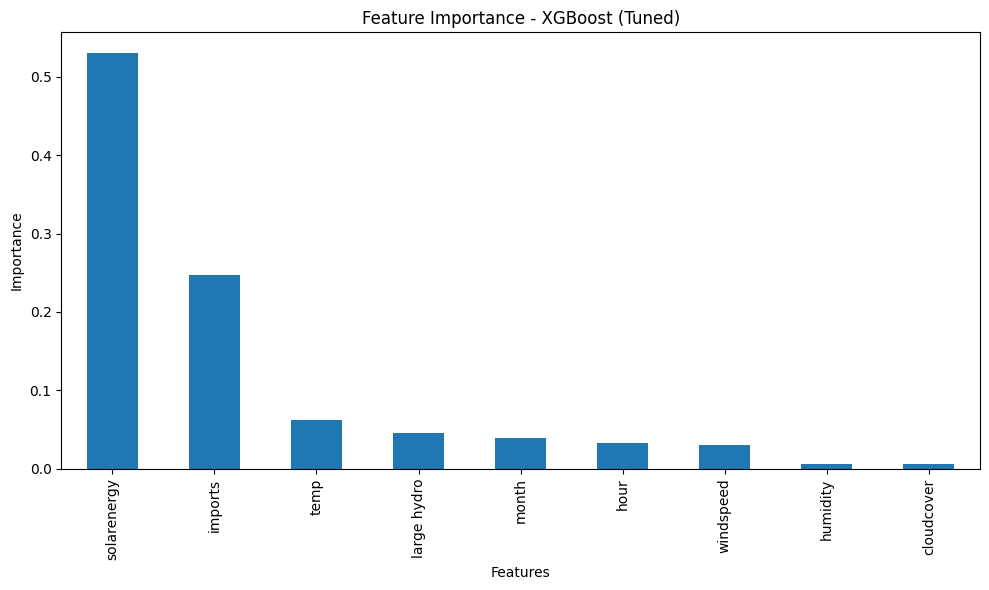

Tuning Bagging Regressor...
Fitting 2 folds for each of 5 candidates, totalling 10 fits
Bagging Regressor - Best Parameters: {'n_estimators': 50, 'max_samples': 0.7, 'max_features': 0.7}
Bagging Regressor - Training MSE: 944788196.0190, R²: 0.9676
Bagging Regressor - Testing MSE: 3608759204.0924, R²: 0.8751

Tuning Extra Trees Regressor...
Fitting 2 folds for each of 5 candidates, totalling 10 fits
Extra Trees Regressor - Best Parameters: {'n_estimators': 50, 'min_samples_split': 2, 'max_depth': None}
Extra Trees Regressor - Training MSE: 0.0000, R²: 1.0000
Extra Trees Regressor - Testing MSE: 2897566970.6798, R²: 0.8997



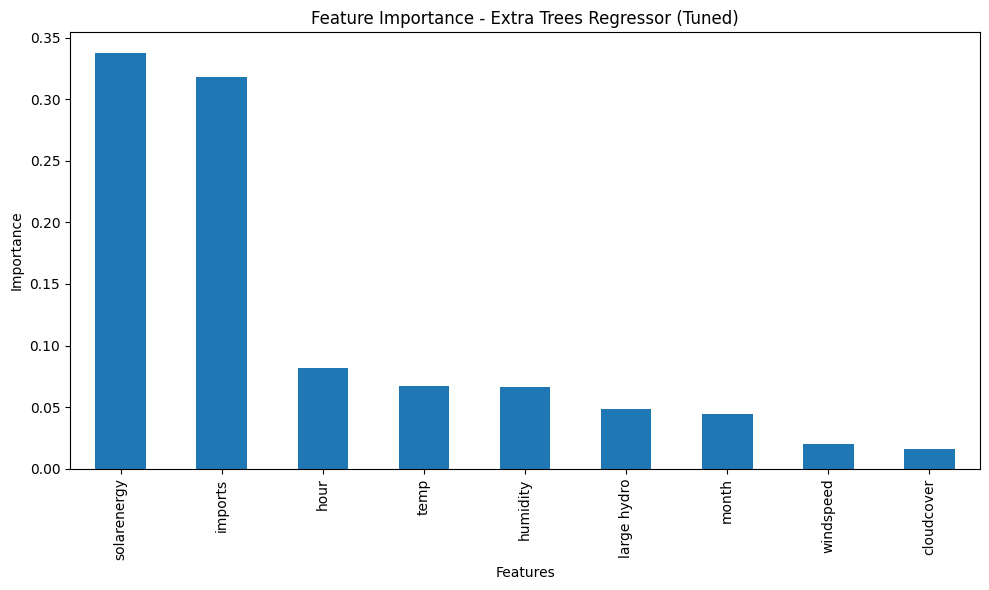

Tuning AdaBoost Regressor...
Fitting 2 folds for each of 5 candidates, totalling 10 fits
AdaBoost Regressor - Best Parameters: {'n_estimators': 100, 'learning_rate': 0.01}
AdaBoost Regressor - Training MSE: 8227936143.9093, R²: 0.7175
AdaBoost Regressor - Testing MSE: 8331407210.1529, R²: 0.7117



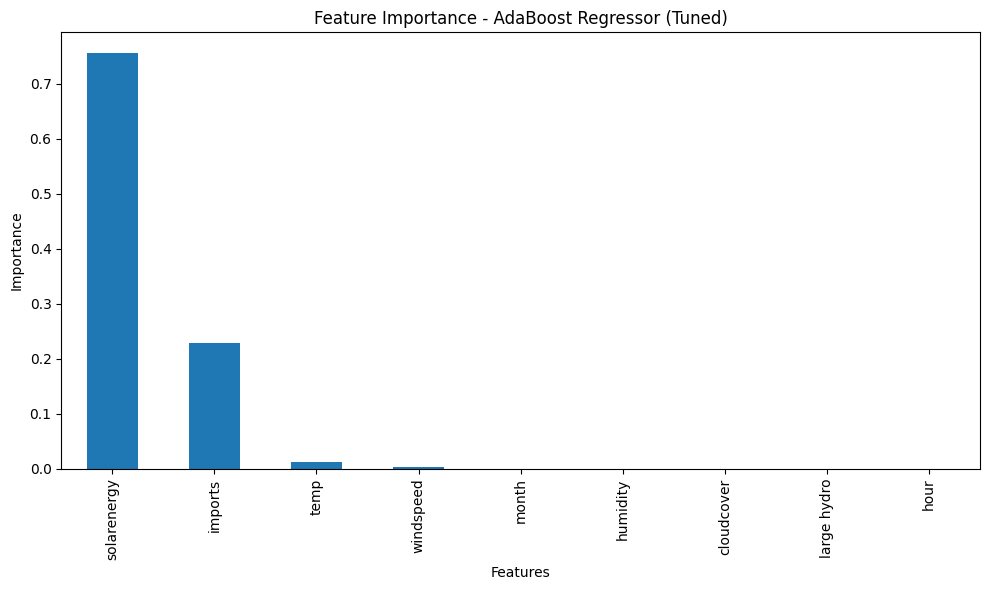

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.ensemble import GradientBoostingRegressor, BaggingRegressor, ExtraTreesRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_squared_error, r2_score

# Define the hyperparameter grid for each model
param_grids_q2_reduced = {
    'Gradient Boosting': {
        'n_estimators': [50, 100, 150],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 5, 7],
        'min_samples_split': [2, 5, 10],
    },
    'XGBoost': {
        'n_estimators': [50, 100, 150],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 5, 7],
        'subsample': [0.7, 0.8, 1.0],
    },
    'Bagging Regressor': {
        'n_estimators': [10, 50, 100],
        'max_samples': [0.5, 0.7, 1.0],
        'max_features': [0.5, 0.7, 1.0],
    },
    'Extra Trees Regressor': {
        'n_estimators': [50, 100, 150],
        'max_depth': [None, 5, 10],
        'min_samples_split': [2, 5, 10],
    },
    'AdaBoost Regressor': {
        'n_estimators': [50, 100, 150],
        'learning_rate': [0.01, 0.1, 0.2],
    },
}

# Iterate through each tuned model and plot feature importance if available
for model_name, model in [
    ('Gradient Boosting', GradientBoostingRegressor(random_state=42)),
    ('XGBoost', XGBRegressor(random_state=42)),
    ('Bagging Regressor', BaggingRegressor(random_state=42)),
    ('Extra Trees Regressor', ExtraTreesRegressor(random_state=42)),
    ('AdaBoost Regressor', AdaBoostRegressor(random_state=42))
]:
    print(f"Tuning {model_name}...")

    # Randomized search with cross-validation (reduced parameters)
    randomized_search = RandomizedSearchCV(
        estimator=model,
        param_distributions=param_grids_q2_reduced[model_name],
        n_iter=5,  # Reduced number of iterations for faster tuning
        cv=2,  # Reduced cross-validation folds
        verbose=1,
        random_state=42,
        n_jobs=-1  # Use all available cores
    )

    # Fit the randomized search
    randomized_search.fit(X_train_q2, y_train_q2)

    # Get the best model after tuning
    best_model = randomized_search.best_estimator_

    # Evaluate on training and test data
    y_train_pred = best_model.predict(X_train_q2)
    y_test_pred = best_model.predict(X_test_q2)

    train_mse = mean_squared_error(y_train_q2, y_train_pred)
    train_r2 = r2_score(y_train_q2, y_train_pred)
    test_mse = mean_squared_error(y_test_q2, y_test_pred)
    test_r2 = r2_score(y_test_q2, y_test_pred)

    # Display the evaluation results
    print(f"{model_name} - Best Parameters: {randomized_search.best_params_}")
    print(f"{model_name} - Training MSE: {train_mse:.4f}, R²: {train_r2:.4f}")
    print(f"{model_name} - Testing MSE: {test_mse:.4f}, R²: {test_r2:.4f}\n")

    # Extract and plot feature importance for models that support it
    if model_name in ['Gradient Boosting', 'XGBoost', 'Extra Trees Regressor', 'AdaBoost Regressor']:
        # Check if the model has the attribute 'feature_importances_'
        if hasattr(best_model, 'feature_importances_'):
            feature_importances = best_model.feature_importances_
            feature_importance_series = pd.Series(feature_importances, index=X_train_q2.columns)

            # Plot feature importances
            plt.figure(figsize=(10, 6))
            feature_importance_series.sort_values(ascending=False).plot(kind='bar')
            plt.title(f'Feature Importance - {model_name} (Tuned)')
            plt.xlabel('Features')
            plt.ylabel('Importance')
            plt.tight_layout()
            plt.show()

    elif model_name == 'Bagging Regressor':
        # Bagging Regressor: Get feature importances from base estimators if available
        if hasattr(best_model, 'estimators_'):
            # Initialize an array to collect feature importances and count valid estimators
            importances_sum = np.zeros(X_train_q2.shape[1])
            valid_estimators_count = 0

            for estimator in best_model.estimators_:
                if hasattr(estimator, 'feature_importances_'):
                    # Check if the number of features matches, if not skip the estimator
                    if len(estimator.feature_importances_) == X_train_q2.shape[1]:
                        importances_sum += estimator.feature_importances_
                        valid_estimators_count += 1

            # Calculate the average feature importance if we have valid estimators
            if valid_estimators_count > 0:
                avg_importances = importances_sum / valid_estimators_count

                # Convert to Pandas Series for easy plotting
                avg_importance_series = pd.Series(avg_importances, index=X_train_q2.columns)

                # Plot the averaged feature importances
                plt.figure(figsize=(10, 6))
                avg_importance_series.sort_values(ascending=False).plot(kind='bar')
                plt.title(f'Feature Importance - {model_name} (Tuned)')
                plt.xlabel('Features')
                plt.ylabel('Importance')
                plt.tight_layout()
                plt.show()


In [ ]:
import lime
import lime.lime_tabular
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score
from sklearn.ensemble import GradientBoostingRegressor, BaggingRegressor, ExtraTreesRegressor, AdaBoostRegressor
from xgboost import XGBRegressor

# Train and Evaluate Each Model, then Perform LIME Analysis
for model_name, model in [
    ('Gradient Boosting', GradientBoostingRegressor(random_state=42)),
    ('XGBoost', XGBRegressor(random_state=42)),
    ('Bagging Regressor', BaggingRegressor(random_state=42)),
    ('Extra Trees Regressor', ExtraTreesRegressor(random_state=42)),
    ('AdaBoost Regressor', AdaBoostRegressor(random_state=42))
]:
    print(f"\nFitting {model_name}...")
    model.fit(X_train_q2, y_train_q2)

    # Evaluate on training and test data
    train_r2 = r2_score(y_train_q2, model.predict(X_train_q2))
    test_r2 = r2_score(y_test_q2, model.predict(X_test_q2))

    print(f"{model_name} - Train R²: {train_r2:.4f}, Test R²: {test_r2:.4f}")

    # Initialize the LIME Explainer with training data
    explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=X_train_q2.values,
        feature_names=X_train_q2.columns,
        mode='regression',
        random_state=42
    )

    # Select an instance to explain from the test set (e.g., the 10th instance)
    i = 10  # You can change this index to analyze different instances
    instance = X_test_q2.iloc[i].to_numpy()

    # Generate the LIME explanation for the chosen instance
    print(f"\nLIME Explanation for {model_name}:")
    explanation = explainer.explain_instance(
        instance,
        model.predict,  # Predict function from the trained model
        num_features=10
    )

    # Save the explanation as an HTML file for detailed visualization
    explanation.save_to_file(f"lime_explanation_{model_name}_instance_{i}.html")

    # You can also use explanation.show_in_notebook() if you're using Jupyter
    explanation.show_in_notebook()





Fitting Gradient Boosting...
Gradient Boosting - Train R²: 0.8452, Test R²: 0.8367

LIME Explanation for Gradient Boosting:



Fitting XGBoost...
XGBoost - Train R²: 0.9423, Test R²: 0.8888

LIME Explanation for XGBoost:



Fitting Bagging Regressor...
Bagging Regressor - Train R²: 0.9771, Test R²: 0.8780

LIME Explanation for Bagging Regressor:



Fitting Extra Trees Regressor...
Extra Trees Regressor - Train R²: 1.0000, Test R²: 0.9015

LIME Explanation for Extra Trees Regressor:



Fitting AdaBoost Regressor...
AdaBoost Regressor - Train R²: 0.6093, Test R²: 0.6022

LIME Explanation for AdaBoost Regressor:


###**Classification Model for Predicting Low Renewable Generation Days**

In [ ]:
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Step 1: Create Target Variable for Classification
# Define low renewable generation threshold as a quantile (e.g., below the 20th percentile)
threshold = y_q2.quantile(0.2)
data_final['low_renewable'] = (data_final['combined_renewables'] < threshold).astype(int)

# Step 2: Define Features and Target for Classification Task
X_classification = data_final[features_q2]
y_classification = data_final['low_renewable']

# Step 3: Train-test Split for Classification
X_train_class, X_test_class, y_train_class, y_test_class = train_test_split(X_classification, y_classification, test_size=0.2, random_state=42)

# Step 4: Model Training - Random Forest Classifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_train_class, y_train_class)

# Step 5: Model Evaluation - Classification Metrics
# Predictions on Test Data
y_pred_class = rf_classifier.predict(X_test_class)

# Accuracy Score
accuracy_class = accuracy_score(y_test_class, y_pred_class)
print("Random Forest Classifier - Accuracy:", accuracy_class)

# Classification Report
classification_report_class = classification_report(y_test_class, y_pred_class)
print("\nClassification Report:\n", classification_report_class)

# Confusion Matrix
confusion_matrix_class = confusion_matrix(y_test_class, y_pred_class)
print("\nConfusion Matrix:\n", confusion_matrix_class)


Random Forest Classifier - Accuracy: 0.9036983669548511

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.95      0.94      6670
           1       0.79      0.71      0.75      1658

    accuracy                           0.90      8328
   macro avg       0.86      0.83      0.84      8328
weighted avg       0.90      0.90      0.90      8328


Confusion Matrix:
 [[6348  322]
 [ 480 1178]]


####**Addressing Class Imbalance with SMOTE and Evaluating the Random Forest Classifier**

In [ ]:
from imblearn.over_sampling import SMOTE
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Step 1: Apply SMOTE to balance the classes in the training dataset
smote = SMOTE(random_state=42)
X_train_class_balanced, y_train_class_balanced = smote.fit_resample(X_train_class, y_train_class)

# Step 2: Train Random Forest Classifier on Balanced Data
rf_classifier_balanced = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier_balanced.fit(X_train_class_balanced, y_train_class_balanced)

# Step 3: Model Evaluation - Classification Metrics on Test Data
# Predictions on Test Data
y_pred_class_balanced = rf_classifier_balanced.predict(X_test_class)

# Accuracy Score
accuracy_class_balanced = accuracy_score(y_test_class, y_pred_class_balanced)
print("Random Forest Classifier (Balanced Data) - Accuracy:", accuracy_class_balanced)

# Classification Report
classification_report_class_balanced = classification_report(y_test_class, y_pred_class_balanced)
print("\nClassification Report (Balanced Data):\n", classification_report_class_balanced)

# Confusion Matrix
confusion_matrix_class_balanced = confusion_matrix(y_test_class, y_pred_class_balanced)
print("\nConfusion Matrix (Balanced Data):\n", confusion_matrix_class_balanced)


Random Forest Classifier (Balanced Data) - Accuracy: 0.8846061479346782

Classification Report (Balanced Data):
               precision    recall  f1-score   support

           0       0.95      0.91      0.93      6670
           1       0.68      0.80      0.73      1658

    accuracy                           0.88      8328
   macro avg       0.81      0.85      0.83      8328
weighted avg       0.89      0.88      0.89      8328


Confusion Matrix (Balanced Data):
 [[6037  633]
 [ 328 1330]]


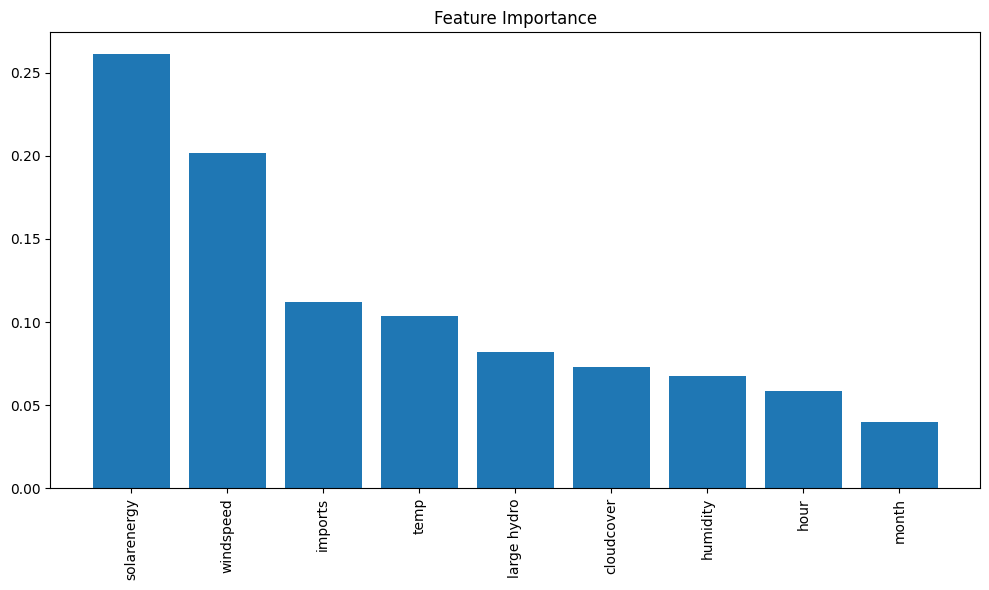

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Plot feature importances
importances = rf_classifier_balanced.feature_importances_
indices = np.argsort(importances)[::-1]
plt.figure(figsize=(10, 6))
plt.title("Feature Importance")
plt.bar(range(X_train_class.shape[1]), importances[indices], align="center")
plt.xticks(range(X_train_class.shape[1]), np.array(X_train_class.columns)[indices], rotation=90)
plt.tight_layout()
plt.show()


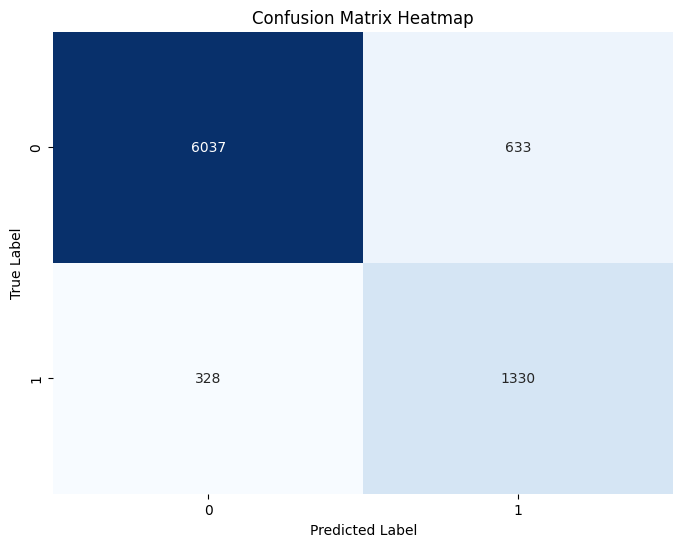

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
sns.heatmap(confusion_matrix_class_balanced, annot=True, fmt="d", cmap="Blues", cbar=False)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix Heatmap")
plt.show()


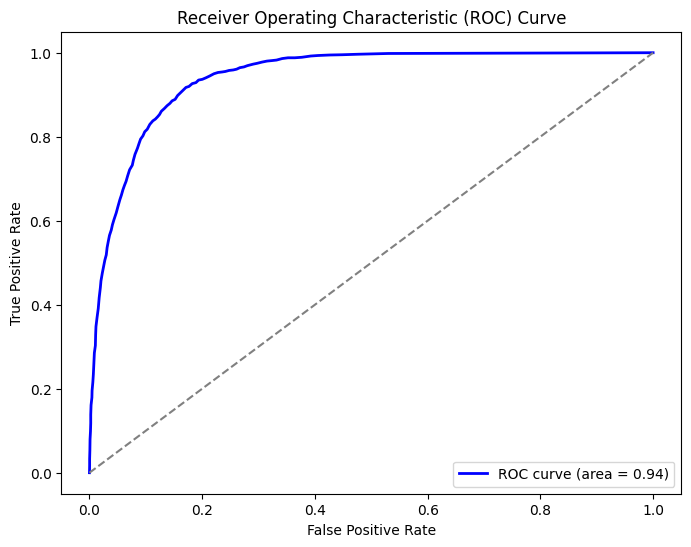

In [ ]:
from sklearn.metrics import roc_curve, auc

# Probabilities for positive class
y_probs = rf_classifier_balanced.predict_proba(X_test_class)[:, 1]

# Compute ROC curve and AUC
fpr, tpr, thresholds = roc_curve(y_test_class, y_probs)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='grey', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()


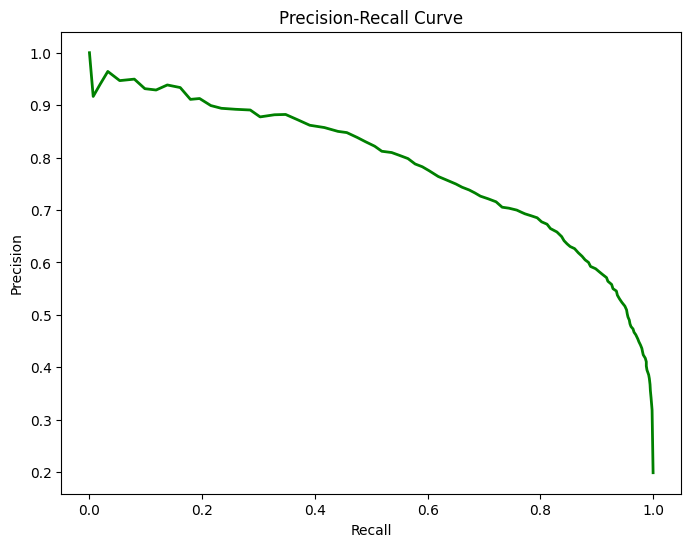

In [ ]:
from sklearn.metrics import precision_recall_curve

precision, recall, _ = precision_recall_curve(y_test_class, y_probs)

plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='green', lw=2)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.show()


In [ ]:
import lime
import lime.lime_tabular

# Create the LIME explainer
explainer = lime.lime_tabular.LimeTabularExplainer(X_train_class_balanced.values,  # convert to numpy array
                                                   feature_names=X_train_class.columns,
                                                   class_names=[0, 1],
                                                   mode='classification')

# Explain a single prediction
i = 10  # Index of the sample to explain

# Convert the selected row to a numpy array
explanation = explainer.explain_instance(X_test_class.iloc[i].to_numpy(),  # Ensure it's a 1D numpy array
                                         rf_classifier_balanced.predict_proba,
                                         num_features=10)

# Display the explanation
explanation.show_in_notebook()  # or explanation.as_pyplot_figure()


###Gradient Boosting Classifier

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Step 1: Train Gradient Boosting Classifier on Balanced Data
gb_classifier = GradientBoostingClassifier(n_estimators=100, random_state=42)
gb_classifier.fit(X_train_class_balanced, y_train_class_balanced)

# Step 2: Model Evaluation - Classification Metrics on Test Data
# Predictions on Test Data
y_pred_gb = gb_classifier.predict(X_test_class)

# Accuracy Score
accuracy_gb = accuracy_score(y_test_class, y_pred_gb)
print("Gradient Boosting Classifier - Accuracy:", accuracy_gb)

# Classification Report
classification_report_gb = classification_report(y_test_class, y_pred_gb)
print("\nClassification Report:\n", classification_report_gb)

# Confusion Matrix
confusion_matrix_gb = confusion_matrix(y_test_class, y_pred_gb)
print("\nConfusion Matrix:\n", confusion_matrix_gb)


Gradient Boosting Classifier - Accuracy: 0.8437800192122958

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.86      0.90      6670
           1       0.58      0.79      0.67      1658

    accuracy                           0.84      8328
   macro avg       0.76      0.82      0.78      8328
weighted avg       0.87      0.84      0.85      8328


Confusion Matrix:
 [[5718  952]
 [ 349 1309]]


###XGBoost Classifier for Predicting Low Renewable Generation Days

In [ ]:
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Step 1: Train XGBoost Classifier on Balanced Data
xgb_classifier = XGBClassifier(n_estimators=100, random_state=42, use_label_encoder=False, eval_metric='logloss')
xgb_classifier.fit(X_train_class_balanced, y_train_class_balanced)

# Step 2: Model Evaluation - Classification Metrics on Test Data
# Predictions on Test Data
y_pred_xgb = xgb_classifier.predict(X_test_class)

# Accuracy Score
accuracy_xgb = accuracy_score(y_test_class, y_pred_xgb)
print("XGBoost Classifier - Accuracy:", accuracy_xgb)

# Classification Report
classification_report_xgb = classification_report(y_test_class, y_pred_xgb)
print("\nClassification Report (XGBoost):\n", classification_report_xgb)

# Confusion Matrix
confusion_matrix_xgb = confusion_matrix(y_test_class, y_pred_xgb)
print("\nConfusion Matrix (XGBoost):\n", confusion_matrix_xgb)


XGBoost Classifier - Accuracy: 0.8817243035542748

Classification Report (XGBoost):
               precision    recall  f1-score   support

           0       0.94      0.91      0.93      6670
           1       0.68      0.75      0.72      1658

    accuracy                           0.88      8328
   macro avg       0.81      0.83      0.82      8328
weighted avg       0.89      0.88      0.88      8328


Confusion Matrix (XGBoost):
 [[6094  576]
 [ 409 1249]]



--- XGBoost ---
Accuracy: 0.8817
Precision for Class 1: 0.6844
Recall for Class 1: 0.7533
F1 Score for Class 1: 0.7172
Confusion Matrix:
[[6094  576]
 [ 409 1249]]


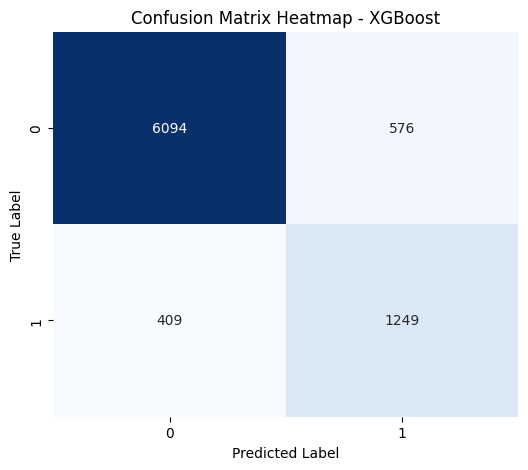

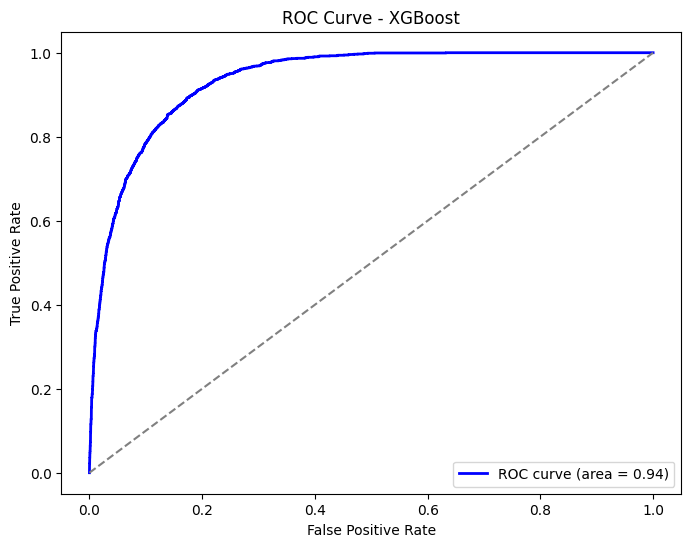

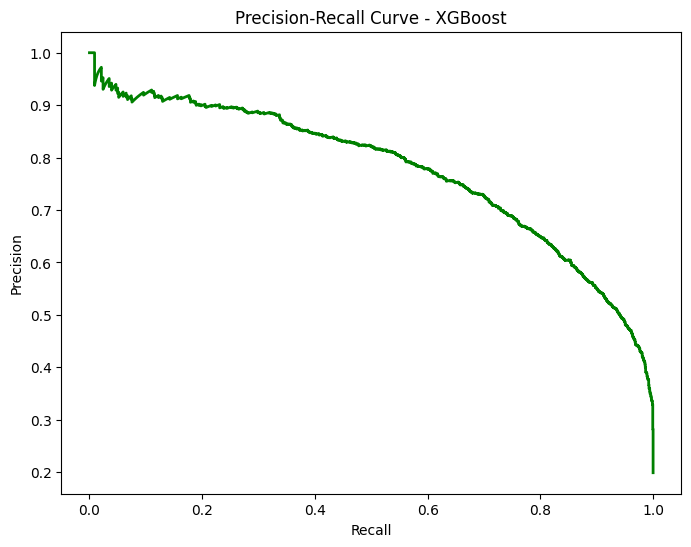

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc, precision_recall_curve
import lime.lime_tabular

# Step 1: Apply Evaluation for XGBoost
model_name, model = ("XGBoost", xgb_classifier)
print(f"\n--- {model_name} ---")

# Make predictions
y_pred = model.predict(X_test_class)

# Calculate evaluation metrics
accuracy = accuracy_score(y_test_class, y_pred)
report = classification_report(y_test_class, y_pred, output_dict=True)
confusion = confusion_matrix(y_test_class, y_pred)

# Display results
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision for Class 1: {report['1']['precision']:.4f}")
print(f"Recall for Class 1: {report['1']['recall']:.4f}")
print(f"F1 Score for Class 1: {report['1']['f1-score']:.4f}")
print(f"Confusion Matrix:\n{confusion}")

# Plot Confusion Matrix Heatmap
plt.figure(figsize=(6, 5))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues", cbar=False)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title(f"Confusion Matrix Heatmap - {model_name}")
plt.show()

# Plot ROC Curve
y_probs = model.predict_proba(X_test_class)[:, 1]
fpr, tpr, _ = roc_curve(y_test_class, y_probs)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='grey', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title(f'ROC Curve - {model_name}')
plt.legend(loc="lower right")
plt.show()

# Plot Precision-Recall Curve
precision, recall, _ = precision_recall_curve(y_test_class, y_probs)

plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='green', lw=2)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title(f'Precision-Recall Curve - {model_name}')
plt.show()

# LIME Explanation for XGBoost Model
explainer = lime.lime_tabular.LimeTabularExplainer(X_train_class_balanced.values,
                                                   feature_names=X_train_class.columns,
                                                   class_names=[0, 1],
                                                   mode='classification')

# Explain a single prediction
i = 10  # Index of the sample to explain
explanation = explainer.explain_instance(X_test_class.iloc[i].to_numpy(), xgb_classifier.predict_proba, num_features=10)
explanation.show_in_notebook()  # or explanation.as_pyplot_figure()


Threshold Adjustment for All Models

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Function to adjust threshold and make predictions
def adjusted_predictions(model, X_data, threshold=0.5):
    proba = model.predict_proba(X_data)[:, 1]  # Probability of Class 1 (low renewable generation)
    return np.where(proba >= threshold, 1, 0)

# Define thresholds to test
thresholds = [0.3, 0.4, 0.5, 0.6, 0.7]

# Step 1: Apply Threshold Adjustment for Random Forest, Gradient Boosting, and XGBoost
for model_name, model in [("Random Forest", rf_classifier_balanced),
                          ("Gradient Boosting", gb_classifier),
                          ("XGBoost", xgb_classifier)]:
    print(f"\n--- {model_name} ---")
    for threshold in thresholds:
        # Make adjusted predictions
        y_pred_adjusted = adjusted_predictions(model, X_test_class, threshold)

        # Calculate evaluation metrics
        accuracy = accuracy_score(y_test_class, y_pred_adjusted)
        report = classification_report(y_test_class, y_pred_adjusted, output_dict=True)
        confusion = confusion_matrix(y_test_class, y_pred_adjusted)

        # Display results for this threshold
        print(f"\nThreshold: {threshold}")
        print(f"Accuracy: {accuracy:.4f}")
        print(f"Precision for Class 1: {report['1']['precision']:.4f}")
        print(f"Recall for Class 1: {report['1']['recall']:.4f}")
        print(f"F1 Score for Class 1: {report['1']['f1-score']:.4f}")
        print(f"Confusion Matrix:\n{confusion}")



--- Random Forest ---

Threshold: 0.3
Accuracy: 0.8320
Precision for Class 1: 0.5456
Recall for Class 1: 0.9349
F1 Score for Class 1: 0.6890
Confusion Matrix:
[[5379 1291]
 [ 108 1550]]

Threshold: 0.4
Accuracy: 0.8617
Precision for Class 1: 0.6050
Recall for Class 1: 0.8794
F1 Score for Class 1: 0.7168
Confusion Matrix:
[[5718  952]
 [ 200 1458]]

Threshold: 0.5
Accuracy: 0.8840
Precision for Class 1: 0.6730
Recall for Class 1: 0.8118
F1 Score for Class 1: 0.7359
Confusion Matrix:
[[6016  654]
 [ 312 1346]]

Threshold: 0.6
Accuracy: 0.8874
Precision for Class 1: 0.7214
Recall for Class 1: 0.7075
F1 Score for Class 1: 0.7144
Confusion Matrix:
[[6217  453]
 [ 485 1173]]

Threshold: 0.7
Accuracy: 0.8850
Precision for Class 1: 0.7878
Recall for Class 1: 0.5778
F1 Score for Class 1: 0.6667
Confusion Matrix:
[[6412  258]
 [ 700  958]]

--- Gradient Boosting ---

Threshold: 0.3
Accuracy: 0.7888
Precision for Class 1: 0.4839
Recall for Class 1: 0.9131
F1 Score for Class 1: 0.6325
Confusion M

###plotting the low generation days using random forest classifier

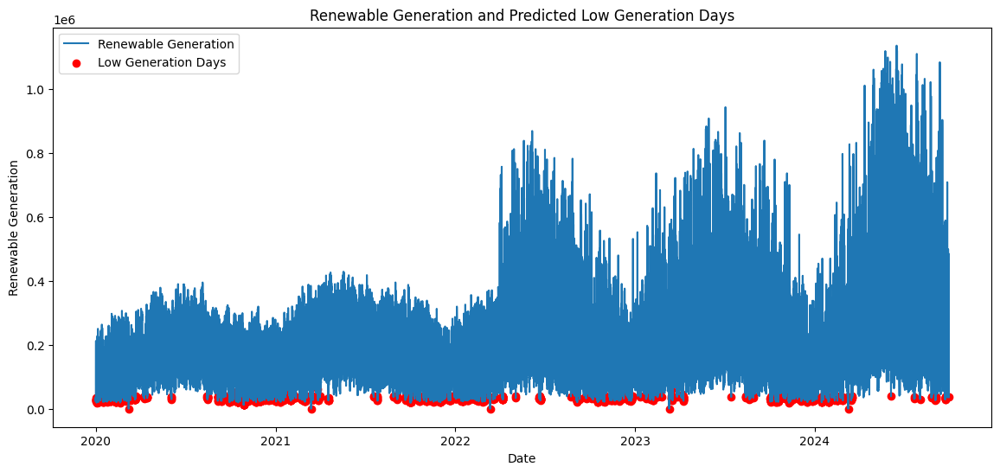

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt

# Assuming 'data_final' is your DataFrame with renewable generation features
# Define 'low_generation' as target, where 1 indicates low generation day
low_generation_threshold = 0.2 * data_final['combined_renewables'].mean()
data_final['low_generation'] = np.where(data_final['combined_renewables'] < low_generation_threshold, 1, 0)

# Features and Target
features = ['temp', 'humidity', 'windspeed', 'solarenergy', 'cloudcover', 'large hydro', 'imports', 'hour', 'month']
target = 'low_generation'
X = data_final[features]
y = data_final[target]

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Random Forest Classifier
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Make predictions
data_final['predicted_low_generation'] = model.predict(X)

# Check if 'datetime' exists in data_final
if 'datetime' in data_final.columns:
    data_final['date'] = pd.to_datetime(data_final['datetime'])
else:
    # If no datetime column exists, create a date column with realistic dates from 2020 to 2024
    data_final['date'] = pd.date_range(start='2020-01-01', end='2024-09-30', periods=len(data_final))

# Identify consecutive low generation days
low_gen_periods = data_final[data_final['predicted_low_generation'] == 1]['date']

# Plotting the results
plt.figure(figsize=(14, 6))
plt.plot(data_final['date'], data_final['combined_renewables'], label='Renewable Generation')
plt.scatter(low_gen_periods, data_final.loc[data_final['predicted_low_generation'] == 1, 'combined_renewables'],
            color='red', label='Low Generation Days', marker='o')
plt.xlabel('Date')
plt.ylabel('Renewable Generation')
plt.title('Renewable Generation and Predicted Low Generation Days')
plt.legend()
plt.show()


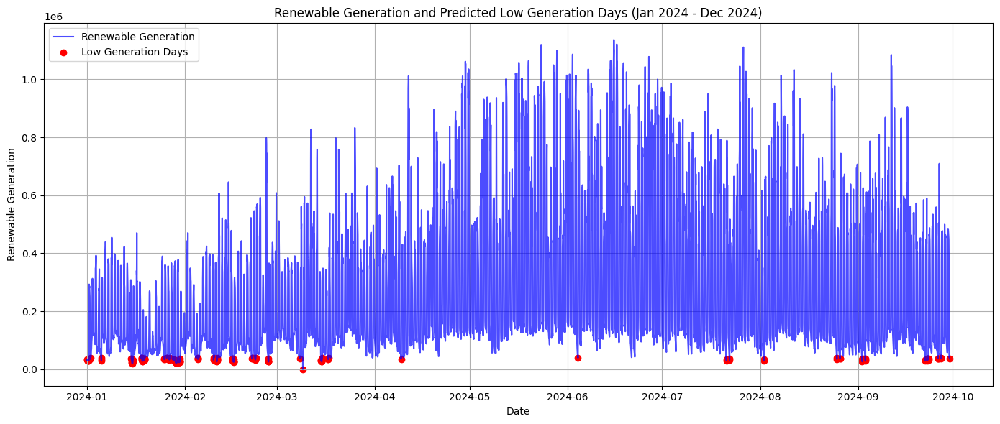

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming the correct date column name is 'date', based on the columns present in data_final
# Rename 'date' to 'datetime' for easier reference (or use it directly without renaming)
data_final.rename(columns={'date': 'datetime'}, inplace=True)

# Convert 'datetime' column to datetime type for filtering
data_final['datetime'] = pd.to_datetime(data_final['datetime'])

# Filter the data for the year 2024, from January to December
filtered_data_2024 = data_final[(data_final['datetime'].dt.year == 2024) & (data_final['datetime'].dt.month <= 12)]

# Plotting the renewable generation with the identified low generation days for the specified period
plt.figure(figsize=(14, 6))

# Plot renewable generation
plt.plot(filtered_data_2024['datetime'], filtered_data_2024['combined_renewables'], label='Renewable Generation', color='blue', alpha=0.7)

# Plot low generation days
low_generation_days_2024 = filtered_data_2024[filtered_data_2024['low_generation'] == 1]
plt.scatter(low_generation_days_2024['datetime'], low_generation_days_2024['combined_renewables'], color='red', label='Low Generation Days')

# Plot settings
plt.xlabel('Date')
plt.ylabel('Renewable Generation')
plt.title('Renewable Generation and Predicted Low Generation Days (Jan 2024 - Dec 2024)')
plt.legend()
plt.grid()
plt.tight_layout()

# Show the plot
plt.show()


##Research Question 3
What strategies can be implemented to minimize renewable energy
curtailment during periods of high renewable output and low demand, ensuring grid stability and
optimal resource utilization?


###Linear regression , Ridge and Lasso regression

In [ ]:
data_final.head()

,load,solar,wind,renewables,nuclear,large hydro,imports,generation,thermal,temp,humidity,windspeed,cloudcover,solarenergy,hour,day,month,total_curtailment,combined_renewables,low_renewable,low_generation,predicted_low_generation,datetime
datetime,,,,,,,,,,,,,,,,,,,,,,,
2020-01-01 01:00:00,261642.173073,0.0,3406.967436,20091.520292,27279.731877,15895.241613,99143.546667,162410.879518,99144.385736,6.3,92.32,0.5,8.7,0.0,1,1,1,0.0,23498.487728,1,1,1,2020-01-01 00:00:00.000000000
2020-01-01 02:00:00,252464.832604,0.0,5967.002946,22649.576156,27273.699994,14712.373468,91953.413333,160451.063841,95815.414224,6.2,92.32,0.5,8.7,0.0,2,1,1,0.0,28616.579101,1,1,1,2020-01-01 00:59:58.184307226
2020-01-01 03:00:00,245416.002344,0.0,6199.244249,22898.479955,27280.022811,14073.236606,93985.426667,151384.511224,87132.771853,5.8,95.57,5.8,8.7,0.0,3,1,1,0.0,29097.724204,1,1,1,2020-01-01 01:59:56.368614453
2020-01-01 04:00:00,241363.031667,0.0,5080.579630,21691.987069,27280.588677,14248.185413,94369.893333,146970.820052,83750.058893,6.1,92.25,4.9,5.0,0.0,4,1,1,0.0,26772.566699,1,1,1,2020-01-01 02:59:54.552921680
2020-01-01 05:00:00,239642.357318,0.0,9443.764928,26065.495828,27262.534627,15167.772388,93689.306667,145981.897747,77486.094904,5.2,92.37,0.5,5.0,0.0,5,1,1,0.0,35509.260757,1,1,1,2020-01-01 03:59:52.737228906


In [ ]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Define Features and Target for Curtailment Prediction
features = ['temp', 'humidity', 'windspeed', 'solarenergy', 'combined_renewables', 'thermal', 'large hydro', 'imports', 'load', 'nuclear']
target = 'total_curtailment'

# 1. Data Preprocessing
def preprocess_data(data):
    # Ensure that only the defined features and target columns are used
    data = data[features + [target]]
    data = data.dropna()
    return data

# 2. Train Linear Regression, Ridge, and Lasso Models for Curtailment Prediction
def train_models(data):
    # Split data into features (X) and target (y)
    X = data[features]
    y = data[target]

    # Split into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    models = {
        'Linear Regression': LinearRegression(),
        'Ridge Regression': Ridge(alpha=1.0),
        'Lasso Regression': Lasso(alpha=0.1)
    }

    for model_name, model in models.items():
        print(f"\n### {model_name} ###")
        # Train the model
        model.fit(X_train, y_train)

        # Predict on training set and evaluate
        y_train_pred = model.predict(X_train)
        train_mae = mean_absolute_error(y_train, y_train_pred)
        train_mse = mean_squared_error(y_train, y_train_pred)
        train_r2 = r2_score(y_train, y_train_pred)

        print("\n### Training Set Evaluation Metrics ###")
        print(f"Mean Absolute Error (MAE): {train_mae}")
        print(f"Mean Squared Error (MSE): {train_mse}")
        print(f"R-squared (R2): {train_r2}")

        # Predict on test set and evaluate
        y_test_pred = model.predict(X_test)
        test_mae = mean_absolute_error(y_test, y_test_pred)
        test_mse = mean_squared_error(y_test, y_test_pred)
        test_r2 = r2_score(y_test, y_test_pred)

        print("\n### Test Set Evaluation Metrics ###")
        print(f"Mean Absolute Error (MAE): {test_mae}")
        print(f"Mean Squared Error (MSE): {test_mse}")
        print(f"R-squared (R2): {test_r2}")

# Load your data
# Assuming 'data_final' is your dataset
# data_final = pd.read_csv('your_dataset.csv')  # Uncomment and modify to load your dataset

# Call functions
data_cleaned = preprocess_data(data_final)  # Preprocess the data
train_models(data_cleaned)  # Train and evaluate the models



### Linear Regression ###

### Training Set Evaluation Metrics ###
Mean Absolute Error (MAE): 4174.71666470449
Mean Squared Error (MSE): 60461887.82191883
R-squared (R2): 0.3331450607060167

### Test Set Evaluation Metrics ###
Mean Absolute Error (MAE): 4144.3124314800625
Mean Squared Error (MSE): 59622575.762971394
R-squared (R2): 0.32086594810113567

### Ridge Regression ###

### Training Set Evaluation Metrics ###
Mean Absolute Error (MAE): 4174.7159282647235
Mean Squared Error (MSE): 60461887.82237892
R-squared (R2): 0.3331450607009422

### Test Set Evaluation Metrics ###
Mean Absolute Error (MAE): 4144.3116905276065
Mean Squared Error (MSE): 59622568.11498585
R-squared (R2): 0.32086603521591295

### Lasso Regression ###

### Training Set Evaluation Metrics ###
Mean Absolute Error (MAE): 4213.670408827753
Mean Squared Error (MSE): 62076530.03216928
R-squared (R2): 0.31533661687658454

### Test Set Evaluation Metrics ###
Mean Absolute Error (MAE): 4185.195198878117
Mean Squared Err

###Random forest regressor


### Random Forest Model Evaluation Metrics ###
Training Set - Mean Squared Error (MSE): 3455081.4485, R² Score: 0.9619
Test Set - Mean Squared Error (MSE): 24134494.3894, R² Score: 0.7251


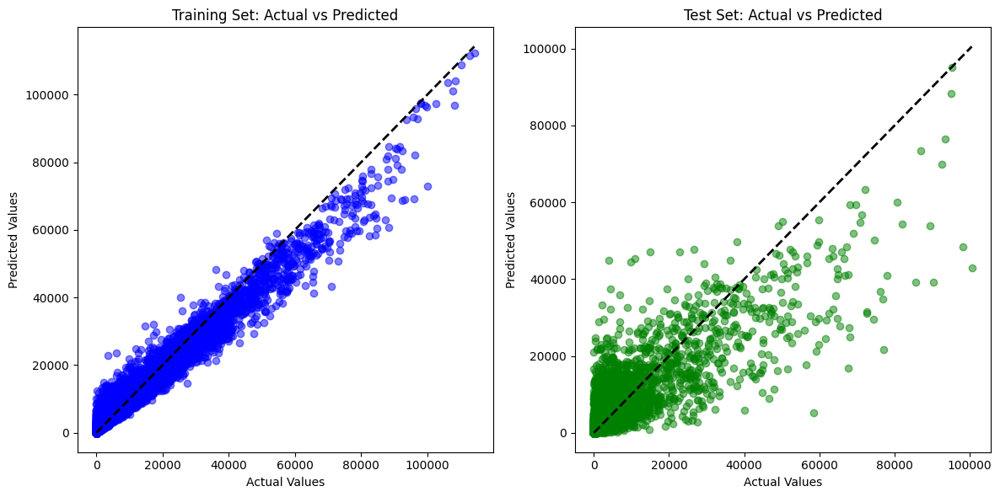

In [ ]:
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Step 1: Define Features and Target for Curtailment Minimization Model
features_cur = ['temp', 'humidity', 'windspeed', 'solarenergy','combined_renewables', 'thermal', 'large hydro', 'imports', 'load', 'nuclear']
target_cur = 'total_curtailment'# Target variable for predicting renewable curtailment risk

X_cur = data_final[features_cur]
y_cur = data_final[target_cur]

# Step 2: Train-test Split
X_train_cur, X_test_cur, y_train_cur, y_test_cur = train_test_split(X_cur, y_cur, test_size=0.2, random_state=42)

# Step 3: Model Training - Random Forest
rf_model_cur = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model_cur.fit(X_train_cur, y_train_cur)

# Model Evaluation on Training Data
y_train_pred_rf = rf_model_cur.predict(X_train_cur)
train_rf_mse = mean_squared_error(y_train_cur, y_train_pred_rf)
train_rf_r2 = r2_score(y_train_cur, y_train_pred_rf)

# Model Evaluation on Test Data
y_test_pred_rf = rf_model_cur.predict(X_test_cur)
test_rf_mse = mean_squared_error(y_test_cur, y_test_pred_rf)
test_rf_r2 = r2_score(y_test_cur, y_test_pred_rf)

# Print evaluation metrics for Train and Test sets
print("\n### Random Forest Model Evaluation Metrics ###")
print(f"Training Set - Mean Squared Error (MSE): {train_rf_mse:.4f}, R² Score: {train_rf_r2:.4f}")
print(f"Test Set - Mean Squared Error (MSE): {test_rf_mse:.4f}, R² Score: {test_rf_r2:.4f}")

# Plotting Actual vs Predicted for Train and Test sets
plt.figure(figsize=(12, 6))

# Plot for Training Set
plt.subplot(1, 2, 1)
plt.scatter(y_train_cur, y_train_pred_rf, alpha=0.5, color='blue')
plt.plot([y_train_cur.min(), y_train_cur.max()], [y_train_cur.min(), y_train_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Training Set: Actual vs Predicted')

# Plot for Test Set
plt.subplot(1, 2, 2)
plt.scatter(y_test_cur, y_test_pred_rf, alpha=0.5, color='green')
plt.plot([y_test_cur.min(), y_test_cur.max()], [y_test_cur.min(), y_test_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Test Set: Actual vs Predicted')

plt.tight_layout()
plt.show()


Random forest tuning

Fitting 3 folds for each of 32 candidates, totalling 96 fits
Best Parameters: {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
Best Score (negative MSE): -28139884.15553577

### Optimized Random Forest Model Performance (Training Set) ###

R²: 0.9185859027967309
Mean Absolute Error (MAE): 1012.3333340063978
Mean Squared Error (MSE): 7381590.391215186

### Optimized Random Forest Model Performance (Test Set) ###

R²: 0.7121141615667569
Mean Absolute Error (MAE): 1895.9619352067714
Mean Squared Error (MSE): 25274090.093230505


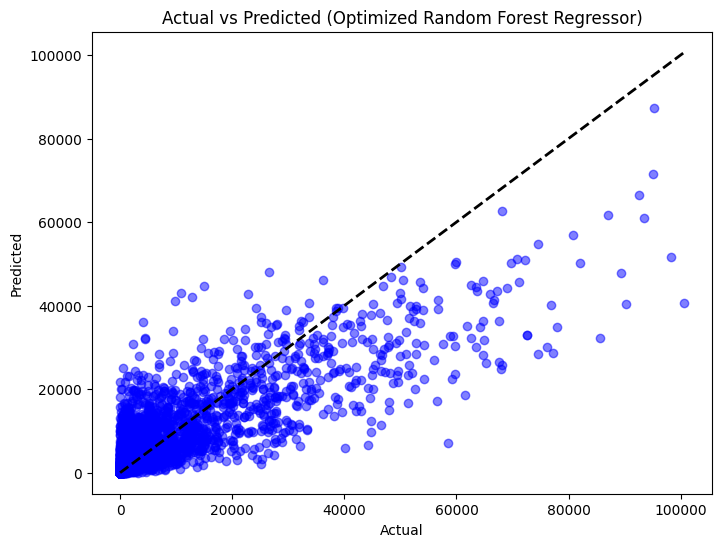

In [ ]:
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt

# Split the data into training and test sets
X_train_cur, X_test_cur, y_train_cur, y_test_cur = train_test_split(X_cur, y_cur, test_size=0.2, random_state=42)

# Define a reduced parameter grid to speed up GridSearchCV
param_grid = {
    'n_estimators': [50, 100],                # Fewer values for faster training
    'max_depth': [10, 20],                    # Reduced number of options
    'min_samples_split': [5, 10],             # Reduced options for splitting nodes
    'min_samples_leaf': [2, 4],               # Reduced options for leaf nodes
    'max_features': ['sqrt', 'log2']          # Avoid 'auto' as it can be computationally expensive
}

# Initialize the RandomForestRegressor
rf_reg = RandomForestRegressor(random_state=42)

# Set up the GridSearchCV with cross-validation
grid_search = GridSearchCV(estimator=rf_reg, param_grid=param_grid,
                           scoring='neg_mean_squared_error', cv=3, n_jobs=-1, verbose=1)

# Fit GridSearchCV to the training data (Reduced parameter grid and cv)
grid_search.fit(X_train_cur, y_train_cur)

# Print the best parameters and the best score
print("Best Parameters:", grid_search.best_params_)
print("Best Score (negative MSE):", grid_search.best_score_)

# Use the best estimator for predictions
best_rf_reg = grid_search.best_estimator_

# Make predictions on the training and test sets
y_train_pred_rantune = best_rf_reg.predict(X_train_cur)
y_test_pred_rantune = best_rf_reg.predict(X_test_cur)

# Print model performance for the training set
print("\n### Optimized Random Forest Model Performance (Training Set) ###\n")
print("R²:", r2_score(y_train_cur, y_train_pred_rantune))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_train_cur, y_train_pred_rantune))
print("Mean Squared Error (MSE):", mean_squared_error(y_train_cur, y_train_pred_rantune))

# Print model performance for the test set
print("\n### Optimized Random Forest Model Performance (Test Set) ###\n")
print("R²:", r2_score(y_test_cur, y_test_pred_rantune))
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test_cur, y_test_pred_rantune))
print("Mean Squared Error (MSE):", mean_squared_error(y_test_cur, y_test_pred_rantune))

# Optional: Plot actual vs predicted values for test data
plt.figure(figsize=(8, 6))
plt.scatter(y_test_cur, y_test_pred_rantune, color='blue', alpha=0.5)
plt.plot([y_test_cur.min(), y_test_cur.max()], [y_test_cur.min(), y_test_cur.max()], 'k--', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted (Optimized Random Forest Regressor)')
plt.show()


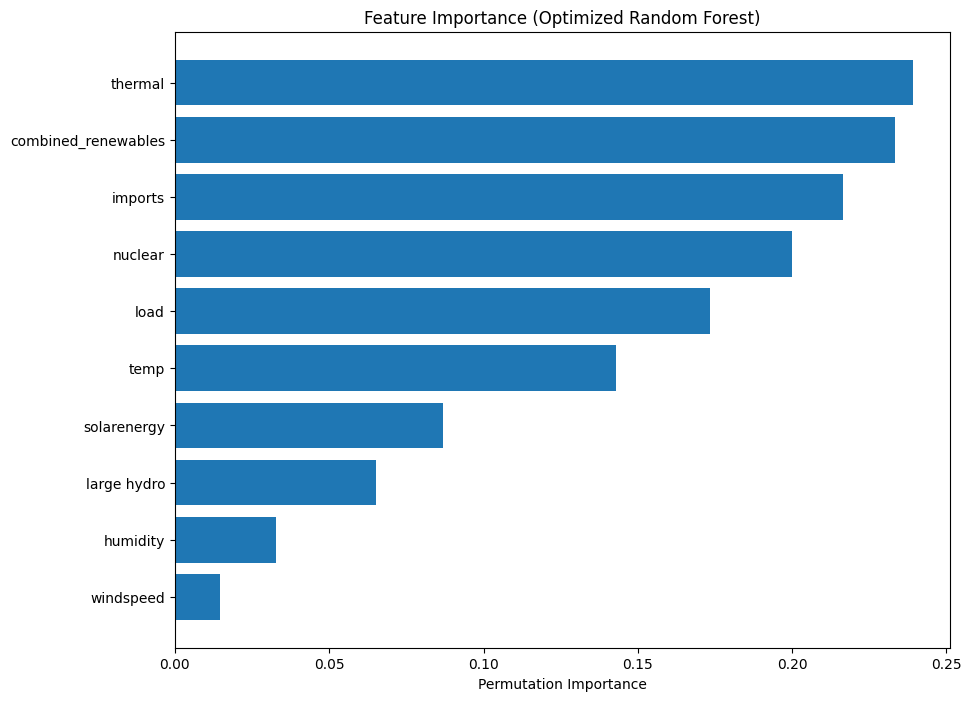

In [ ]:
from sklearn.inspection import permutation_importance
import numpy as np
import lime

import lime.lime_tabular

# Feature Importance using Permutation Importance
result = permutation_importance(best_rf_reg, X_test_cur, y_test_cur, n_repeats=10, random_state=42, n_jobs=-1)
feature_importances = result.importances_mean

# Plot feature importances
features = X_train_cur.columns if hasattr(X_train_cur, 'columns') else [f'Feature {i}' for i in range(X_train_cur.shape[1])]
sorted_idx = np.argsort(feature_importances)

plt.figure(figsize=(10, 8))
plt.barh(range(len(sorted_idx)), feature_importances[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(features)[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('Feature Importance (Optimized Random Forest)')
plt.show()

# LIME Explanation
explainer = lime.lime_tabular.LimeTabularExplainer(X_train_cur.values, mode='regression', feature_names=features,
                                                   training_labels=y_train_cur.values if hasattr(y_train_cur, 'values') else y_train_cur,
                                                   random_state=42)

# Explain a single prediction from the test set
i = 0  # Index of the sample to explain
exp = explainer.explain_instance(X_test_cur.iloc[i].values, best_rf_reg.predict, num_features=len(features))

# Show explanation
exp.show_in_notebook()


###GRadient Boosting


### Gradient Boosting Model Evaluation Metrics ###
Training Set - Mean Squared Error (MSE): 31261851.0951, R² Score: 0.6552
Test Set - Mean Squared Error (MSE): 36120723.5721, R² Score: 0.5886


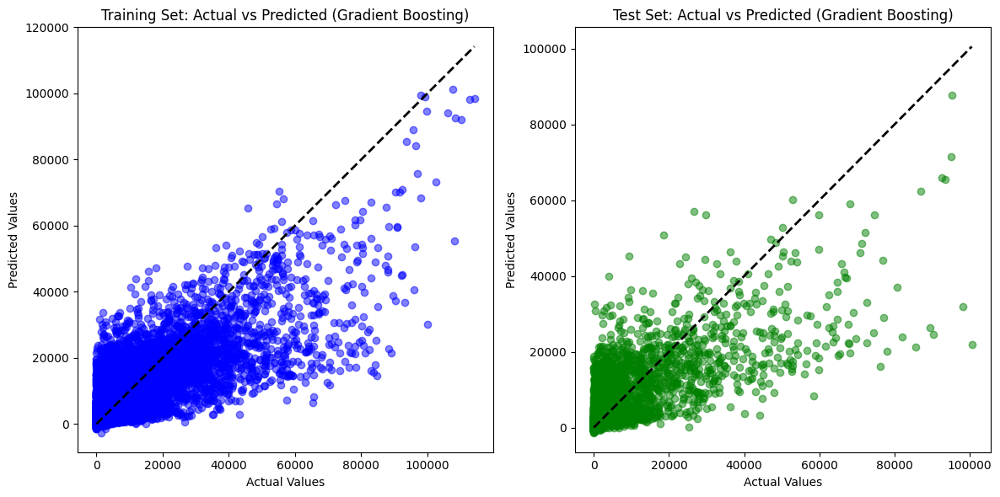

In [ ]:
import matplotlib.pyplot as plt
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Model Training - Gradient Boosting
gb_model_cur = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
gb_model_cur.fit(X_train_cur, y_train_cur)

# Model Evaluation on Training Data
y_train_pred_gb = gb_model_cur.predict(X_train_cur)
train_gb_mse = mean_squared_error(y_train_cur, y_train_pred_gb)
train_gb_r2 = r2_score(y_train_cur, y_train_pred_gb)

# Model Evaluation on Test Data
y_test_pred_gb = gb_model_cur.predict(X_test_cur)
test_gb_mse = mean_squared_error(y_test_cur, y_test_pred_gb)
test_gb_r2 = r2_score(y_test_cur, y_test_pred_gb)

# Print evaluation metrics for Train and Test sets
print("\n### Gradient Boosting Model Evaluation Metrics ###")
print(f"Training Set - Mean Squared Error (MSE): {train_gb_mse:.4f}, R² Score: {train_gb_r2:.4f}")
print(f"Test Set - Mean Squared Error (MSE): {test_gb_mse:.4f}, R² Score: {test_gb_r2:.4f}")

# Plotting Actual vs Predicted for Train and Test sets
plt.figure(figsize=(12, 6))

# Plot for Training Set
plt.subplot(1, 2, 1)
plt.scatter(y_train_cur, y_train_pred_gb, alpha=0.5, color='blue')
plt.plot([y_train_cur.min(), y_train_cur.max()], [y_train_cur.min(), y_train_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Training Set: Actual vs Predicted (Gradient Boosting)')

# Plot for Test Set
plt.subplot(1, 2, 2)
plt.scatter(y_test_cur, y_test_pred_gb, alpha=0.5, color='green')
plt.plot([y_test_cur.min(), y_test_cur.max()], [y_test_cur.min(), y_test_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Test Set: Actual vs Predicted (Gradient Boosting)')

plt.tight_layout()
plt.show()


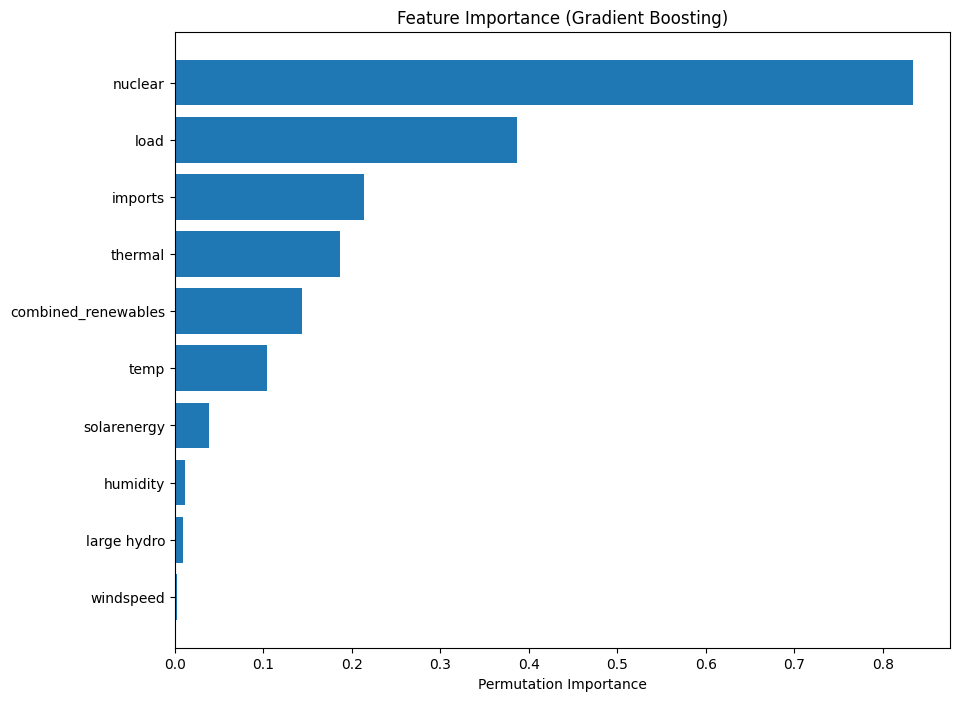

In [ ]:
from sklearn.inspection import permutation_importance
import lime
import lime.lime_tabular

# Feature Importance using Permutation Importance
gb_result = permutation_importance(gb_model_cur, X_test_cur, y_test_cur, n_repeats=10, random_state=42, n_jobs=-1)
gb_feature_importances = gb_result.importances_mean

# Plot feature importances
sorted_idx_gb = np.argsort(gb_feature_importances)

plt.figure(figsize=(10, 8))
plt.barh(range(len(sorted_idx_gb)), gb_feature_importances[sorted_idx_gb], align='center')
plt.yticks(range(len(sorted_idx_gb)), np.array(features)[sorted_idx_gb])
plt.xlabel('Permutation Importance')
plt.title('Feature Importance (Gradient Boosting)')
plt.show()

# LIME Explanation
explainer_gb = lime.lime_tabular.LimeTabularExplainer(X_train_cur.values, mode='regression', feature_names=features,
                                                      training_labels=y_train_cur.values if hasattr(y_train_cur, 'values') else y_train_cur,
                                                      random_state=42)

# Explain a single prediction from the test set
i = 0  # Index of the sample to explain
exp_gb = explainer_gb.explain_instance(X_test_cur.iloc[i].values, gb_model_cur.predict, num_features=len(features))

# Show explanation
exp_gb.show_in_notebook()


###XGBoost


### XGBoost Model Evaluation Metrics ###
Training Set - Mean Squared Error (MSE): 13158250.4762, R² Score: 0.8549
Test Set - Mean Squared Error (MSE): 25340821.8924, R² Score: 0.7114


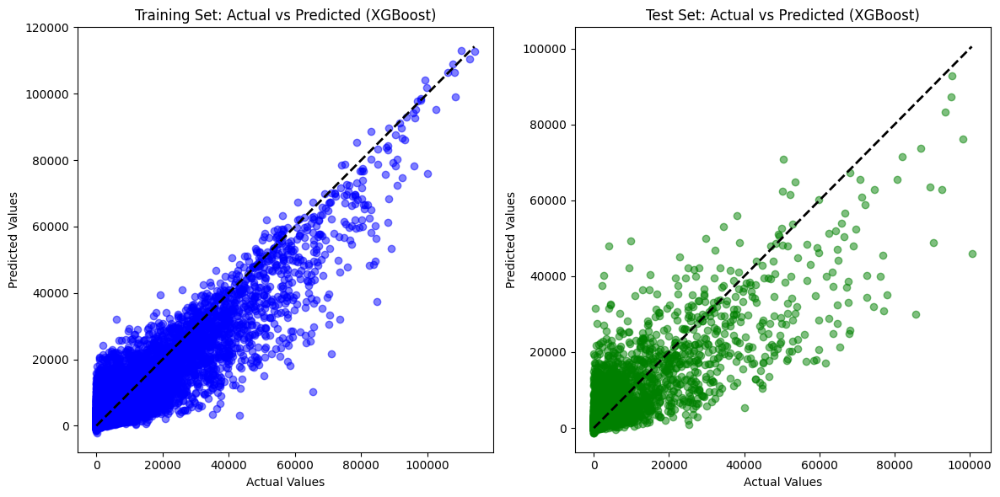

In [ ]:
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Model Training - XGBoost
xgb_model_cur = XGBRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
xgb_model_cur.fit(X_train_cur, y_train_cur)

# Model Evaluation on Training Data
y_train_pred_xgb = xgb_model_cur.predict(X_train_cur)
train_xgb_mse = mean_squared_error(y_train_cur, y_train_pred_xgb)
train_xgb_r2 = r2_score(y_train_cur, y_train_pred_xgb)

# Model Evaluation on Test Data
y_test_pred_xgb = xgb_model_cur.predict(X_test_cur)
test_xgb_mse = mean_squared_error(y_test_cur, y_test_pred_xgb)
test_xgb_r2 = r2_score(y_test_cur, y_test_pred_xgb)

# Print evaluation metrics for Train and Test sets
print("\n### XGBoost Model Evaluation Metrics ###")
print(f"Training Set - Mean Squared Error (MSE): {train_xgb_mse:.4f}, R² Score: {train_xgb_r2:.4f}")
print(f"Test Set - Mean Squared Error (MSE): {test_xgb_mse:.4f}, R² Score: {test_xgb_r2:.4f}")

# Plotting Actual vs Predicted for Train and Test sets
plt.figure(figsize=(12, 6))

# Plot for Training Set
plt.subplot(1, 2, 1)
plt.scatter(y_train_cur, y_train_pred_xgb, alpha=0.5, color='blue')
plt.plot([y_train_cur.min(), y_train_cur.max()], [y_train_cur.min(), y_train_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Training Set: Actual vs Predicted (XGBoost)')

# Plot for Test Set
plt.subplot(1, 2, 2)
plt.scatter(y_test_cur, y_test_pred_xgb, alpha=0.5, color='green')
plt.plot([y_test_cur.min(), y_test_cur.max()], [y_test_cur.min(), y_test_cur.max()], 'k--', lw=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Test Set: Actual vs Predicted (XGBoost)')

plt.tight_layout()
plt.show()


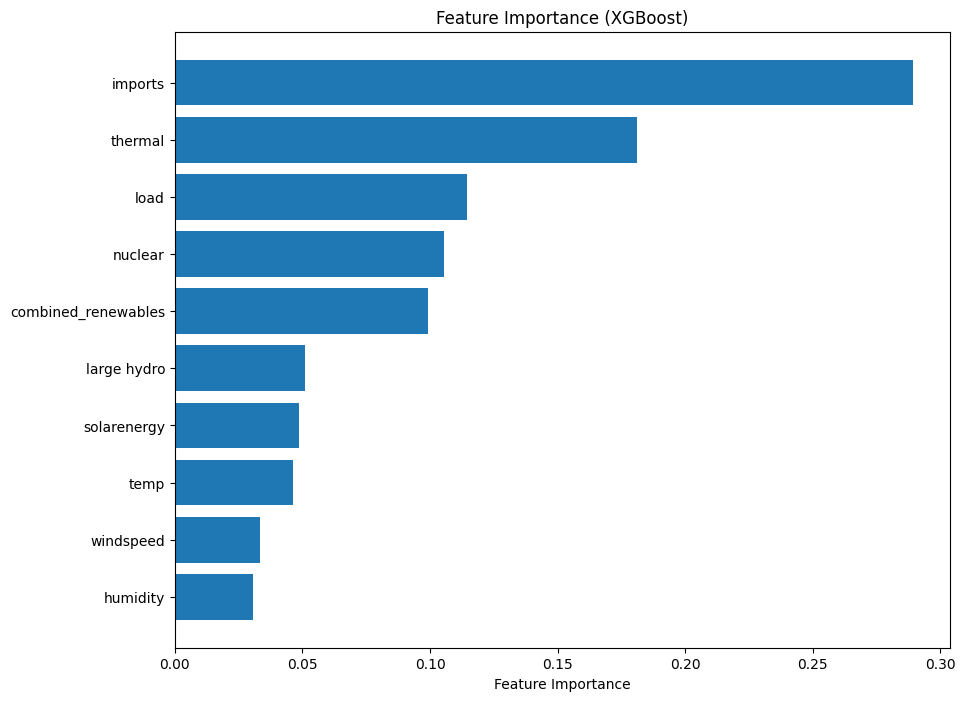

In [ ]:
# Import necessary libraries
import matplotlib.pyplot as plt
import numpy as np
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.inspection import permutation_importance

# Reinitialize the model and fit it
xgb_model_cur = XGBRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
xgb_model_cur.fit(X_train_cur, y_train_cur)

# Feature Importance using XGBoost's built-in feature importance
xgb_feature_importances = xgb_model_cur.feature_importances_

# Plot feature importances
sorted_idx_xgb = np.argsort(xgb_feature_importances)

plt.figure(figsize=(10, 8))
plt.barh(range(len(sorted_idx_xgb)), xgb_feature_importances[sorted_idx_xgb], align='center')
plt.yticks(range(len(sorted_idx_xgb)), np.array(features)[sorted_idx_xgb])
plt.xlabel('Feature Importance')
plt.title('Feature Importance (XGBoost)')
plt.show()




In [ ]:
# Install LIME for LIME explanation

import lime
import lime.lime_tabular

# Create a LIME explainer for the XGBoost model
explainer_xgb = lime.lime_tabular.LimeTabularExplainer(X_train_cur.values, mode='regression', feature_names=features,
                                                       training_labels=y_train_cur.values if hasattr(y_train_cur, 'values') else y_train_cur,
                                                       random_state=42)

# Explain a single prediction from the test set
i = 0  # Index of the sample to explain
exp_xgb = explainer_xgb.explain_instance(X_test_cur.iloc[i].values, xgb_model_cur.predict, num_features=len(features))

# Show explanation
exp_xgb.show_in_notebook()

###Bagging, Extratree and ADaBoost

In [ ]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.ensemble import BaggingRegressor, ExtraTreesRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Define Features and Target for Curtailment Prediction
features = ['temp', 'humidity', 'windspeed', 'solarenergy', 'combined_renewables', 'thermal', 'large hydro', 'imports', 'load']
target = 'total_curtailment'

# 1. Data Preprocessing
def preprocess_data(data):
    # Ensure that only the defined features and target columns are used
    data = data[features + [target]]
    data = data.dropna()
    return data

# 2. Train Linear Regression, Ridge, Lasso, and Ensemble Models for Curtailment Prediction
def train_models(data):
    # Split data into features (X) and target (y)
    X = data[features]
    y = data[target]

    # Split into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    models = {
        'Bagging Regressor': BaggingRegressor(random_state=42),
        'Extra Trees Regressor': ExtraTreesRegressor(random_state=42),
        'AdaBoost Regressor': AdaBoostRegressor(random_state=42)
    }

    for model_name, model in models.items():
        print(f"\n### {model_name} ###")
        # Train the model
        model.fit(X_train, y_train)

        # Predict on training set and evaluate
        y_train_pred = model.predict(X_train)
        train_mae = mean_absolute_error(y_train, y_train_pred)
        train_mse = mean_squared_error(y_train, y_train_pred)
        train_r2 = r2_score(y_train, y_train_pred)

        print("\n### Training Set Evaluation Metrics ###")
        print(f"Mean Absolute Error (MAE): {train_mae}")
        print(f"Mean Squared Error (MSE): {train_mse}")
        print(f"R-squared (R2): {train_r2}")

        # Predict on test set and evaluate
        y_test_pred = model.predict(X_test)
        test_mae = mean_absolute_error(y_test, y_test_pred)
        test_mse = mean_squared_error(y_test, y_test_pred)
        test_r2 = r2_score(y_test, y_test_pred)

        print("\n### Test Set Evaluation Metrics ###")
        print(f"Mean Absolute Error (MAE): {test_mae}")
        print(f"Mean Squared Error (MSE): {test_mse}")
        print(f"R-squared (R2): {test_r2}")

# Load your data
# Assuming 'data_final' is your dataset
# data_final = pd.read_csv('your_dataset.csv')  # Uncomment and modify to load your dataset

# Call functions
data_cleaned = preprocess_data(data_final)  # Preprocess the data
train_models(data_cleaned)  # Train and evaluate the models



### Bagging Regressor ###

### Training Set Evaluation Metrics ###
Mean Absolute Error (MAE): 839.0135866627969
Mean Squared Error (MSE): 6113396.990638807
R-squared (R2): 0.9325732436426746

### Test Set Evaluation Metrics ###
Mean Absolute Error (MAE): 2100.0263196235237
Mean Squared Error (MSE): 31382253.871892292
R-squared (R2): 0.6425388041860927

### Extra Trees Regressor ###

### Training Set Evaluation Metrics ###
Mean Absolute Error (MAE): 3.9175828130728625e-12
Mean Squared Error (MSE): 1.9823247512461126e-22
R-squared (R2): 1.0

### Test Set Evaluation Metrics ###
Mean Absolute Error (MAE): 1923.4114962813203
Mean Squared Error (MSE): 24805426.17000043
R-squared (R2): 0.717452502372887

### AdaBoost Regressor ###

### Training Set Evaluation Metrics ###
Mean Absolute Error (MAE): 3939.1636958860163
Mean Squared Error (MSE): 64567937.69628059
R-squared (R2): 0.2878580255447868

### Test Set Evaluation Metrics ###
Mean Absolute Error (MAE): 3968.4215237600565
Mean Squared Err

In [ ]:
from sklearn.ensemble import BaggingRegressor, ExtraTreesRegressor, AdaBoostRegressor
from sklearn.model_selection import RandomizedSearchCV

# Hyperparameter grids for each model
param_grids_curtailment = {
    'Bagging Regressor': {
        'n_estimators': [10, 50, 100],
        'max_samples': [0.5, 0.7, 1.0],
        'max_features': [0.5, 0.7, 1.0],
        'bootstrap': [True, False]
    },
    'Extra Trees Regressor': {
        'n_estimators': [50, 100, 150],
        'max_depth': [10, 20, None],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4],
        'bootstrap': [True, False]
    },
    'AdaBoost Regressor': {
        'n_estimators': [50, 100, 150],
        'learning_rate': [0.01, 0.1, 1.0],
        'loss': ['linear', 'square', 'exponential']
    }
}

# Step 3: Initialize and tune models
for model_name, model in [
    ('Bagging Regressor', BaggingRegressor(random_state=42)),
    ('Extra Trees Regressor', ExtraTreesRegressor(random_state=42)),
    ('AdaBoost Regressor', AdaBoostRegressor(random_state=42))
]:
    print(f"Tuning {model_name}...")

    # Randomized search with cross-validation (Reduced Search Parameters)
    randomized_search = RandomizedSearchCV(
        estimator=model,
        param_distributions=param_grids_curtailment[model_name],
        n_iter=3,  # Reduced number of random combinations to try
        cv=2,  # 2-fold cross-validation to reduce evaluation time
        verbose=1,
        random_state=42,
        n_jobs=-1  # Use all available cores
    )

    # Fit the randomized search
    randomized_search.fit(X_train, y_train)  # Replace with your training data

    # Get the best model after tuning
    best_model = randomized_search.best_estimator_

    # Evaluate on training and test data
    (train_mse, train_r2), (test_mse, test_r2) = evaluate_model(best_model, X_train, y_train, X_test, y_test)

    # Display the evaluation results and best parameters
    print(f"{model_name} - Best Parameters: {randomized_search.best_params_}")
    print(f"{model_name} - Training MSE: {train_mse:.4f}, R²: {train_r2:.4f}")
    print(f"{model_name} - Testing MSE: {test_mse:.4f}, R²: {test_r2:.4f}\n")


Tuning Bagging Regressor...
Fitting 2 folds for each of 3 candidates, totalling 6 fits
Bagging Regressor - Best Parameters: {'n_estimators': 50, 'max_samples': 0.7, 'max_features': 1.0, 'bootstrap': False}
Bagging Regressor - Training MSE: 0.0043, R²: 0.9375
Bagging Regressor - Testing MSE: 0.0448, R²: 0.3680

Tuning Extra Trees Regressor...
Fitting 2 folds for each of 3 candidates, totalling 6 fits
Extra Trees Regressor - Best Parameters: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 20, 'bootstrap': False}
Extra Trees Regressor - Training MSE: 0.0023, R²: 0.9664
Extra Trees Regressor - Testing MSE: 0.0414, R²: 0.4161

Tuning AdaBoost Regressor...
Fitting 2 folds for each of 3 candidates, totalling 6 fits
AdaBoost Regressor - Best Parameters: {'n_estimators': 150, 'loss': 'exponential', 'learning_rate': 0.01}
AdaBoost Regressor - Training MSE: 0.0558, R²: 0.1991
AdaBoost Regressor - Testing MSE: 0.0563, R²: 0.2067



# DEEP LEARNING MODELS

In [ ]:
print(data_final.columns)


Index(['datetime', 'load', 'solar', 'wind', 'renewables', 'nuclear',
       'large hydro', 'imports', 'generation', 'thermal', 'temp', 'humidity',
       'windspeed', 'cloudcover', 'solarenergy', 'hour', 'day', 'month',
       'total_curtailment', 'combined_renewables', 'low_renewable',
       'low_generation', 'predicted_low_generation', 'date'],
      dtype='object')


##Research question 1

###DNN

In [ ]:
features = ['solar', 'renewables', 'imports', 'temp', 'hour', 'month', 'humidity', 'wind']
target = 'load'

X = data_final[features]
y = data_final[target]

Epoch 1/100
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - loss: 108768460800.0000 - mae: 318998.9062 - val_loss: 107970510848.0000 - val_mae: 317759.8750 - learning_rate: 1.0000e-04
Epoch 2/100
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 107387191296.0000 - mae: 317034.8125 - val_loss: 101218992128.0000 - val_mae: 307834.5312 - learning_rate: 1.0000e-04
Epoch 3/100
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 97917485056.0000 - mae: 302577.3438 - val_loss: 81637154816.0000 - val_mae: 276524.4688 - learning_rate: 1.0000e-04
Epoch 4/100
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 75511332864.0000 - mae: 264791.2500 - val_loss: 52449677312.0000 - val_mae: 218673.3281 - learning_rate: 1.0000e-04
Epoch 5/100
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 45822214144.0000 - mae: 200938.6250 - val_loss: 27479660544.0000 - val_mae: 149749.2969 - learning_rate: 1.0000e-04
Epoch 6/100
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 25148170240.0000 - mae: 139650.4375 - 

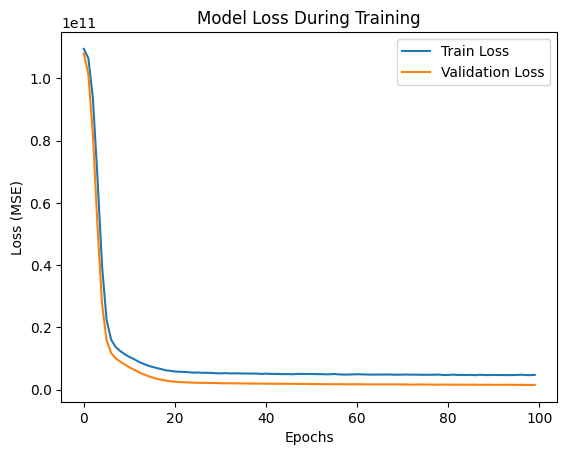

In [ ]:
import pandas as pd
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, mean_absolute_percentage_error
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras import regularizers
import matplotlib.pyplot as plt


# 1. Data Preprocessing
def preprocess_data(data):
    data = data[features + [target]]
    data = data.dropna()  # Drop any rows with missing values
    return data

# Assume data_cleaned is our input dataset
data_prepared = preprocess_data(data_final)

# Split data into features and target
X = data_prepared[features]
y = data_prepared[target]

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the feature data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# 2. Define the Model Architecture
model = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=(X_train_scaled.shape[1],)),
    tf.keras.layers.Dense(128, activation='relu', kernel_regularizer=regularizers.l2(0.01)),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(64, activation='relu', kernel_regularizer=regularizers.l2(0.01)),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(32, activation='relu', kernel_regularizer=regularizers.l2(0.01)),
    tf.keras.layers.Dropout(0.3),
    tf.keras.layers.Dense(1)  # Output layer with 1 neuron for regression
])

# 3. Compile the Model
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4), loss='mse', metrics=['mae'])

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6)

# 4. Train the Model
history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test),
                    epochs=100, batch_size=32, verbose=1, callbacks=[early_stopping, reduce_lr])

# 5. Evaluate the Model
# Predict on training and test sets
y_train_pred = model.predict(X_train_scaled)
y_test_pred = model.predict(X_test_scaled)

# Calculate performance metrics for training set
train_mse = mean_squared_error(y_train, y_train_pred)
train_r2 = r2_score(y_train, y_train_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)
train_mape = mean_absolute_percentage_error(y_train, y_train_pred)

# Calculate performance metrics for test set
test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)
test_mape = mean_absolute_percentage_error(y_test, y_test_pred)

# Display the results
print("Neural Network Model - Training Data Evaluation:")
print(f"Mean Squared Error (MSE): {train_mse}")
print(f"R² Score: {train_r2}")
print(f"Mean Absolute Error (MAE): {train_mae}")
print(f"Mean Absolute Percentage Error (MAPE): {train_mape}")

print("\nNeural Network Model - Test Data Evaluation:")
print(f"Mean Squared Error (MSE): {test_mse}")
print(f"R² Score: {test_r2}")
print(f"Mean Absolute Error (MAE): {test_mae}")
print(f"Mean Absolute Percentage Error (MAPE): {test_mape}")

# Optional: Plotting Training History
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss (MSE)')
plt.title('Model Loss During Training')
plt.legend()
plt.show()


###LSTM

In [ ]:
pip install optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 364.4/364.4 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.5/233.5 kB 17.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 6.3 MB/s eta 0:00:00


Epoch 1/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 46255869952.0000 - mae: 178255.2031 - val_loss: 6746383360.0000 - val_mae: 61853.0078 - learning_rate: 0.0010
Epoch 2/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 11750135808.0000 - mae: 84600.9922 - val_loss: 6672079872.0000 - val_mae: 60402.9453 - learning_rate: 0.0010
Epoch 3/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - loss: 10856416256.0000 - mae: 80884.5312 - val_loss: 6499407360.0000 - val_mae: 59844.3789 - learning_rate: 0.0010
Epoch 4/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 10462012416.0000 - mae: 79349.9297 - val_loss: 6529125888.0000 - val_mae: 59054.2070 - learning_rate: 0.0010
Epoch 5/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 9857190912.0000 - mae: 76757.0625 - val_loss: 6355081216.0000 - val_mae: 58430.5586 - learning_rate: 0.0010
Epoch 6/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 9768809472.0000 - mae: 76066.4531 - val_loss: 6863863296.0000 - val_mae: 59998.9102

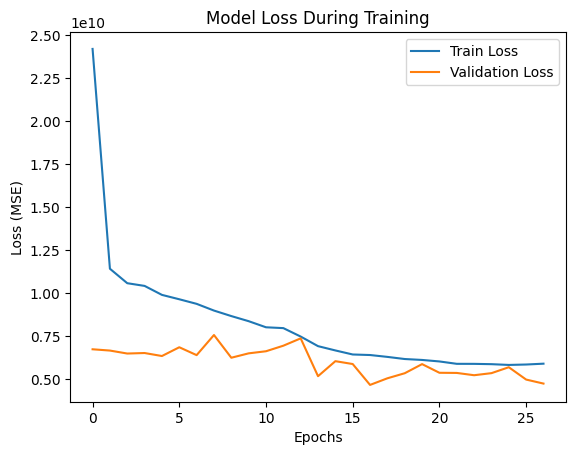

In [ ]:
import pandas as pd
import numpy as np
import optuna
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, LSTM
from tensorflow.keras.optimizers import Adam, RMSprop, Adamax
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
from tensorflow.keras.layers import LeakyReLU, PReLU

# Load the dataset and preprocess
def preprocess_data(data, features, target):
    data = data[features + [target]].dropna()
    X = data[features]
    y = data[target]
    return train_test_split(X, y, test_size=0.2, random_state=42)

# Preprocess the data
X_train, X_test, y_train, y_test = preprocess_data(data_final, features, target)

# Reshape the input data to fit LSTM requirements (samples, timesteps, features)
X_train_scaled = np.expand_dims(X_train, axis=1)
X_test_scaled = np.expand_dims(X_test, axis=1)

# 2. Define the LSTM Model Architecture
model = Sequential()
model.add(LSTM(64, activation='relu', input_shape=(X_train_scaled.shape[1], X_train_scaled.shape[2]), return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(32, activation='relu', return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(1))

# 3. Compile the Model
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = LearningRateScheduler(lambda epoch, lr: lr * np.exp(-0.1) if epoch >= 10 else lr)

# 4. Train the Model
history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test),
                    epochs=50, batch_size=32, verbose=1, callbacks=[early_stopping, reduce_lr])

# 5. Evaluate the Model
# Predict on training and test sets
y_train_pred = model.predict(X_train_scaled)
y_test_pred = model.predict(X_test_scaled)

# Calculate performance metrics
train_mse = mean_squared_error(y_train, y_train_pred)
train_r2 = r2_score(y_train, y_train_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)

test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)

# Display the results
print("LSTM Model - Training Data Evaluation:")
print(f"Mean Squared Error (MSE): {train_mse}")
print(f"R² Score: {train_r2}")
print(f"Mean Absolute Error (MAE): {train_mae}")

print("\nLSTM Model - Test Data Evaluation:")
print(f"Mean Squared Error (MSE): {test_mse}")
print(f"R² Score: {test_r2}")
print(f"Mean Absolute Error (MAE): {test_mae}")

# Optional: Plotting Training History
import matplotlib.pyplot as plt

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss (MSE)')
plt.title('Model Loss During Training')
plt.legend()
plt.show()


lstm tuning

[I 2024-11-29 03:09:10,334] A new study created in memory with name: no-name-5c953291-a923-4073-962f-8f1d6752ebfd
[I 2024-11-29 03:09:45,125] Trial 0 finished with value: 10795334656.0 and parameters: {'n_units_1': 37, 'n_units_2': 27, 'dropout_rate': 0.25946935790966974, 'learning_rate': 0.00024751010263971817, 'optimizer': 'RMSprop'}. Best is trial 0 with value: 10795334656.0.
[I 2024-11-29 03:10:25,220] Trial 1 finished with value: 7296893440.0 and parameters: {'n_units_1': 58, 'n_units_2': 32, 'dropout_rate': 0.2745950211528335, 'learning_rate': 0.0006546307048040093, 'optimizer': 'Adam'}. Best is trial 1 with value: 7296893440.0.
[I 2024-11-29 03:10:55,279] Trial 2 finished with value: 8142649344.0 and parameters: {'n_units_1': 47, 'n_units_2': 24, 'dropout_rate': 0.25116639944723484, 'learning_rate': 0.0005121207718699131, 'optimizer': 'RMSprop'}. Best is trial 1 with value: 7296893440.0.
[I 2024-11-29 03:11:35,606] Trial 3 finished with value: 7845997568.0 and parameters: {'n_un

Best Parameters for LSTM Model: {'n_units_1': 54, 'n_units_2': 28, 'dropout_rate': 0.2117193963040142, 'learning_rate': 0.00023119094104060768, 'optimizer': 'Adam'}
Epoch 1/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 95622799360.0000 - mae: 296867.7188 - val_loss: 25786071040.0000 - val_mae: 139873.4375 - learning_rate: 2.3119e-04
Epoch 2/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 26990815232.0000 - mae: 138140.9219 - val_loss: 8199343104.0000 - val_mae: 66603.3984 - learning_rate: 2.3119e-04
Epoch 3/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - loss: 16290863104.0000 - mae: 101002.1406 - val_loss: 7761190400.0000 - val_mae: 65260.0352 - learning_rate: 2.3119e-04
Epoch 4/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 15075295232.0000 - mae: 96847.3984 - val_loss: 8639534080.0000 - val_mae: 70447.2969 - learning_rate: 2.3119e-04
Epoch 5/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 14332783616.0000 - mae: 94100.2031 - val_loss: 7727907840.0000 - val

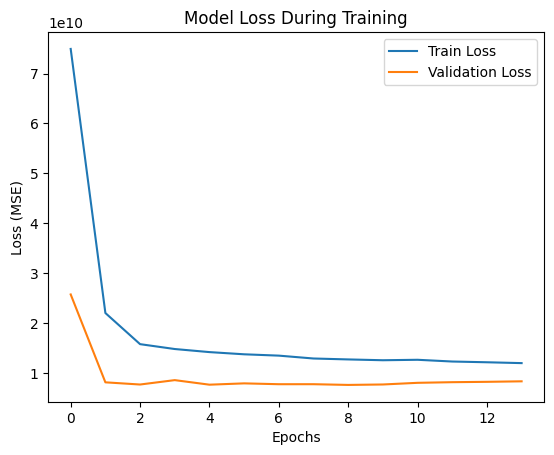

In [ ]:
import pandas as pd
import numpy as np
import optuna
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, LSTM
from tensorflow.keras.optimizers import Adam, RMSprop, Adamax
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
from tensorflow.keras.layers import LeakyReLU, PReLU

# Load the dataset and preprocess
def preprocess_data(data, features, target):
    data = data[features + [target]].dropna()
    X = data[features]
    y = data[target]
    return train_test_split(X, y, test_size=0.2, random_state=42)

# Define features and target for the model
features = ['temp', 'humidity', 'combined_renewables', 'imports']
target = 'load'

# Preprocess the data
X_train, X_test, y_train, y_test = preprocess_data(data_final, features, target)

# Reshape the input data to fit LSTM requirements (samples, timesteps, features)
X_train_scaled = np.expand_dims(X_train, axis=1)
X_test_scaled = np.expand_dims(X_test, axis=1)

# Define the objective function for Optuna
def objective(trial):
    # Hyperparameters to optimize
    n_units_1 = trial.suggest_int('n_units_1', 32, 64)
    n_units_2 = trial.suggest_int('n_units_2', 16, 32)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.3)
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-4, 1e-3)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop'])

    # Build the model
    model = Sequential()
    model.add(LSTM(n_units_1, activation='relu', input_shape=(X_train_scaled.shape[1], X_train_scaled.shape[2]), return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(n_units_2, activation='relu', return_sequences=False))
    model.add(Dropout(dropout_rate))
    model.add(Dense(1))

    # Compile the model
    optimizer = Adam(learning_rate=learning_rate) if optimizer_name == 'Adam' else RMSprop(learning_rate=learning_rate)
    model.compile(optimizer=optimizer, loss='mse', metrics=['mae'])

    # Train the model with early stopping
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    history = model.fit(X_train_scaled, y_train, validation_split=0.2, epochs=20, batch_size=32, verbose=0, callbacks=[early_stopping])

    # Evaluate the model
    val_loss = model.evaluate(X_test_scaled, y_test, verbose=0)
    return val_loss[0]

# Run Optuna to find the best hyperparameters
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=10)

# Print the best parameters
print("Best Parameters for LSTM Model:", study.best_params)

# Train the final model with the best parameters
best_params = study.best_params

final_model = Sequential()
final_model.add(LSTM(best_params['n_units_1'], activation='relu', input_shape=(X_train_scaled.shape[1], X_train_scaled.shape[2]), return_sequences=True))
final_model.add(Dropout(best_params['dropout_rate']))
final_model.add(LSTM(best_params['n_units_2'], activation='relu', return_sequences=False))
final_model.add(Dropout(best_params['dropout_rate']))
final_model.add(Dense(1))

optimizer = Adam(learning_rate=best_params['learning_rate']) if best_params['optimizer'] == 'Adam' else RMSprop(learning_rate=best_params['learning_rate'])
final_model.compile(optimizer=optimizer, loss='mse', metrics=['mae'])

# Learning rate scheduler
def scheduler(epoch, lr):
    if epoch < 5:
        return lr
    else:
        return lr * np.exp(-0.1)

lr_scheduler = LearningRateScheduler(scheduler)
# Define early stopping again before using it for the final model
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Train the final model with early stopping and learning rate scheduler
history = final_model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=50, batch_size=32, verbose=1, callbacks=[early_stopping, lr_scheduler])

# Evaluate the final model
y_train_pred = final_model.predict(X_train_scaled)
y_test_pred = final_model.predict(X_test_scaled)

train_mse = mean_squared_error(y_train, y_train_pred)
train_r2 = r2_score(y_train, y_train_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)

test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)

# Display the results
print("LSTM Model - Training Data Evaluation:")
print(f"Mean Squared Error (MSE): {train_mse}")
print(f"R² Score: {train_r2}")
print(f"Mean Absolute Error (MAE): {train_mae}")

print("\nLSTM Model - Test Data Evaluation:")
print(f"Mean Squared Error (MSE): {test_mse}")
print(f"R² Score: {test_r2}")
print(f"Mean Absolute Error (MAE): {test_mae}")

# Optional: Plotting Training History
import matplotlib.pyplot as plt

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss (MSE)')
plt.title('Model Loss During Training')
plt.legend()
plt.show()


###GRU

[I 2024-11-29 03:19:04,509] A new study created in memory with name: no-name-bbf8fad7-d456-48e9-9c74-16312ef542b5
[I 2024-11-29 03:20:02,681] Trial 0 finished with value: 6751100928.0 and parameters: {'n_units_1': 41, 'n_units_2': 20, 'dropout_rate': 0.25765702370909155, 'learning_rate': 0.00015997495558483897, 'optimizer': 'RMSprop'}. Best is trial 0 with value: 6751100928.0.
[I 2024-11-29 03:20:37,291] Trial 1 finished with value: 8763165696.0 and parameters: {'n_units_1': 36, 'n_units_2': 16, 'dropout_rate': 0.2589649773168536, 'learning_rate': 0.0002834304816306494, 'optimizer': 'Adam'}. Best is trial 0 with value: 6751100928.0.
[I 2024-11-29 03:21:14,246] Trial 2 finished with value: 6853595136.0 and parameters: {'n_units_1': 40, 'n_units_2': 25, 'dropout_rate': 0.20791903994225897, 'learning_rate': 0.0007391639421103246, 'optimizer': 'Adam'}. Best is trial 0 with value: 6751100928.0.
[I 2024-11-29 03:22:32,033] Trial 3 finished with value: 6959706624.0 and parameters: {'n_units_1

Best Parameters for GRU Model: {'n_units_1': 47, 'n_units_2': 24, 'dropout_rate': 0.13857939727486585, 'learning_rate': 0.00030091463327994346, 'optimizer': 'RMSprop'}
Epoch 1/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - loss: 70261424128.0000 - mae: 242203.4062 - val_loss: 8777832448.0000 - val_mae: 73423.0703 - learning_rate: 3.0091e-04
Epoch 2/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 13595357184.0000 - mae: 91717.2344 - val_loss: 6701931008.0000 - val_mae: 61242.0469 - learning_rate: 3.0091e-04
Epoch 3/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - loss: 11585991680.0000 - mae: 84136.4141 - val_loss: 6978921472.0000 - val_mae: 61545.4141 - learning_rate: 3.0091e-04
Epoch 4/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - loss: 11053261824.0000 - mae: 81772.8125 - val_loss: 6582159872.0000 - val_mae: 60250.2656 - learning_rate: 3.0091e-04
Epoch 5/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - loss: 10334380032.0000 - mae: 79137.3359 - val_loss: 6577452544.0000 - val_

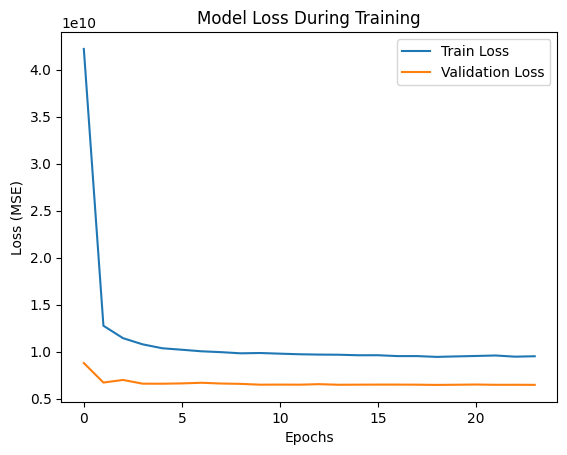

In [ ]:
import pandas as pd
import numpy as np
import optuna
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, GRU
from tensorflow.keras.optimizers import Adam, RMSprop, Adamax
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
from tensorflow.keras.layers import LeakyReLU, PReLU

# Load the dataset and preprocess
def preprocess_data(data, features, target):
    data = data[features + [target]].dropna()
    X = data[features]
    y = data[target]
    return train_test_split(X, y, test_size=0.2, random_state=42)

# Preprocess the data
X_train, X_test, y_train, y_test = preprocess_data(data_final, features, target)

# Reshape the input data to fit GRU requirements (samples, timesteps, features)
X_train_scaled = np.expand_dims(X_train, axis=1)
X_test_scaled = np.expand_dims(X_test, axis=1)

# Define the objective function for Optuna
def objective(trial):
    # Hyperparameters to optimize
    n_units_1 = trial.suggest_int('n_units_1', 32, 64)
    n_units_2 = trial.suggest_int('n_units_2', 16, 32)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.3)
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-4, 1e-3)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop'])

    # Build the model
    model = Sequential()
    model.add(GRU(n_units_1, activation='relu', input_shape=(X_train_scaled.shape[1], X_train_scaled.shape[2]), return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(GRU(n_units_2, activation='relu', return_sequences=False))
    model.add(Dropout(dropout_rate))
    model.add(Dense(1))

    # Compile the model
    optimizer = Adam(learning_rate=learning_rate) if optimizer_name == 'Adam' else RMSprop(learning_rate=learning_rate)
    model.compile(optimizer=optimizer, loss='mse', metrics=['mae'])

    # Train the model with early stopping
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    history = model.fit(X_train_scaled, y_train, validation_split=0.2, epochs=20, batch_size=32, verbose=0, callbacks=[early_stopping])

    # Evaluate the model
    val_loss = model.evaluate(X_test_scaled, y_test, verbose=0)
    return val_loss[0]

# Run Optuna to find the best hyperparameters
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=10)

# Print the best parameters
print("Best Parameters for GRU Model:", study.best_params)

# Train the final model with the best parameters
best_params = study.best_params

final_model = Sequential()
final_model.add(GRU(best_params['n_units_1'], activation='relu', input_shape=(X_train_scaled.shape[1], X_train_scaled.shape[2]), return_sequences=True))
final_model.add(Dropout(best_params['dropout_rate']))
final_model.add(GRU(best_params['n_units_2'], activation='relu', return_sequences=False))
final_model.add(Dropout(best_params['dropout_rate']))
final_model.add(Dense(1))

optimizer = Adam(learning_rate=best_params['learning_rate']) if best_params['optimizer'] == 'Adam' else RMSprop(learning_rate=best_params['learning_rate'])
final_model.compile(optimizer=optimizer, loss='mse', metrics=['mae'])

# Learning rate scheduler
def scheduler(epoch, lr):
    if epoch < 5:
        return lr
    else:
        return lr * np.exp(-0.1)

lr_scheduler = LearningRateScheduler(scheduler)
# Define early stopping again before using it for the final model
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Train the final model with early stopping and learning rate scheduler
history = final_model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=50, batch_size=32, verbose=1, callbacks=[early_stopping, lr_scheduler])

# Evaluate the final model
y_train_pred = final_model.predict(X_train_scaled)
y_test_pred = final_model.predict(X_test_scaled)

train_mse = mean_squared_error(y_train, y_train_pred)
train_r2 = r2_score(y_train, y_train_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)

test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)

# Display the results
print("GRU Model - Training Data Evaluation:")
print(f"Mean Squared Error (MSE): {train_mse}")
print(f"R² Score: {train_r2}")
print(f"Mean Absolute Error (MAE): {train_mae}")

print("\nGRU Model - Test Data Evaluation:")
print(f"Mean Squared Error (MSE): {test_mse}")
print(f"R² Score: {test_r2}")
print(f"Mean Absolute Error (MAE): {test_mae}")

# Optional: Plotting Training History
import matplotlib.pyplot as plt

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss (MSE)')
plt.title('Model Loss During Training')
plt.legend()
plt.show()


##REsearch question 2

In [ ]:
features = ['temp', 'humidity', 'windspeed', 'solarenergy', 'cloudcover', 'large hydro', 'imports','hour','month']
target = 'combined_renewables'

X = data_final[features]
y = data_final[target]

###LSTM

[I 2024-11-25 01:47:36,956] A new study created in memory with name: no-name-7456c8de-d54c-4c9e-b194-7439cb615b58
[I 2024-11-25 01:48:08,929] Trial 0 finished with value: 62380326912.0 and parameters: {'n_units_1': 60, 'n_units_2': 27, 'dropout_rate': 0.26138430859311024, 'learning_rate': 0.00023535523342374545, 'optimizer': 'Adam'}. Best is trial 0 with value: 62380326912.0.
[I 2024-11-25 01:48:36,378] Trial 1 finished with value: 66515423232.0 and parameters: {'n_units_1': 33, 'n_units_2': 25, 'dropout_rate': 0.11241419205977202, 'learning_rate': 0.00020402114421520727, 'optimizer': 'RMSprop'}. Best is trial 0 with value: 62380326912.0.
[I 2024-11-25 01:49:05,419] Trial 2 finished with value: 62125240320.0 and parameters: {'n_units_1': 35, 'n_units_2': 29, 'dropout_rate': 0.2123699400730028, 'learning_rate': 0.00042934620863035913, 'optimizer': 'RMSprop'}. Best is trial 2 with value: 62125240320.0.


Best Parameters for LSTM Model: {'n_units_1': 35, 'n_units_2': 29, 'dropout_rate': 0.2123699400730028, 'learning_rate': 0.00042934620863035913, 'optimizer': 'RMSprop'}
Epoch 1/10
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - loss: 66337193984.0000 - mae: 195093.3125 - val_loss: 66883768320.0000 - val_mae: 194953.6875 - learning_rate: 4.2935e-04
Epoch 2/10
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 67341090816.0000 - mae: 196221.4531 - val_loss: 66405273600.0000 - val_mae: 194153.4219 - learning_rate: 4.2935e-04
Epoch 3/10
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 67680100352.0000 - mae: 196287.3750 - val_loss: 65147465728.0000 - val_mae: 192046.4375 - learning_rate: 4.2935e-04
Epoch 4/10
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 65281748992.0000 - mae: 192832.5938 - val_loss: 63043006464.0000 - val_mae: 188486.4062 - learning_rate: 3.8849e-04
Epoch 5/10
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 62915682304.0000 - mae: 188646.1875 - val_loss: 6018587443

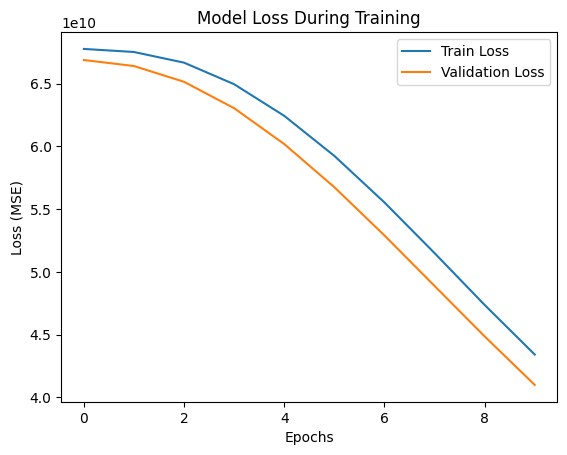

In [ ]:
import pandas as pd
import numpy as np
import optuna
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, LSTM
from tensorflow.keras.optimizers import Adam, RMSprop, Adamax
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler
from tensorflow.keras.layers import LeakyReLU, PReLU

# Load the dataset and preprocess
def preprocess_data(data, features, target):
    data = data[features + [target]].dropna()
    X = data[features]
    y = data[target]
    return train_test_split(X, y, test_size=0.2, random_state=42)


# Preprocess the data
X_train, X_test, y_train, y_test = preprocess_data(data_final, features, target)

# Scale the features for better performance
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape the input data to fit LSTM requirements (samples, timesteps, features)
X_train_scaled = np.expand_dims(X_train_scaled, axis=1)
X_test_scaled = np.expand_dims(X_test_scaled, axis=1)

# Define the objective function for Optuna
def objective(trial):
    # Hyperparameters to optimize
    n_units_1 = trial.suggest_int('n_units_1', 32, 64)
    n_units_2 = trial.suggest_int('n_units_2', 16, 32)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.3)
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-4, 1e-3)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop'])

    # Build the model
    model = Sequential()
    model.add(LSTM(n_units_1, activation='relu', input_shape=(X_train_scaled.shape[1], X_train_scaled.shape[2]), return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(n_units_2, activation='relu', return_sequences=False))
    model.add(Dropout(dropout_rate))
    model.add(Dense(1))

    # Compile the model
    optimizer = Adam(learning_rate=learning_rate) if optimizer_name == 'Adam' else RMSprop(learning_rate=learning_rate)
    model.compile(optimizer=optimizer, loss='mse', metrics=['mae'])

    # Train the model with early stopping
    early_stopping = EarlyStopping(monitor='val_loss', patience=2, restore_best_weights=True)
    history = model.fit(X_train_scaled, y_train, validation_split=0.2, epochs=5, batch_size=32, verbose=0, callbacks=[early_stopping])

    # Evaluate the model
    val_loss = model.evaluate(X_test_scaled, y_test, verbose=0)
    return val_loss[0]

# Run Optuna to find the best hyperparameters
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=3)

# Print the best parameters
print("Best Parameters for LSTM Model:", study.best_params)

# Train the final model with the best parameters
best_params = study.best_params

final_model = Sequential()
final_model.add(LSTM(best_params['n_units_1'], activation='relu', input_shape=(X_train_scaled.shape[1], X_train_scaled.shape[2]), return_sequences=True))
final_model.add(Dropout(best_params['dropout_rate']))
final_model.add(LSTM(best_params['n_units_2'], activation='relu', return_sequences=False))
final_model.add(Dropout(best_params['dropout_rate']))
final_model.add(Dense(1))

optimizer = Adam(learning_rate=best_params['learning_rate']) if best_params['optimizer'] == 'Adam' else RMSprop(learning_rate=best_params['learning_rate'])
final_model.compile(optimizer=optimizer, loss='mse', metrics=['mae'])

# Learning rate scheduler
def scheduler(epoch, lr):
    if epoch < 3:
        return lr
    else:
        return lr * np.exp(-0.1)

lr_scheduler = LearningRateScheduler(scheduler)
# Define early stopping again before using it for the final model
early_stopping = EarlyStopping(monitor='val_loss', patience=2, restore_best_weights=True)

# Train the final model with early stopping and learning rate scheduler
history = final_model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=10, batch_size=32, verbose=1, callbacks=[early_stopping, lr_scheduler])

# Evaluate the final model
y_train_pred = final_model.predict(X_train_scaled)
y_test_pred = final_model.predict(X_test_scaled)

train_mse = mean_squared_error(y_train, y_train_pred)
train_r2 = r2_score(y_train, y_train_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)

test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)

# Display the results
print("LSTM Model - Training Data Evaluation:")
print(f"Mean Squared Error (MSE): {train_mse}")
print(f"R² Score: {train_r2}")
print(f"Mean Absolute Error (MAE): {train_mae}")

print("\nLSTM Model - Test Data Evaluation:")
print(f"Mean Squared Error (MSE): {test_mse}")
print(f"R² Score: {test_r2}")
print(f"Mean Absolute Error (MAE): {test_mae}")

# Optional: Plotting Training History
import matplotlib.pyplot as plt

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss (MSE)')
plt.title('Model Loss During Training')
plt.legend()
plt.show()


##Research question 3

###DNN

[I 2024-11-25 01:56:48,871] A new study created in memory with name: no-name-4c8852e0-9aa6-4069-9cf0-f46f6f02b069
[I 2024-11-25 01:57:32,816] Trial 0 finished with value: 93026848.0 and parameters: {'n_layers': 1, 'n_units': 121, 'dropout_rate': 0.4375293290556048, 'learning_rate': 0.00012251961643374988}. Best is trial 0 with value: 93026848.0.
[I 2024-11-25 01:58:04,033] Trial 1 finished with value: 51484992.0 and parameters: {'n_layers': 2, 'n_units': 112, 'dropout_rate': 0.3667188649473412, 'learning_rate': 0.0005753648611931408}. Best is trial 1 with value: 51484992.0.
[I 2024-11-25 01:58:34,128] Trial 2 finished with value: 40538548.0 and parameters: {'n_layers': 3, 'n_units': 68, 'dropout_rate': 0.3566529994528145, 'learning_rate': 0.001466308015379051}. Best is trial 2 with value: 40538548.0.
[I 2024-11-25 01:59:17,179] Trial 3 finished with value: 74445592.0 and parameters: {'n_layers': 3, 'n_units': 29, 'dropout_rate': 0.12112657376564458, 'learning_rate': 4.461804864747022e-

Best Parameters from Optuna: {'n_layers': 2, 'n_units': 77, 'dropout_rate': 0.26571512190002555, 'learning_rate': 0.009128212741601574}
Epoch 1/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 69717920.0000 - mae: 3173.1206 - val_loss: 50981084.0000 - val_mae: 2721.0073
Epoch 2/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 49604608.0000 - mae: 2754.7744 - val_loss: 48476192.0000 - val_mae: 2791.9946
Epoch 3/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 50921344.0000 - mae: 2772.8293 - val_loss: 46612112.0000 - val_mae: 2520.7561
Epoch 4/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 45628908.0000 - mae: 2607.4214 - val_loss: 42396148.0000 - val_mae: 2519.5266
Epoch 5/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 45222904.0000 - mae: 2600.6145 - val_loss: 39747632.0000 - val_mae: 2464.3008
Epoch 6/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 41873348.0000 - mae: 2495.7788 - val_loss: 42496560.0000 - val_mae: 2299.6526
Epoch 7/50
1041/1041 ━━━

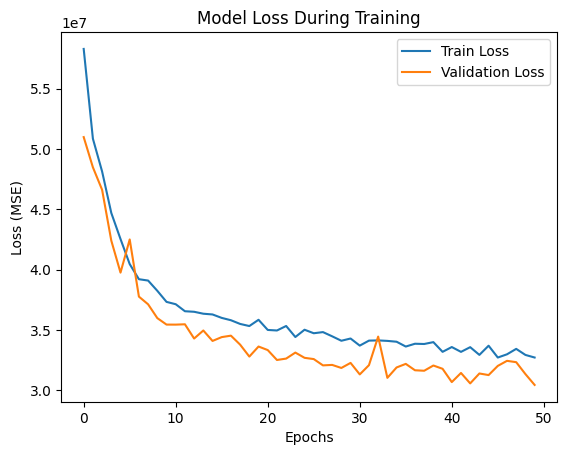

In [ ]:
import pandas as pd
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import optuna

# Load the dataset and preprocess
def preprocess_data(data, features, target):
    data = data[features + [target]].dropna()
    X = data[features]
    y = data[target]
    return train_test_split(X, y, test_size=0.2, random_state=42)

# Define features and target for the model
features = ['temp', 'humidity', 'windspeed', 'solarenergy', 'combined_renewables', 'thermal', 'large hydro', 'imports', 'load', 'nuclear']
target = 'total_curtailment'

# Preprocess the data
X_train, X_test, y_train, y_test = preprocess_data(data_final, features, target)

# Scale the features for better performance
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define the objective function for Optuna

def objective(trial):
    # Hyperparameters to optimize
    n_layers = trial.suggest_int('n_layers', 1, 3)
    n_units = trial.suggest_int('n_units', 16, 128)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.5)
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)

    # Build the DNN model
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=(X_train_scaled.shape[1],)))
    for _ in range(n_layers):
        model.add(tf.keras.layers.Dense(n_units, activation='relu'))
        model.add(tf.keras.layers.Dropout(dropout_rate))
    model.add(tf.keras.layers.Dense(1))

    # Compile the model
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate), loss='mse', metrics=['mae'])

    # Train the model
    history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=10, batch_size=32, verbose=0)

    # Evaluate the model
    val_loss = model.evaluate(X_test_scaled, y_test, verbose=0)
    return val_loss[0]

# Run Optuna to find the best hyperparameters
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=20)

# Print the best parameters
print("Best Parameters from Optuna:", study.best_params)

# Train the final model with the best parameters
best_params = study.best_params

model = tf.keras.Sequential()
model.add(tf.keras.layers.InputLayer(input_shape=(X_train_scaled.shape[1],)))
for _ in range(best_params['n_layers']):
    model.add(tf.keras.layers.Dense(best_params['n_units'], activation='relu'))
    model.add(tf.keras.layers.Dropout(best_params['dropout_rate']))
model.add(tf.keras.layers.Dense(1))

# Compile the model
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=best_params['learning_rate']), loss='mse', metrics=['mae'])

# Train the model
history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=50, batch_size=32, verbose=1)

# Predict on training and test sets
y_train_pred = model.predict(X_train_scaled)
y_test_pred = model.predict(X_test_scaled)

# Calculate performance metrics
train_mse = mean_squared_error(y_train, y_train_pred)
train_r2 = r2_score(y_train, y_train_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)

test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)

# Display the results
print("DNN Model - Training Data Evaluation:")
print(f"Mean Squared Error (MSE): {train_mse}")
print(f"R² Score: {train_r2}")
print(f"Mean Absolute Error (MAE): {train_mae}")

print("\nDNN Model - Test Data Evaluation:")
print(f"Mean Squared Error (MSE): {test_mse}")
print(f"R² Score: {test_r2}")
print(f"Mean Absolute Error (MAE): {test_mae}")

# Optional: Plotting Training History
import matplotlib.pyplot as plt

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss (MSE)')
plt.title('Model Loss During Training')
plt.legend()
plt.show()


DNN tuning

[I 2024-11-25 02:10:32,436] A new study created in memory with name: no-name-cffec5cd-033a-425e-be00-7272b1c55b40
[I 2024-11-25 02:11:04,107] Trial 0 finished with value: 38794492.0 and parameters: {'n_layers': 3, 'n_units': 50, 'dropout_rate': 0.3599257607149903, 'learning_rate': 0.0024555764447290137, 'l2_regularization': 0.00012590949345874796}. Best is trial 0 with value: 38794492.0.
[I 2024-11-25 02:11:41,216] Trial 1 finished with value: 30022380.0 and parameters: {'n_layers': 3, 'n_units': 91, 'dropout_rate': 0.15337436202505894, 'learning_rate': 0.008070714647333246, 'l2_regularization': 8.112273541991503e-05}. Best is trial 1 with value: 30022380.0.
[I 2024-11-25 02:12:12,047] Trial 2 finished with value: 57326628.0 and parameters: {'n_layers': 3, 'n_units': 49, 'dropout_rate': 0.36324373281343325, 'learning_rate': 7.710272837066785e-05, 'l2_regularization': 0.0022378326348017467}. Best is trial 1 with value: 30022380.0.
[I 2024-11-25 02:12:41,861] Trial 3 finished with value:

Best Parameters from Optuna: {'n_layers': 3, 'n_units': 91, 'dropout_rate': 0.15337436202505894, 'learning_rate': 0.008070714647333246, 'l2_regularization': 8.112273541991503e-05}
Epoch 1/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - loss: 58442644.0000 - mae: 3023.7222 - val_loss: 41592092.0000 - val_mae: 2382.2634
Epoch 2/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 42191168.0000 - mae: 2495.1086 - val_loss: 37779596.0000 - val_mae: 2393.3374
Epoch 3/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - loss: 39835284.0000 - mae: 2405.2393 - val_loss: 37239872.0000 - val_mae: 2185.3699
Epoch 4/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - loss: 37337260.0000 - mae: 2284.9375 - val_loss: 35695744.0000 - val_mae: 2165.6958
Epoch 5/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - loss: 37178004.0000 - mae: 2258.7253 - val_loss: 35526976.0000 - val_mae: 2377.4805
Epoch 6/50
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 34763444.0000 - mae: 2215.0000 - val_loss: 34375996.0000 -

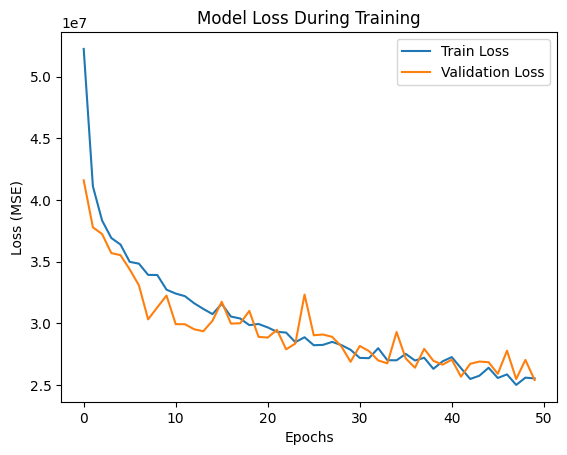

In [ ]:
import pandas as pd
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import optuna

# Load the dataset and preprocess
def preprocess_data(data, features, target):
    data = data[features + [target]].dropna()
    X = data[features]
    y = data[target]
    return train_test_split(X, y, test_size=0.2, random_state=42)

# Define features and target for the model
features = ['temp', 'humidity', 'windspeed', 'solarenergy', 'combined_renewables', 'thermal', 'large hydro', 'imports', 'load', 'nuclear']
target = 'total_curtailment'

# Preprocess the data
X_train, X_test, y_train, y_test = preprocess_data(data_final, features, target)

# Scale the features for better performance
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define the objective function for Optuna

def objective(trial):
    # Hyperparameters to optimize
    n_layers = trial.suggest_int('n_layers', 1, 3)
    n_units = trial.suggest_int('n_units', 16, 128)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.5)
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
    l2_regularization = trial.suggest_loguniform('l2_regularization', 1e-5, 1e-2)

    # Build the DNN model
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=(X_train_scaled.shape[1],)))
    for _ in range(n_layers):
        model.add(tf.keras.layers.Dense(n_units, activation='relu',
                                        kernel_regularizer=tf.keras.regularizers.l2(l2_regularization)))
        model.add(tf.keras.layers.Dropout(dropout_rate))
    model.add(tf.keras.layers.Dense(1))

    # Compile the model
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate), loss='mse', metrics=['mae'])

    # Train the model
    history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=10, batch_size=32, verbose=0)

    # Evaluate the model
    val_loss = model.evaluate(X_test_scaled, y_test, verbose=0)
    return val_loss[0]

# Run Optuna to find the best hyperparameters
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=20)

# Print the best parameters
print("Best Parameters from Optuna:", study.best_params)

# Train the final model with the best parameters
best_params = study.best_params

model = tf.keras.Sequential()
model.add(tf.keras.layers.InputLayer(input_shape=(X_train_scaled.shape[1],)))
for _ in range(best_params['n_layers']):
    model.add(tf.keras.layers.Dense(best_params['n_units'], activation='relu',
                                    kernel_regularizer=tf.keras.regularizers.l2(best_params['l2_regularization'])))
    model.add(tf.keras.layers.Dropout(best_params['dropout_rate']))
model.add(tf.keras.layers.Dense(1))

# Compile the model
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=best_params['learning_rate']), loss='mse', metrics=['mae'])

# Train the model
history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=50, batch_size=32, verbose=1)

# Predict on training and test sets
y_train_pred = model.predict(X_train_scaled)
y_test_pred = model.predict(X_test_scaled)

# Calculate performance metrics
train_mse = mean_squared_error(y_train, y_train_pred)
train_r2 = r2_score(y_train, y_train_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)

test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)

# Display the results
print("DNN Model - Training Data Evaluation:")
print(f"Mean Squared Error (MSE): {train_mse}")
print(f"R² Score: {train_r2}")
print(f"Mean Absolute Error (MAE): {train_mae}")

print("\nDNN Model - Test Data Evaluation:")
print(f"Mean Squared Error (MSE): {test_mse}")
print(f"R² Score: {test_r2}")
print(f"Mean Absolute Error (MAE): {test_mae}")

# Optional: Plotting Training History
import matplotlib.pyplot as plt

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss (MSE)')
plt.title('Model Loss During Training')
plt.legend()
plt.show()


The hyperparameters of a **Deep Neural Network (DNN)** for predicting `total_curtailment` were optimized in this code using **Optuna**. We separated the data into training and testing sets, scaled the data, and created the feature set. Optuna was used to adjust the model's parameters (learning rate, L2 regularization) and architecture (number of layers, units, dropout rate). Ultimately, the model was trained using the optimal configuration, and its performance was assessed on both training and test sets. We decreased the number of optimization trials, raised the batch size, and decreased the number of epochs in order to shorten the execution time.

###LSTM (RNN)

[I 2024-11-25 02:25:08,189] A new study created in memory with name: no-name-ba59aa9a-41b1-45e5-8d60-c18078aa201f
[I 2024-11-25 02:26:10,248] Trial 0 finished with value: 3124.16064453125 and parameters: {'n_layers': 1, 'n_units': 106, 'dropout_rate': 0.26939113099419193, 'learning_rate': 0.00038575365331753935, 'l2_regularization': 0.00012557026191470654}. Best is trial 0 with value: 3124.16064453125.
[I 2024-11-25 02:26:47,561] Trial 1 finished with value: 3146.5244140625 and parameters: {'n_layers': 1, 'n_units': 40, 'dropout_rate': 0.29597321065892335, 'learning_rate': 0.0007624967753069322, 'l2_regularization': 2.678523595068202e-05}. Best is trial 0 with value: 3124.16064453125.
[I 2024-11-25 02:27:40,486] Trial 2 finished with value: 3090.580078125 and parameters: {'n_layers': 1, 'n_units': 109, 'dropout_rate': 0.23210468577560334, 'learning_rate': 0.0005461885035535215, 'l2_regularization': 4.9974085828253704e-05}. Best is trial 2 with value: 3090.580078125.
[I 2024-11-25 02:30

Best Parameters from Optuna: {'n_layers': 3, 'n_units': 110, 'dropout_rate': 0.1479391224939367, 'learning_rate': 0.0007519508465138875, 'l2_regularization': 8.470906787360255e-05}
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step
261/261 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
LSTM Model - Training Data Evaluation:
Mean Squared Error (MSE): 92443233.52113226
R² Score: -0.01958819181173488
Mean Absolute Error (MAE): 2891.9512758053456

LSTM Model - Test Data Evaluation:
Mean Squared Error (MSE): 89403673.26946256
R² Score: -0.01835719281085879
Mean Absolute Error (MAE): 2844.820175565072


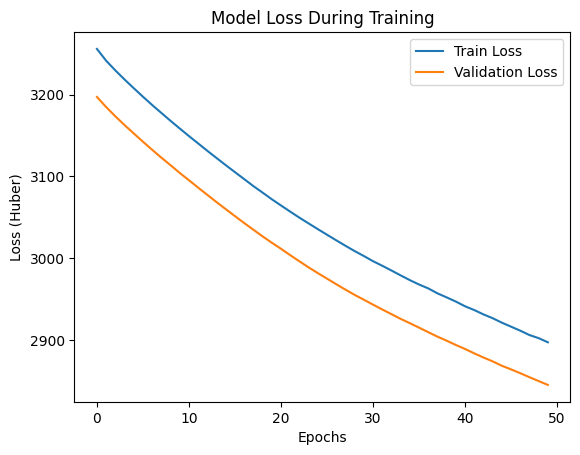

In [ ]:
import pandas as pd
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import optuna

# Load the dataset and preprocess
def preprocess_data(data, features, target):
    data = data[features + [target]].dropna()
    X = data[features]
    y = data[target]
    return train_test_split(X, y, test_size=0.2, random_state=42)

# Define features and target for the model
features = ['temp', 'humidity', 'windspeed', 'solarenergy', 'combined_renewables', 'thermal', 'large hydro', 'imports', 'load', 'nuclear']
target = 'total_curtailment'

# Preprocess the data
X_train, X_test, y_train, y_test = preprocess_data(data_final, features, target)

# Scale the features for better performance
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape data for LSTM (samples, timesteps, features)
X_train_scaled = X_train_scaled.reshape((X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_scaled = X_test_scaled.reshape((X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Define the objective function for Optuna
def objective(trial):
    # Hyperparameters to optimize
    n_layers = trial.suggest_int('n_layers', 1, 3)
    n_units = trial.suggest_int('n_units', 32, 128)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.3)
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-4, 1e-3)
    l2_regularization = trial.suggest_loguniform('l2_regularization', 1e-5, 1e-3)

    # Build the LSTM model
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=(X_train_scaled.shape[1], X_train_scaled.shape[2])))
    for _ in range(n_layers):
        model.add(tf.keras.layers.LSTM(n_units, activation='tanh', return_sequences=True if _ < n_layers - 1 else False,
                                       kernel_regularizer=tf.keras.regularizers.l2(l2_regularization)))
        model.add(tf.keras.layers.Dropout(dropout_rate))
    model.add(tf.keras.layers.Dense(1))

    # Compile the model
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate), loss=tf.keras.losses.Huber(), metrics=['mae'])

    # Train the model
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=30, batch_size=128,
                        verbose=0, callbacks=[early_stopping])

    # Evaluate the model
    val_loss = model.evaluate(X_test_scaled, y_test, verbose=0)
    return val_loss[0]

# Run Optuna to find the best hyperparameters
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=5)

# Print the best parameters
print("Best Parameters from Optuna:", study.best_params)

# Train the final model with the best parameters
best_params = study.best_params

model = tf.keras.Sequential()
model.add(tf.keras.layers.InputLayer(input_shape=(X_train_scaled.shape[1], X_train_scaled.shape[2])))
for _ in range(best_params['n_layers']):
    model.add(tf.keras.layers.LSTM(best_params['n_units'], activation='tanh', return_sequences=True if _ < best_params['n_layers'] - 1 else False,
                                   kernel_regularizer=tf.keras.regularizers.l2(best_params['l2_regularization'])))
    model.add(tf.keras.layers.Dropout(best_params['dropout_rate']))
model.add(tf.keras.layers.Dense(1))

# Compile the model
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=best_params['learning_rate']), loss=tf.keras.losses.Huber(), metrics=['mae'])

# Train the model
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=50, batch_size=64,
                    verbose=0, callbacks=[early_stopping])

# Predict on training and test sets
y_train_pred = model.predict(X_train_scaled)
y_test_pred = model.predict(X_test_scaled)

# Calculate performance metrics
train_mse = mean_squared_error(y_train, y_train_pred)
train_r2 = r2_score(y_train, y_train_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)

test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)

# Display the results
print("LSTM Model - Training Data Evaluation:")
print(f"Mean Squared Error (MSE): {train_mse}")
print(f"R² Score: {train_r2}")
print(f"Mean Absolute Error (MAE): {train_mae}")

print("\nLSTM Model - Test Data Evaluation:")
print(f"Mean Squared Error (MSE): {test_mse}")
print(f"R² Score: {test_r2}")
print(f"Mean Absolute Error (MAE): {test_mae}")

# Optional: Plotting Training History
import matplotlib.pyplot as plt

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss (Huber)')
plt.title('Model Loss During Training')
plt.legend()
plt.show()


#### **modifying the lstm model**

import pandas as pd
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import optuna

- Load the dataset and preprocess
def preprocess_data(data, features, target):
    data = data[features + [target]].dropna()
    X = data[features]
    y = data[target]
    return train_test_split(X, y, test_size=0.2, random_state=42)

- Define features and target for the model
features = ['temp', 'humidity', 'windgust', 'windspeed', 'solarradiation',
            'generation', 'combined_renewables', 'thermal', 'large hydro', 'imports', 'load',
            'hour', 'day', 'month']
target = 'total_curtailment'

- Preprocess the data
X_train, X_test, y_train, y_test = preprocess_data(data_final, features, target)

- Scale the features for better performance
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

- Reshape data for LSTM (samples, timesteps, features)
timesteps = 3
X_train_scaled = np.array([X_train_scaled[i:i+timesteps] for i in range(len(X_train_scaled) - timesteps)])
y_train = y_train.iloc[timesteps:]
X_test_scaled = np.array([X_test_scaled[i:i+timesteps] for i in range(len(X_test_scaled) - timesteps)])
y_test = y_test.iloc[timesteps:]


- Define the objective function for Optuna
def objective(trial):
    - Hyperparameters to optimize
    n_layers = trial.suggest_int('n_layers', 1, 4)
    n_units = trial.suggest_int('n_units', 32, 256)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.3)
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-4)
    l2_regularization = trial.suggest_loguniform('l2_regularization', 1e-5, 1e-3)

    - Build the LSTM model
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=(timesteps, X_train_scaled.shape[2])))
    for _ in range(n_layers):
        model.add(tf.keras.layers.LSTM(n_units, activation='tanh', return_sequences=True if _ < n_layers - 1 else False,
                                       kernel_regularizer=tf.keras.regularizers.l2(l2_regularization)))
        model.add(tf.keras.layers.Dropout(dropout_rate))
    model.add(tf.keras.layers.Dense(1))

    - Compile the model
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate), loss=tf.keras.losses.Huber(), metrics=['mae'])

    - Train the model
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=30, batch_size=128,
                        verbose=0, callbacks=[early_stopping])

    - Evaluate the model
    val_loss = model.evaluate(X_test_scaled, y_test, verbose=0)
    return val_loss[0]

- Run Optuna to find the best hyperparameters
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=5)

- Print the best parameters
print("Best Parameters from Optuna:", study.best_params)

- Train the final model with the best parameters
best_params = study.best_params

model = tf.keras.Sequential()
model.add(tf.keras.layers.InputLayer(input_shape=(X_train_scaled.shape[1], X_train_scaled.shape[2])))
for _ in range(best_params['n_layers']):
    model.add(tf.keras.layers.LSTM(best_params['n_units'], activation='tanh', return_sequences=True if _ < best_params['n_layers'] - 1 else False,
                                   kernel_regularizer=tf.keras.regularizers.l2(best_params['l2_regularization'])))
    model.add(tf.keras.layers.Dropout(best_params['dropout_rate']))
model.add(tf.keras.layers.Dense(1))

- Compile the model
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=best_params['learning_rate']), loss=tf.keras.losses.Huber(), metrics=['mae'])

- Train the model
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=50, batch_size=64,
                    verbose=0, callbacks=[early_stopping])

- Predict on training and test sets
y_train_pred = model.predict(X_train_scaled)
y_test_pred = model.predict(X_test_scaled)

- Calculate performance metrics
train_mse = mean_squared_error(y_train, y_train_pred)
train_r2 = r2_score(y_train, y_train_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)

test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)

- Display the results
print("LSTM Model - Training Data Evaluation:")
print(f"Mean Squared Error (MSE): {train_mse}")
print(f"R² Score: {train_r2}")
print(f"Mean Absolute Error (MAE): {train_mae}")

print("\nLSTM Model - Test Data Evaluation:")
print(f"Mean Squared Error (MSE): {test_mse}")
print(f"R² Score: {test_r2}")
print(f"Mean Absolute Error (MAE): {test_mae}")

- Optional: Plotting Training History
import matplotlib.pyplot as plt

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss (Huber)')
plt.title('Model Loss During Training')
plt.legend()
plt.show()


[I 2024-11-14 23:29:49,170] A new study created in memory with name: no-name-0cdb5136-a79e-4cd0-b77a-110702a867e0
[I 2024-11-14 23:35:12,421] Trial 0 finished with value: 3217.512451171875 and parameters: {'n_layers': 3, 'n_units': 223, 'dropout_rate': 0.1510081940920253, 'learning_rate': 4.606776117360498e-05, 'l2_regularization': 0.0004252054674010907}. Best is trial 0 with value: 3217.512451171875.
[I 2024-11-14 23:35:52,416] Trial 1 finished with value: 3217.362060546875 and parameters: {'n_layers': 2, 'n_units': 40, 'dropout_rate': 0.22772527029382614, 'learning_rate': 7.664828693333521e-05, 'l2_regularization': 2.6929229163762374e-05}. Best is trial 1 with value: 3217.362060546875.
[I 2024-11-14 23:36:55,238] Trial 2 finished with value: 3217.361083984375 and parameters: {'n_layers': 2, 'n_units': 40, 'dropout_rate': 0.1511835682177128, 'learning_rate': 2.5541655685858126e-05, 'l2_regularization': 2.6328439364005677e-05}. Best is trial 2 with value: 3217.361083984375.
[I 2024-11-14 23:42:40,837] Trial 3 finished with value: 3217.390380859375 and parameters: {'n_layers': 4, 'n_units': 185, 'dropout_rate': 0.23391034593697477, 'learning_rate': 3.616571378245626e-05, 'l2_regularization': 2.1017777526248944e-05}. Best is trial 2 with value: 3217.361083984375.
[I 2024-11-14 23:48:39,366] Trial 4 finished with value: 3217.383056640625 and parameters: {'n_layers': 4, 'n_units': 107, 'dropout_rate': 0.2919591617726378, 'learning_rate': 1.0359522415738023e-05, 'l2_regularization': 1.314716972709195e-05}. Best is trial 2 with value: 3217.361083984375.
Best Parameters from Optuna: {'n_layers': 2, 'n_units': 40, 'dropout_rate': 0.1511835682177128, 'learning_rate': 2.5541655685858126e-05, 'l2_regularization': 2.6328439364005677e-05}
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step
261/261 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
LSTM Model - Training Data Evaluation:
Mean Squared Error (MSE): 101302734.33437485
R² Score: -0.11720952020775166
Mean Absolute Error (MAE): 3267.5433504839416

LSTM Model - Test Data Evaluation:
Mean Squared Error (MSE): 98125776.27165964
R² Score: -0.1173515361118389
Mean Absolute Error (MAE): 3217.8622661682534
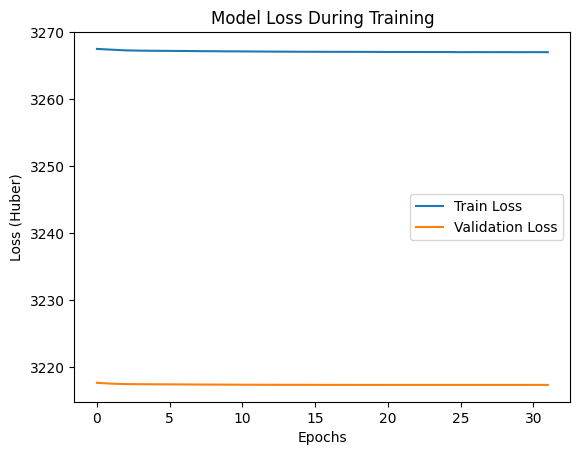

###GRU

import pandas as pd
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import optuna

-  Load the dataset and preprocess
def preprocess_data(data, features, target):
    data = data[features + [target]].dropna()
    X = data[features]
    y = data[target]
    return train_test_split(X, y, test_size=0.2, random_state=42)

- Define features and target for the model
features = ['temp', 'humidity', 'windgust', 'windspeed', 'solarradiation',
            'generation', 'combined_renewables', 'thermal', 'large hydro', 'imports', 'load',
            'hour', 'day', 'month']
target = 'total_curtailment'

-  Preprocess the data
X_train, X_test, y_train, y_test = preprocess_data(data_final, features, target)

-  Scale the features for better performance
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

- Reshape data for LSTM (samples, timesteps, features)
timesteps = 3
X_train_scaled = np.array([X_train_scaled[i:i+timesteps] for i in range(len(X_train_scaled) - timesteps)])
y_train = y_train.iloc[timesteps:]
X_test_scaled = np.array([X_test_scaled[i:i+timesteps] for i in range(len(X_test_scaled) - timesteps)])
y_test = y_test.iloc[timesteps:]


- Define the objective function for Optuna
def objective(trial):
    - Hyperparameters to optimize
    n_layers = trial.suggest_int('n_layers', 1, 4)
    n_units = trial.suggest_int('n_units', 32, 256)
    dropout_rate = trial.suggest_uniform('dropout_rate', 0.1, 0.3)
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-4)
    l2_regularization = trial.suggest_loguniform('l2_regularization', 1e-5, 1e-3)

    -  Build the LSTM model
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=(timesteps, X_train_scaled.shape[2])))
    for _ in range(n_layers):
        model.add(tf.keras.layers.GRU(n_units, activation='tanh', return_sequences=True if _ < n_layers - 1 else False,
                                       kernel_regularizer=tf.keras.regularizers.l2(l2_regularization)))
        model.add(tf.keras.layers.Dropout(dropout_rate))
    model.add(tf.keras.layers.Dense(1))

    -  Compile the model
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate), loss=tf.keras.losses.Huber(), metrics=['mae'])

    -  Train the model
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
    history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=20, batch_size=256,
                        verbose=0, callbacks=[early_stopping])

    -  Evaluate the model
    val_loss = model.evaluate(X_test_scaled, y_test, verbose=0)
    return val_loss[0]

-  Run Optuna to find the best hyperparameters
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=3)

-  Print the best parameters
print("Best Parameters from Optuna:", study.best_params)

-  Train the final model with the best parameters
best_params = study.best_params

model = tf.keras.Sequential()
model.add(tf.keras.layers.InputLayer(input_shape=(X_train_scaled.shape[1], X_train_scaled.shape[2])))
for _ in range(best_params['n_layers']):
    model.add(tf.keras.layers.GRU(best_params['n_units'], activation='tanh', return_sequences=True if _ < best_params['n_layers'] - 1 else False,
                                   kernel_regularizer=tf.keras.regularizers.l2(best_params['l2_regularization'])))
    model.add(tf.keras.layers.Dropout(best_params['dropout_rate']))
model.add(tf.keras.layers.Dense(1))

-  Compile the model
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=best_params['learning_rate']), loss=tf.keras.losses.Huber(), metrics=['mae'])

-  Train the model
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=30, batch_size=128,
                    verbose=0, callbacks=[early_stopping])

-  Predict on training and test sets
y_train_pred = model.predict(X_train_scaled)
y_test_pred = model.predict(X_test_scaled)

-  Calculate performance metrics
train_mse = mean_squared_error(y_train, y_train_pred)
train_r2 = r2_score(y_train, y_train_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)

test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)

-  Display the results
print("GRU Model - Training Data Evaluation:")
print(f"Mean Squared Error (MSE): {train_mse}")
print(f"R² Score: {train_r2}")
print(f"Mean Absolute Error (MAE): {train_mae}")

print("GRU Model - Test Data Evaluation:")
print(f"Mean Squared Error (MSE): {test_mse}")
print(f"R² Score: {test_r2}")
print(f"Mean Absolute Error (MAE): {test_mae}")

-  Optional: Plotting Training History
import matplotlib.pyplot as plt

plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss (Huber)')
plt.title('Model Loss During Training')
plt.legend()
plt.show()

      

[I 2024-11-15 00:12:06,662] A new study created in memory with name: no-name-58d8701e-c625-447f-9d16-f799a71f1207
[I 2024-11-15 00:13:02,749] Trial 0 finished with value: 3217.36083984375 and parameters: {'n_layers': 3, 'n_units': 42, 'dropout_rate': 0.2868881213118796, 'learning_rate': 5.3508331209875054e-05, 'l2_regularization': 1.8145133439670277e-05}. Best is trial 0 with value: 3217.36083984375.
[I 2024-11-15 00:15:14,668] Trial 1 finished with value: 3217.415283203125 and parameters: {'n_layers': 3, 'n_units': 75, 'dropout_rate': 0.200010555649276, 'learning_rate': 1.4985399364320757e-05, 'l2_regularization': 0.0002456788476651504}. Best is trial 0 with value: 3217.36083984375.
[I 2024-11-15 00:16:15,902] Trial 2 finished with value: 3217.44287109375 and parameters: {'n_layers': 3, 'n_units': 83, 'dropout_rate': 0.2028553311866575, 'learning_rate': 7.503972895151877e-05, 'l2_regularization': 0.00047392752145377737}. Best is trial 0 with value: 3217.36083984375.
Best Parameters from Optuna: {'n_layers': 3, 'n_units': 42, 'dropout_rate': 0.2868881213118796, 'learning_rate': 5.3508331209875054e-05, 'l2_regularization': 1.8145133439670277e-05}
1041/1041 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step
261/261 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
GRU Model - Training Data Evaluation:
Mean Squared Error (MSE): 101300269.38639392
R² Score: -0.11718233571594894
Mean Absolute Error (MAE): 3267.5401377412263
GRU Model - Test Data Evaluation:
Mean Squared Error (MSE): 98123203.2243036
R² Score: -0.11732223699671351
Mean Absolute Error (MAE): 3217.8564283418873
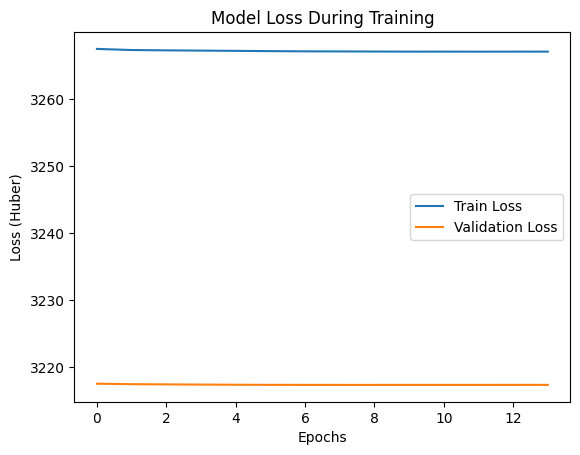